In [1]:
import numpy as np
import pandas as pd
import os 
import seaborn as sns
import re as re
import ast as ast

import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable
from scipy.signal import argrelextrema, correlate
from scipy import spatial
from scipy.ndimage import median_filter
from math import atan2
from scipy import interpolate 

#For making videos from images
import cv2
import glob

from PIL import Image

import importlib as il

#Home made modules
#import Rolling_window_projection_along_neurite_u as projection

#Color palette for plotting
sns.set_palette('tab20')
current_palette = sns.color_palette()
colors = current_palette.as_hex()

In [2]:
folder = r"F:\PERSONAL\Malina\NanoscopeII\mP_LastRound\Analysis"
os.listdir(folder)

#get stage info
with open(r"F:\PERSONAL\Malina\NanoscopeII\mP_LastRound\ClassificationOfNeuronDataByStage_NewRound_MKI.txt", "r") as data:
    #Load stages dictionary 
    stages_dict = ast.literal_eval(data.read())

In [3]:
def get_soma_coords(datadir=None):
    #Open logfile to soma coordinates
    with open(datadir+'\\'+'logfile.log', 'r') as f:

        lines = f.readlines() # list containing lines of file
        for line in lines: 
            line = line.strip()
            if bool(re.match(r'INFO:root:Soma Coordinates (\[\([\d.,\s]+\)\])', str(line))):
                soma_coords = re.search(r'INFO:root:Soma Coordinates (\[\([\d.,\s]+\)\])', str(line)).group(1) # remove leading/trailing white spaces
                soma_coords = ast.literal_eval(soma_coords)
                print(soma_coords)
    return soma_coords 

def rotate(p, origin=(0, 0), degrees=0, rad=None):
    "Rotates points p (in an array) around the origin"
    if rad != None: 
        angle = rad
    else: 
        angle = np.deg2rad(degrees)
    R = np.array([[np.cos(angle), -np.sin(angle)],
                  [np.sin(angle), np.cos(angle)]])
    o = np.atleast_2d(origin)
    p = np.atleast_2d(p)
    return np.squeeze((R @ (p.T-o.T) + o.T).T)

def scan_neurites(neuron_mdf=None, soma_coords=None, median_filt_window=6000,\
                  window_size=3000, pixelsize=65, angle_filtering_applied=True):

    neuron_mdf_n = pd.DataFrame()
    m = 0 #index for concatenating dataframes
    
    for i in range(1, neuron_mdf.Neurite_label.max()+1):
        print(f'Neurite {i}/{neuron_mdf.Neurite_label.max()+1}')

        df = neuron_mdf[neuron_mdf.Neurite_label==i]
        df = df.copy()
        pts = df[['X_(px)', 'Y_(px)']].to_numpy()

        # two points which are furthest apart will occur as vertices of the convex hull
        candidates = pts[spatial.ConvexHull(pts).vertices]

        # get distances between each pair of candidate points
        dist_mat = spatial.distance_matrix(candidates, candidates)

        # get indices of candidates that are furthest apart
        i, j = np.unravel_index(dist_mat.argmax(), dist_mat.shape)

        #Calculate change in x and y to be able to calculate angle 
        dx = candidates[j][0] - candidates[i][0]
        dy = candidates[j][1] - candidates[i][1]

        #Calculate the angle between the furthest points
        theta = atan2(dy, dx)
        
        #Determine which point is closest to the soma coords and set this as the origin to rotate around it
        if np.linalg.norm(np.array(soma_coords[0])-candidates[i]) > np.linalg.norm(np.array(soma_coords[0])-candidates[j]): 
            origin = candidates[j] 
        else: 
            origin = candidates[i]
        
        fig1, ax = plt.subplots(figsize=(6, 4))
           
        ax.plot(df['X_(px)'], df['Y_(px)'], 'o', ms=0.1)
        ax.plot(origin[0], origin[1], 'o', color='red')
        plt.show()
        #Rotate the whole neurite around one of the extrema 
        df[['X_new', 'Y_new']] = rotate(p=df[['X_(px)','Y_(px)']], origin=origin, degrees=0, rad = -theta)
        soma_coords_rot = rotate(p=soma_coords, origin=origin, degrees=0, rad = -theta)
        
        #Median filter Y 
        df = df.sort_values(['X_new'])
        df['Y_medianfilt'] = median_filter(df['Y_new'], median_filt_window, mode='reflect')

        #Check the rotation 
        p_ind  = int(median_filt_window*1.5)
        if len(df['Y_medianfilt']) < 3*median_filt_window:
            p_ind = int(median_filt_window*0.6) 
            if len(df['Y_medianfilt']) < median_filt_window:
                p_ind = int(median_filt_window*0.2)
                if p_ind>len(df['Y_medianfilt']):
                    p_ind = int(len(df['Y_medianfilt'])*0.2)
                    
        dy = df['Y_medianfilt'].iloc[len(df['Y_medianfilt'])-p_ind] - df['Y_medianfilt'].iloc[p_ind] 
        dx = df['X_new'].iloc[len(df['Y_medianfilt'])-p_ind] - df['X_new'].iloc[p_ind]   
        theta2 = atan2(dy, dx)

        angle = np.rad2deg(theta2)
        print('ANGLE')
        print(angle)
        if 10.0 < abs(angle) < 90: 

            df[['X_new', 'Y_new']] = rotate(p=df[['X_new','Y_new']],\
                                            origin=df[['Y_medianfilt', 'X_new']].iloc[p_ind],\
                                            degrees=0, rad= -theta2)
            soma_coords_rot = rotate(p=soma_coords_rot, origin=origin, degrees=0, rad= -theta2)
            #Redo Median filter Y 
            df = df.sort_values(['X_new'])
            df['Y_medianfilt'] = median_filter(df['Y_new'], median_filt_window, mode='reflect')
        fig1, ax = plt.subplots(figsize=(6, 4))
        ax.plot(df['X_new'], df['Y_new'], 'o', color='g', ms=0.1 )
        plt.show()
        
        #Fit spline to median filtered data 
        #Specify weights, at the edges the weight is set lower
        weights = np.full(len(df['Y_medianfilt']), 1., dtype = float)
        weights[0:median_filt_window*2] = 0.5
        weights[len(weights)-median_filt_window*2:len(weights)] = 0.5

        #Smoothing factor - the higher, the smoother. 
        #If s = 0 all data points will be fitted
        s_value = len(weights)*4

        #x points at which to evaluate the spline
        xs = np.linspace(df['X_new'].min(), df['X_new'].max(), 5000)

        tck = interpolate.splrep(df['X_new'], df['Y_medianfilt'], s=s_value, w=weights, k=3)

        yspline = interpolate.splev(xs, tck, der=0)
        
        # Define some points from min to max x-value:
        points = np.array([xs,yspline]).T 

        #if the first point of the spline is further from the soma coords (also rotated), start at other side
        if np.linalg.norm(soma_coords_rot-points[0]) > np.linalg.norm(soma_coords_rot-points[-1]):
            # if the first point on the spline is further away from the soma than the last 
            #reverse points such that window scanning starts from soma. Note that the origin for rotation is closest to the soma in OG coords
            points = points[::-1]
            print('REVERSE')
        # Linear length along the spline:
        distance = np.cumsum(np.sqrt(np.sum(np.diff(points, axis=0)**2, axis=1 )))*pixelsize # in nm 

        #Makes the points and distance arrays equal in length 
        distance = np.insert(distance, 0, 0)
        
        n_windows = int(distance.max()/window_size) #without overlap 
        x = 0 #reset counter

        letters = ['P_x', 'P_y', 'Q_x', 'Q_y', 'A_x', 'A_y', 'B_x', 'B_y']
        for l in letters:
                df[f'{l}'] = np.nan
        df['spline_distance_start'] = np.nan
        df['spline_distance_end'] = np.nan
        df['Window_number'] = np.nan

        #Do a window scan to determine directionality 
        #Overlapping windows alternating between two 'rounds' 
        primary_round = True
        for n in range(0, (n_windows*2)+1): #
            print('Window number', n)
            if primary_round: 
                index_start = np.absolute(distance-x).argmin()
                index_end = np.absolute(distance-(x+window_size)).argmin()
                
                # find the index of minimum element from the array
                primary_round = False
            else: 
                index_start = np.absolute(distance-(x+window_size/2)).argmin()
                index_end = np.absolute(distance-(x+window_size*1.5)).argmin()
                
                primary_round = True

            A = points[index_start]
            B = points[index_end]
            delta = np.array(A) - np.array(B) # should be windowsize

            dist = np.linalg.norm(delta)
            if dist < 10: 
                break

            width  = (window_size + 2000) / pixelsize 
            rect_x = 0.5 * width * delta[0] / dist
            rect_y = 0.5 * width * delta[1] / dist

            #calculate corner points of the window
            r1 = (A[0] - rect_y, A[1] + rect_x)
            r2 = (A[0] + rect_y, A[1] - rect_x)
            r3 = (B[0] - rect_y, B[1] + rect_x)
            r4 = (B[0] + rect_y, B[1] - rect_x)


            #Line to project is the midline bordered by P and Q
            #B is always further along than A, so r1 and r2 form the start boundary and r3 and r4 the end boundary of the window
            P = ((r1[0] + r3[0]) / 2, (r1[1] + r3[1]) / 2)
            Q = ((r2[0] + r4[0]) / 2, (r2[1] + r4[1]) / 2)

            #select all the points within the window
            slope_r12, intercept_r12 = np.polyfit([r1[0],r2[0]], [r1[1],r2[1]], 1)
            slope_r13, intercept_r13 = np.polyfit([r1[0],r3[0]], [r1[1],r3[1]], 1)
            slope_r34, intercept_r34 = np.polyfit([r3[0],r4[0]], [r3[1],r4[1]], 1)
            slope_r24, intercept_r24 = np.polyfit([r2[0],r4[0]], [r2[1],r4[1]], 1)

            if A[1] < B[1]:
                condition = (df['Y_new'] > (slope_r12 * df['X_new'] + intercept_r12)) & \
                    (df['Y_new'] < (slope_r34 * df['X_new'] + intercept_r34))
            else:
                condition = (df['Y_new'] < (slope_r12 * df['X_new'] + intercept_r12)) & \
                    (df['Y_new'] > (slope_r34 * df['X_new'] + intercept_r34))

            if A[0] > B[0]:
                condition = condition & (df['Y_new'] > (slope_r24 * df['X_new'] + intercept_r24)) &\
                    (df['Y_new'] < (slope_r13 * df['X_new'] + intercept_r13))
            else:
                condition = condition & (df['Y_new'] < (slope_r24 * df['X_new'] + intercept_r24)) &\
                    (df['Y_new'] > (slope_r13 * df['X_new'] + intercept_r13))

             #Select only those tracks that are with their full length in the window
            if n == 0: 
                df['full_length_track'] = df.groupby('Track_ID')['Frame_Number'].transform('count') 

            df['length_cond'] = df.loc[condition].groupby('Track_ID')['Frame_Number'].transform('count')

            condition2 = np.where(df['full_length_track']==df['length_cond'], True, False)

            #Save window coordinates for gathering statistics later 
            #Note as points can occur in sequential windows this way of storing info overwrites previous
            print('A and B: ')
            print(A[0], A[1],  B[0], B[1])
            values = [P[0], P[1], Q[0], Q[1], A[0], A[1], B[0], B[1]]
            for l, v in zip(letters, values):
                df[f'{l}'] = np.where(condition &condition2, v, df[f'{l}'])
                
            df['spline_distance_start'] = np.where(condition&condition2, distance[index_start], df['spline_distance_start'])
            df['spline_distance_end'] = np.where(condition&condition2, distance[index_end], df['spline_distance_end'])
            df['Window_number'] = np.where(condition&condition2, n, df['Window_number'])

            fig1, ax = plt.subplots(figsize=(6, 4))
            ax.plot(xs, interpolate.BSpline(*tck)(xs), '-')
            ax.plot(df['X_new'], df['Y_medianfilt'], 'ko', ms=0.8)
            points_x=[r1[0], r2[0], r4[0], r3[0], r1[0], A[0], B[0]]
            points_y=[r1[1], r2[1], r4[1], r3[1], r1[1], A[1], B[1]]
            #Plot bounding window
            ax.plot(points_x, points_y, color='black')
            
            ax.scatter(A[0], A[1], color = 'red', label = "A", s= 50)
            ax.plot([P[0],Q[0]], [P[1],Q[1]], color='firebrick', label='projectionline' )
            ax.plot([A[0],B[0]], [A[1],B[1]], label='Line along median points')
            ax.plot(df['X_new'][condition], df['Y_new'][condition], 'o', color='slateblue', markersize=5)
            ax.plot(df['X_new'], df['Y_new'], 'o', ms=0.1 ) 
            plt.show()

            df  = df.sort_values(by=['Track_ID', 'Frame_Number'])

            if primary_round: 
                # update window location
                x = x + window_size

         #length of line
        df[f'median_length'] = np.sqrt((df.B_x-df.A_x)**2 + (df.B_y-df.A_y)**2)

        #Project localisations on the midline
        df[f'projection_median'] = ((df['X_new']-df.A_x) * (df.B_x-df.A_x) + \
                    (df['Y_new']-df.A_y) * (df.B_y-df.A_y)) / df[f'median_length']
        if df.index.name != 'Track_ID':
            df = df.set_index('Track_ID')
        df['PLUS_IN_w'] = np.nan
        df['PLUS_IN_w'] = abs(df.groupby('Track_ID')['projection_median'].nth(-1)) < abs(df.groupby('Track_ID')['projection_median'].nth(0))
        df.reset_index(inplace=True)

        df.index = df.index + m +2
        m = neuron_mdf_n.index.max()
        neuron_mdf_n = pd.concat([df, neuron_mdf_n])

    print("ALL DONE")   
    return neuron_mdf_n

def save_splitted_df_to_csv(neuron_mdf_n=None, og_cols=None):
    if og_cols == None: 
        og_cols= [' ', 'X_(px)', 'Y_(px)', 'Frame_Number', 'X_(nm)', 'X_loc_error(nm)', 'Y_(nm)', 'Y_loc_error(nm)', 'Z_(nm)', 'Z_loc_error(nm)', 'Amplitude_fit', 'Amp_error', 'BGfit', 'BGfit_error', 'SD_X_(nm)', 'SD_X_error(nm)', 'SD_Y_(nm)', 'SD_Y_error(nm)', 'False_positive', 'IntegratedInt', 'SNR', 'R2_fit', 'Iterations_fit', 'Track_ID', 'Particle_ID', 'Track_Length']

    neuron_mdf_n = neuron_mdf_n.assign(trackID_frame = neuron_mdf_n.Track_ID.astype(str) + '_' + \
      neuron_mdf_n.Frame_Number.astype(str))
    #Remove duplicate localisations
    neuron_mdf_n = neuron_mdf_n.drop_duplicates('trackID_frame', keep='last')

    Results_PLUSIN = neuron_mdf_n[(neuron_mdf_n['PLUS_IN_w'] == True)]
    number_of_localisations_IN = len(Results_PLUSIN.index.unique())
    print('number of localisations toward soma', round(number_of_localisations_IN, 2))

    Results_PLUSOUT = neuron_mdf_n[(neuron_mdf_n['PLUS_IN_w'] == False)]
    number_of_localisations_OUT = len(Results_PLUSOUT.index.unique())
    print('number of localisations away from soma', round(number_of_localisations_OUT, 2))

    plusin_overtotal = round(number_of_localisations_IN / (number_of_localisations_OUT+number_of_localisations_IN), 2)

    print(f'Ratio in over total {plusin_overtotal}')

    table_list = [Results_PLUSIN,Results_PLUSOUT]
    save_name = ['Results_PLUSIN_w','Results_PLUSOUT_w']

    save_tables = True
    if save_tables:

        for i, table in enumerate(table_list):
            #Delete the columns
            for table_col in list(table.columns):
                if table_col not in og_cols:
                    del table[f'{table_col}']

            #Set order of cols as in DoM Results table
            table = table[og_cols]

            #Save as CSV in current working directory
            print(fr'{save_name[i]}.csv')
            table.to_csv(path_or_buf = datadir + '\\' + fr'{save_name[i]}.csv', index=False)


In [4]:
def find_stage(entry, data_dict):
    for stage, entries_list in data_dict.items():
        if entry in entries_list:
            return stage
    return None  # Entry not found in any stage

S01_C01_R01
F:\PERSONAL\Malina\NanoscopeII\mP_LastRound\Analysis\2024-04-09_Motor_PAINT_Neurons_DIV1_Analysis\S01_C01_R01
[(584.1990630541155, 573.9729416408542)]
Warning. No corresponding stage found for 'F:\PERSONAL\Malina\NanoscopeII\mP_LastRound\Analysis\2024-04-09_Motor_PAINT_Neurons_DIV1_Analysis\S01_C01_R01_1_S01_C01'. Proceeding anyways.
Neurite 1/8


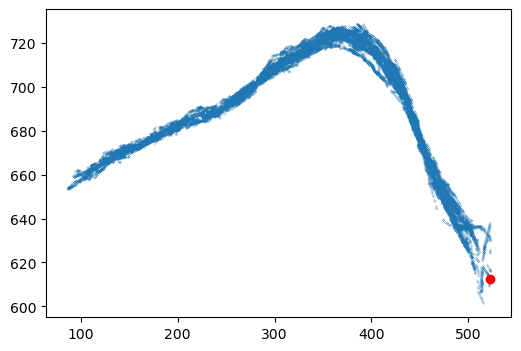

ANGLE
0.7540802564022161


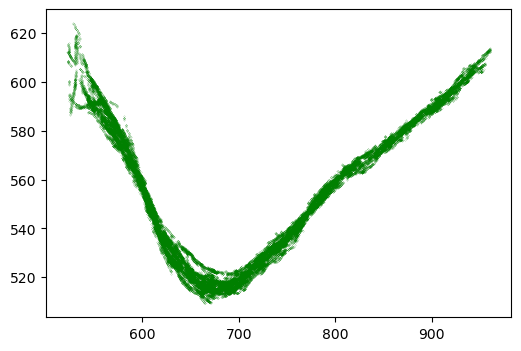

Window number 0
A and B: 
522.48 596.7763839778808 564.8293171664766 586.1077841238916


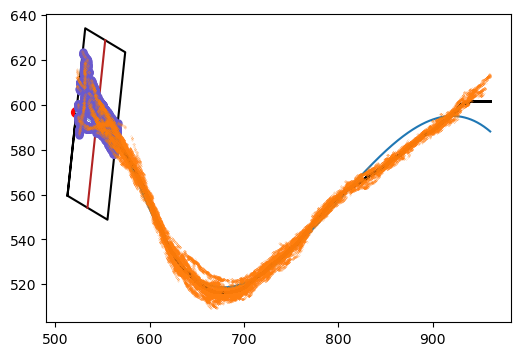

Window number 1
A and B: 
544.9260148956895 597.574052556622 582.1899068123613 570.8235947874289


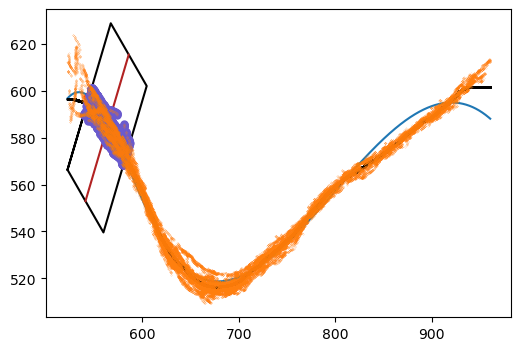

Window number 2
A and B: 
564.8293171664766 586.1077841238916 598.7613787470696 554.824509294718


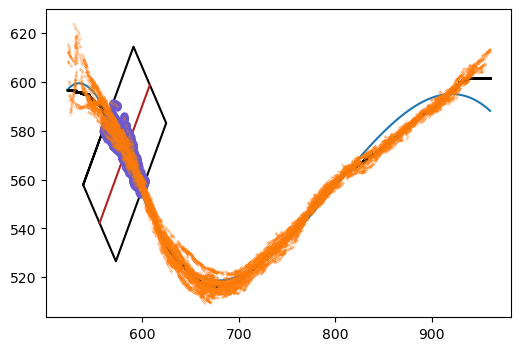

Window number 3
A and B: 
582.1899068123613 570.8235947874289 616.2096481386407 539.6967156295166


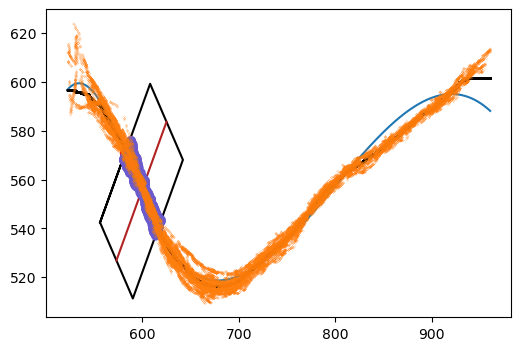

Window number 4
A and B: 
598.7613787470696 554.824509294718 635.9375909180552 527.7455150685114


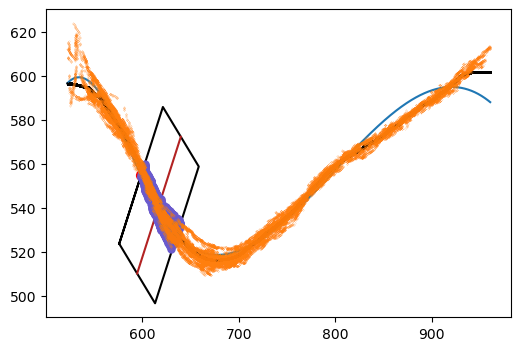

Window number 5
A and B: 
616.2096481386407 539.6967156295166 657.7698475939405 520.6115178877122


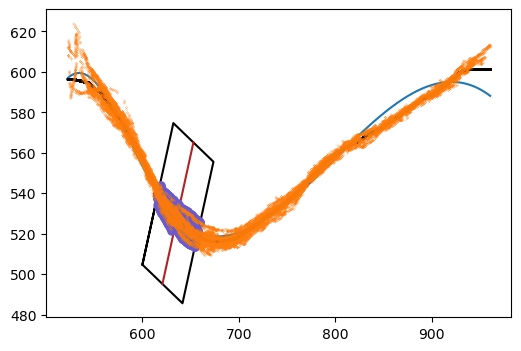

Window number 6
A and B: 
635.9375909180552 527.7455150685114 680.7419409637478 518.7006382116502


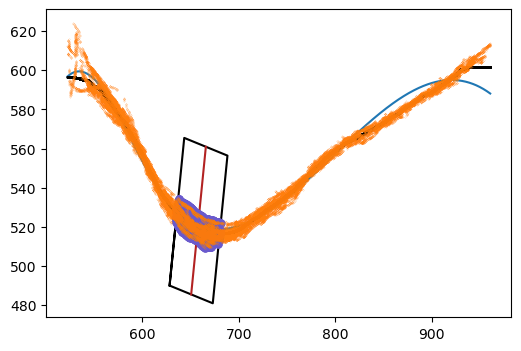

Window number 7
A and B: 
657.7698475939405 520.6115178877122 703.6263545878686 521.1080665283827


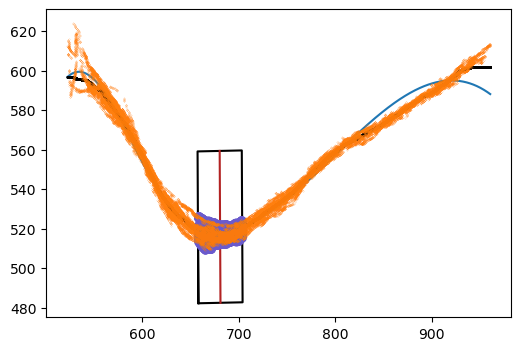

Window number 8
A and B: 
680.7419409637478 518.7006382116502 726.0723694835581 526.5800723644281


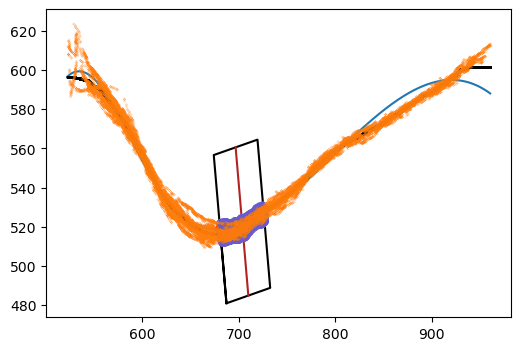

Window number 9
A and B: 
703.6263545878686 521.1080665283827 747.9046261594435 534.154550839967


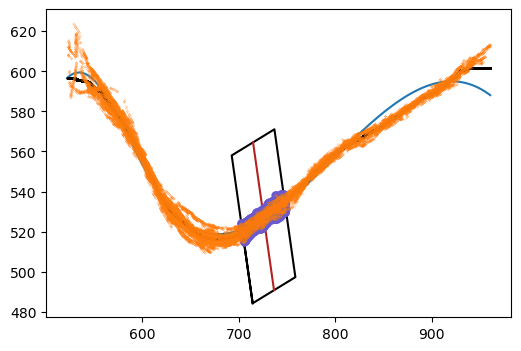

Window number 10
A and B: 
726.0723694835581 526.5800723644281 769.1231246155248 543.0095164171718


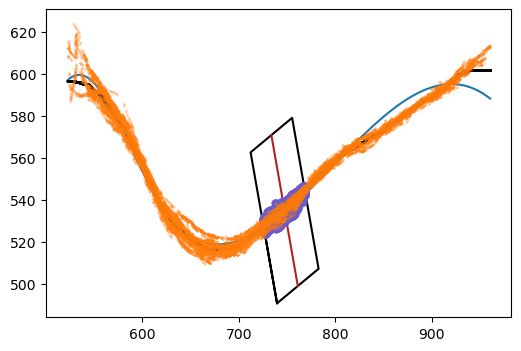

Window number 11
A and B: 
747.9046261594435 534.154550839967 790.1662635802337 552.6405695104065


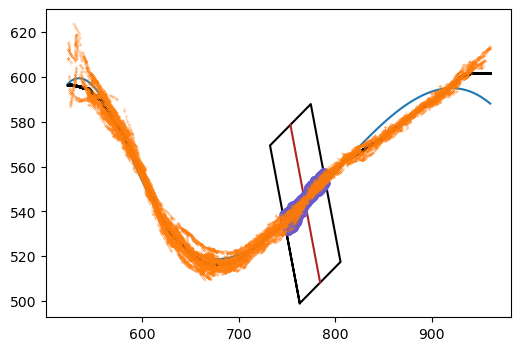

Window number 12
A and B: 
769.1231246155248 543.0095164171718 811.03404305357 562.4408650213842


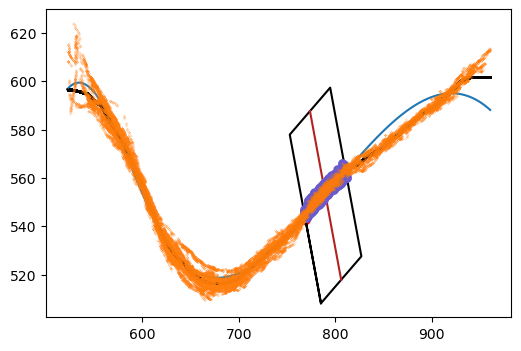

Window number 13
A and B: 
790.1662635802337 552.6405695104065 832.0771820182788 571.9861310878048


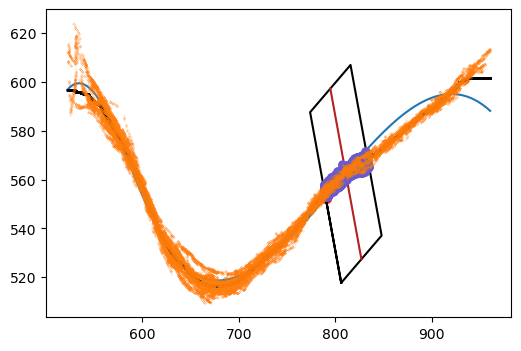

Window number 14
A and B: 
811.03404305357 562.4408650213842 853.3833602200466 580.7004368862354


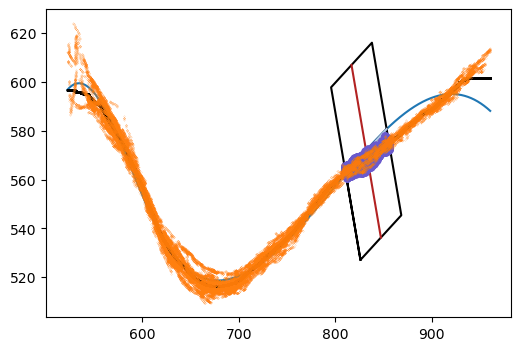

Window number 15
A and B: 
832.0771820182788 571.9861310878048 875.3032966416183 588.0218845038734


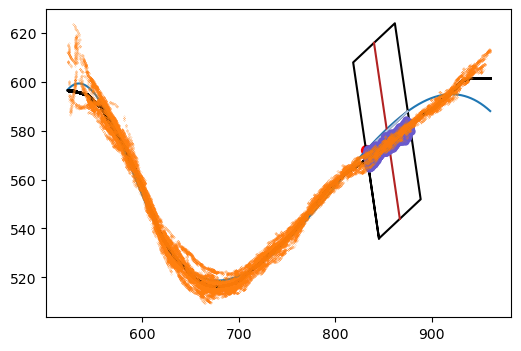

Window number 16
A and B: 
853.3833602200466 580.7004368862354 897.7493115373077 593.0975544904813


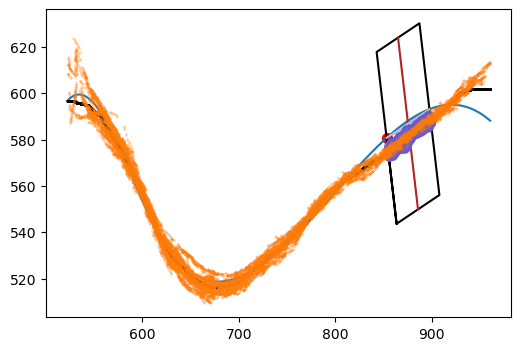

Window number 17
A and B: 
875.3032966416183 588.0218845038734 920.7214049071149 595.009866560311


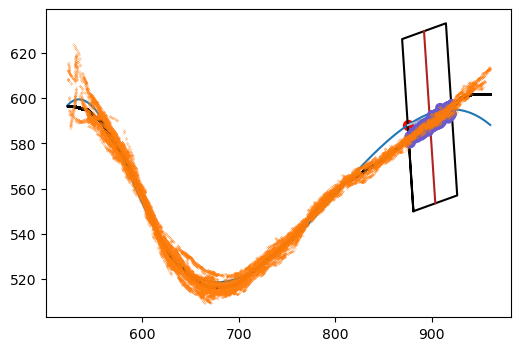

Window number 18
A and B: 
897.7493115373077 593.0975544904813 943.6934982769219 592.8361273397445


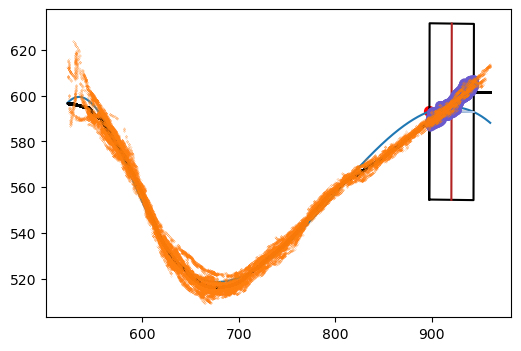

Window number 19
A and B: 
920.7214049071149 595.009866560311 960.7910486857479 588.1078100720234


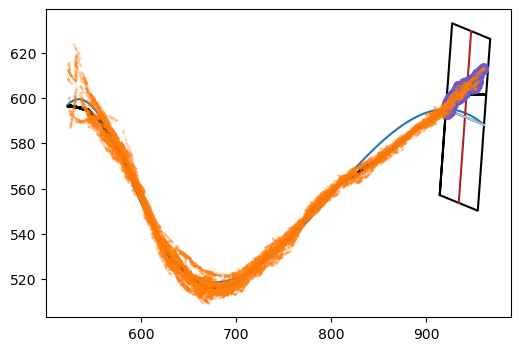

Window number 20
A and B: 
943.6934982769219 592.8361273397445 960.7910486857479 588.1078100720234


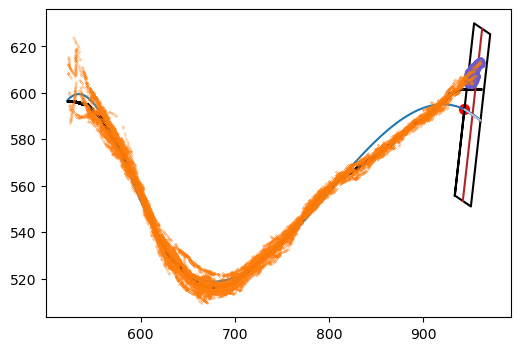

Neurite 2/8


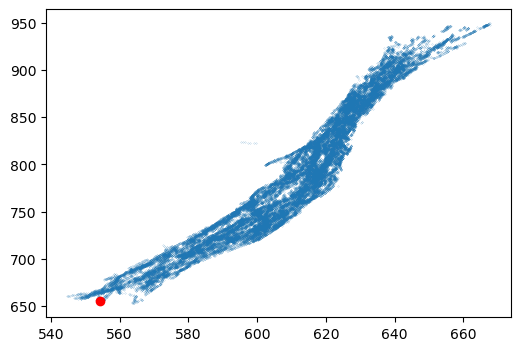

ANGLE
4.102573596530312


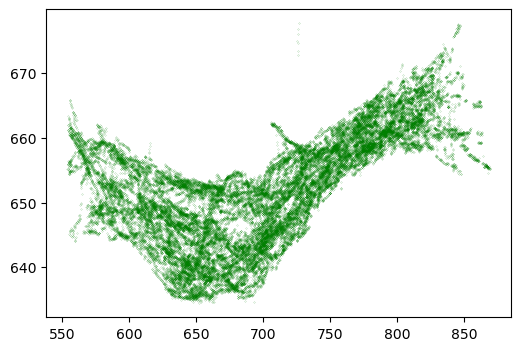

Window number 0
A and B: 
554.17 666.7011940812914 596.9451349911035 649.694498139173


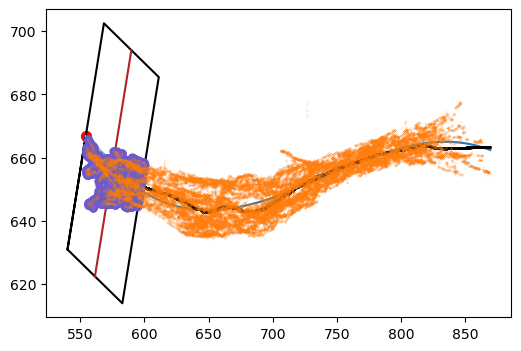

Window number 1
A and B: 
574.9897559691211 656.8596165005076 619.5945058787231 645.3078094855886


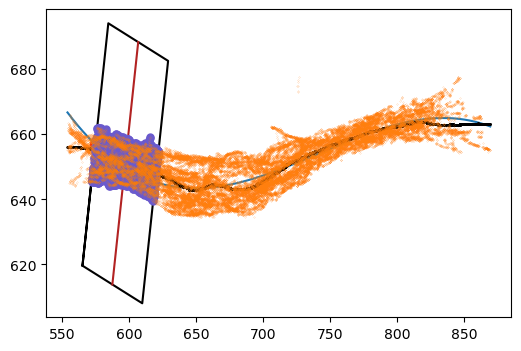

Window number 2
A and B: 
596.9451349911035 649.694498139173 642.5593276143597 643.4920140977839


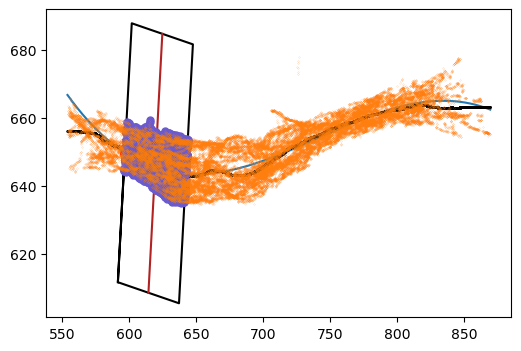

Window number 3
A and B: 
619.5945058787231 645.3078094855886 665.6503296892032 643.838968398296


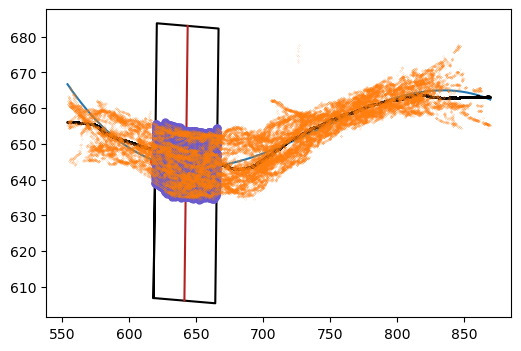

Window number 4
A and B: 
642.5593276143597 643.4920140977839 688.61515142484 645.845982329212


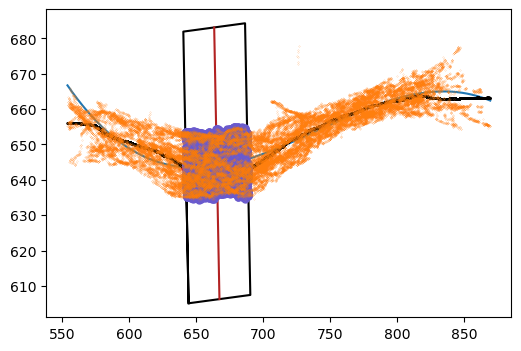

Window number 5
A and B: 
665.6503296892032 643.838968398296 711.5168829908732 649.003030973769


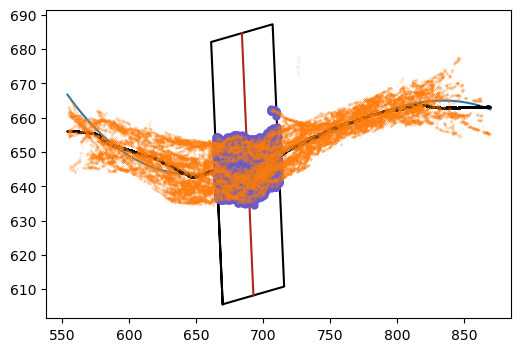

Window number 6
A and B: 
688.61515142484 645.845982329212 734.2293440480962 652.7881238919609


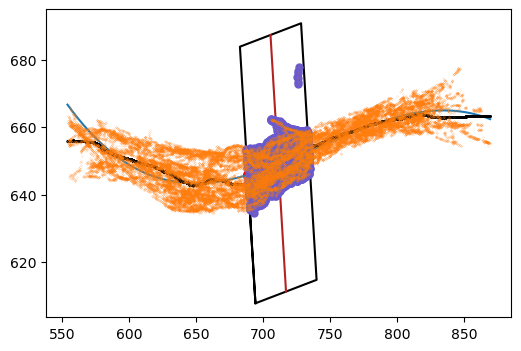

Window number 7
A and B: 
711.5168829908732 649.003030973769 757.0048952749228 656.7536497203222


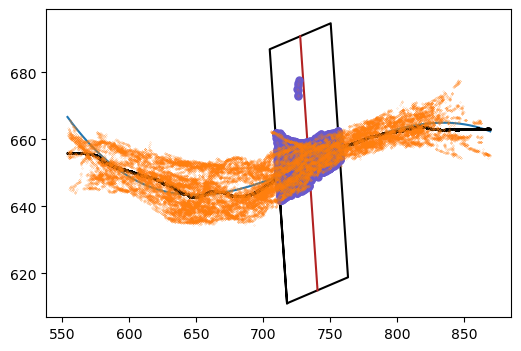

Window number 8
A and B: 
734.2293440480962 652.7881238919609 779.7804465017492 660.4053336866732


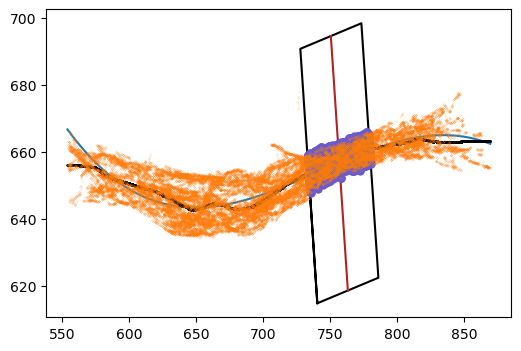

Window number 9
A and B: 
757.0048952749228 656.7536497203222 802.6821780677825 663.2714148311782


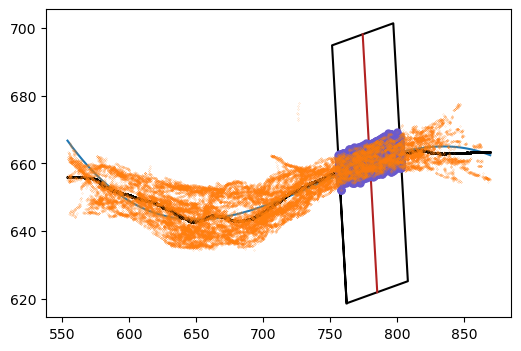

Window number 10
A and B: 
779.7804465017492 660.4053336866732 825.7100899730226 664.8419187419153


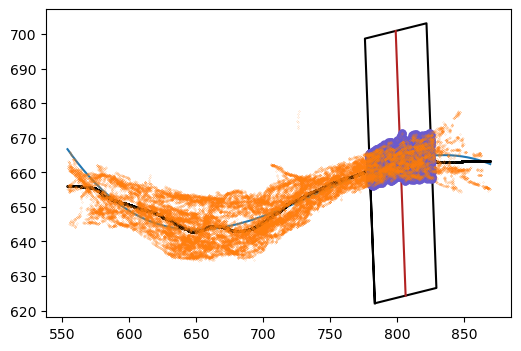

Window number 11
A and B: 
802.6821780677825 663.2714148311782 848.7380018782626 664.5976401549901


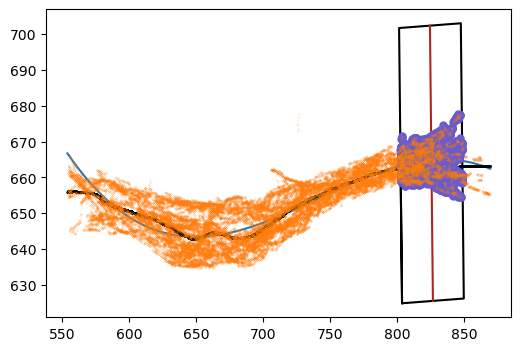

Window number 12
A and B: 
825.7100899730226 664.8419187419153 869.5577578473838 662.3974604865967


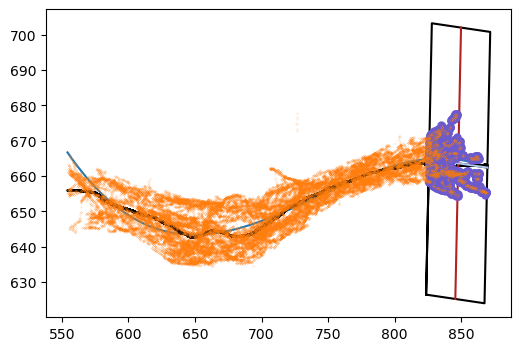

Neurite 3/8


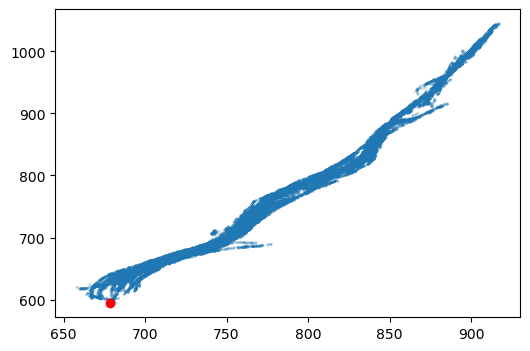

ANGLE
-3.6502562330306065


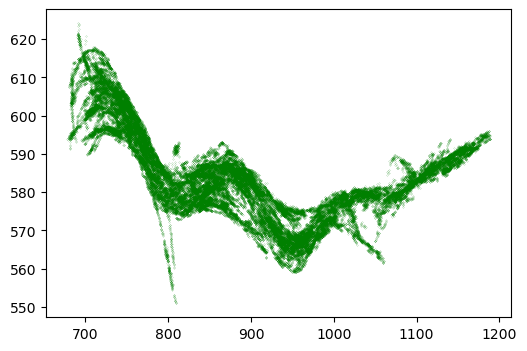

Window number 0
A and B: 
678.37 596.4088836683208 721.2689540281657 607.9103239952682


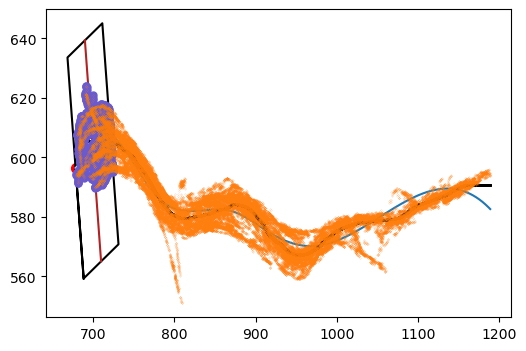

Window number 1
A and B: 
698.3895118798107 607.5449597334581 743.1269925091834 600.8743406055113


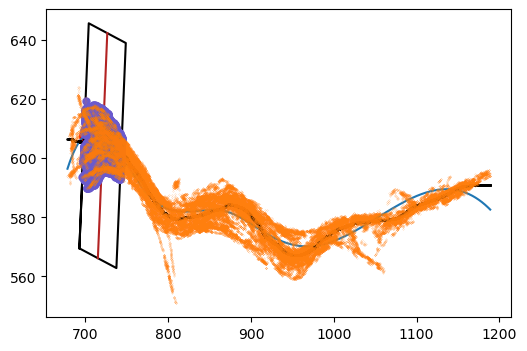

Window number 2
A and B: 
721.2689540281657 607.9103239952682 764.3721887897989 591.8247544384373


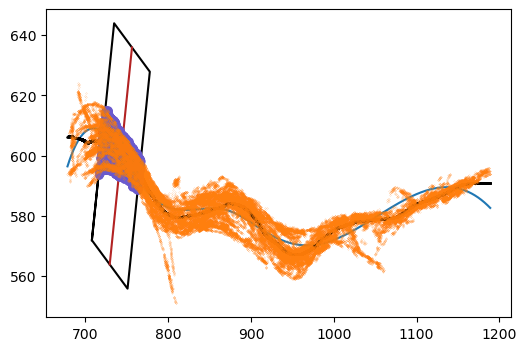

Window number 3
A and B: 
743.1269925091834 600.8743406055113 786.3323676375503 584.8908245950472


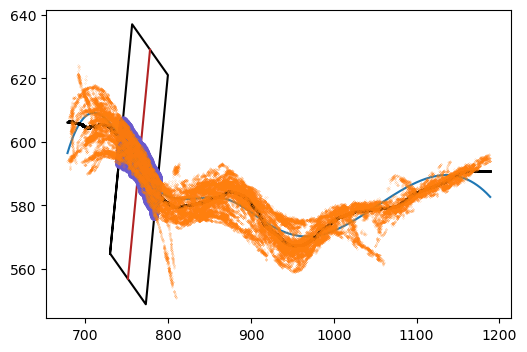

Window number 4
A and B: 
764.3721887897989 591.8247544384373 809.2118097859054 582.1553704153952


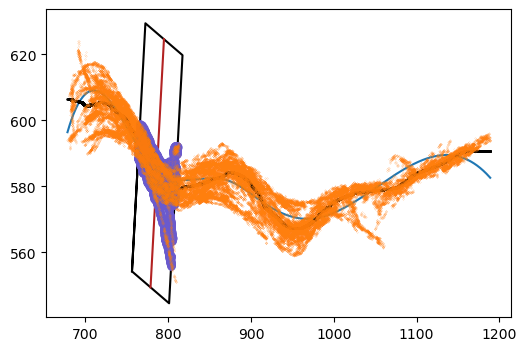

Window number 5
A and B: 
786.3323676375503 584.8908245950472 832.2955326677278 582.0794730323903


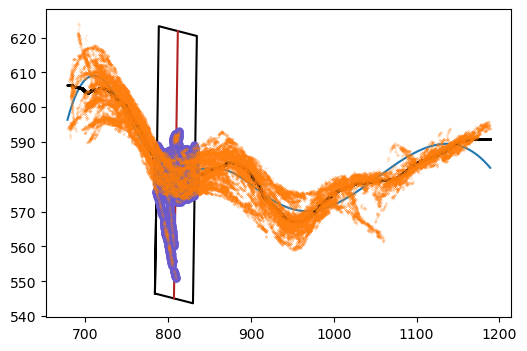

Window number 6
A and B: 
809.2118097859054 582.1553704153952 855.3792555495503 582.4759665350956


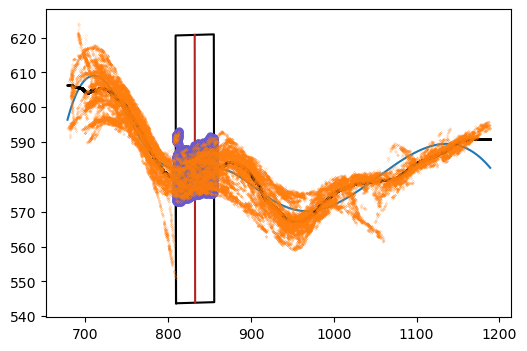

Window number 7
A and B: 
832.2955326677278 582.0794730323903 878.4629784313728 581.1402675311307


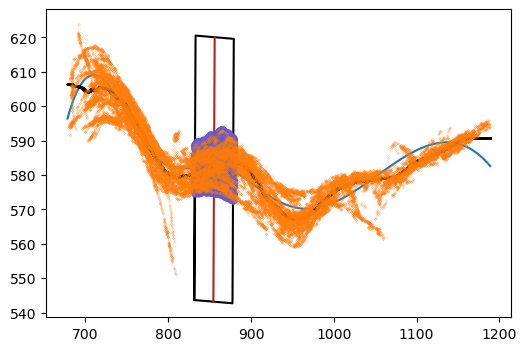

Window number 8
A and B: 
855.3792555495503 582.4759665350956 901.2402802129941 577.5480890258995


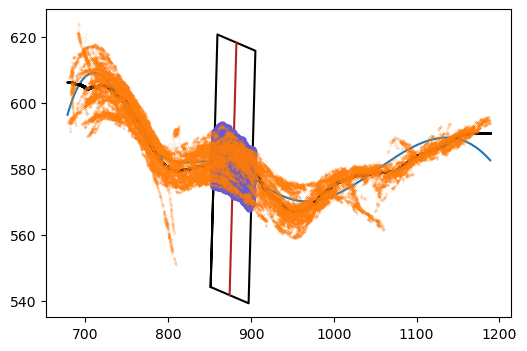

Window number 9
A and B: 
878.4629784313728 581.1402675311307 923.9154416278817 573.6319044100258


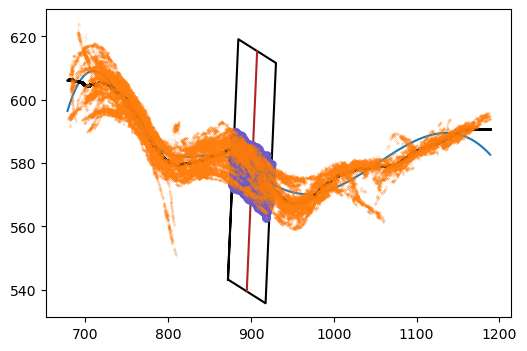

Window number 10
A and B: 
901.2402802129941 577.5480890258995 946.8970241429704 570.9835240205836


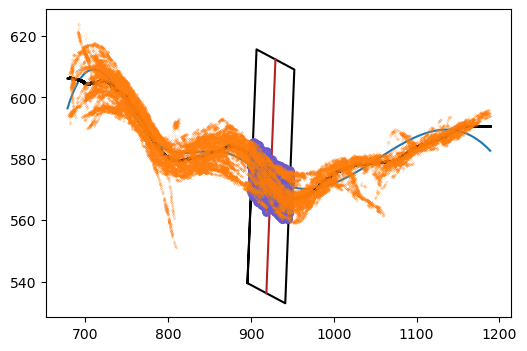

Window number 11
A and B: 
923.9154416278817 573.6319044100258 969.8786066580592 570.1461837663859


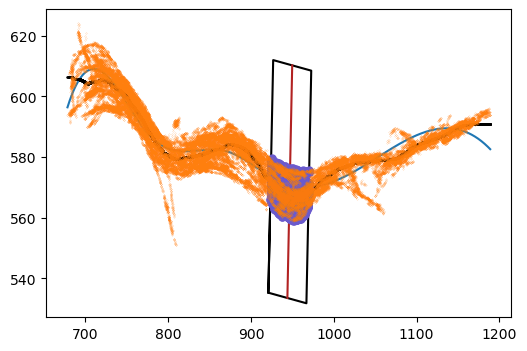

Window number 12
A and B: 
946.8970241429704 570.9835240205836 992.9623295398817 571.2871203117203


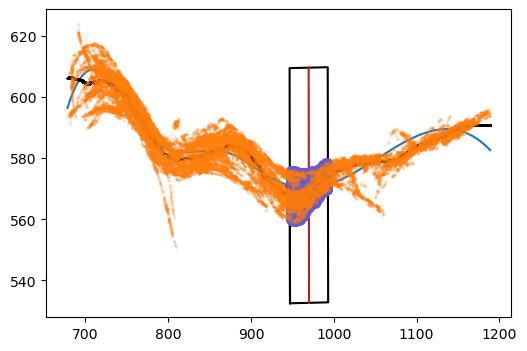

Window number 13
A and B: 
969.8786066580592 570.1461837663859 1015.8417716882368 573.9389992116664


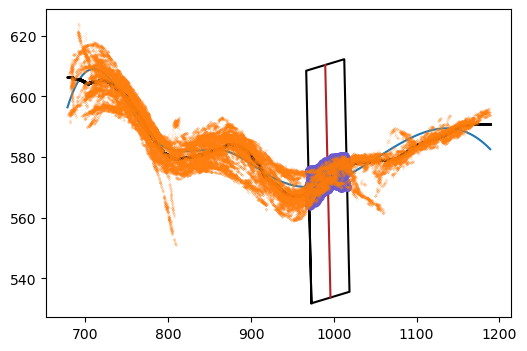

Window number 14
A and B: 
992.9623295398817 571.2871203117203 1038.7212138365917 577.518796833088


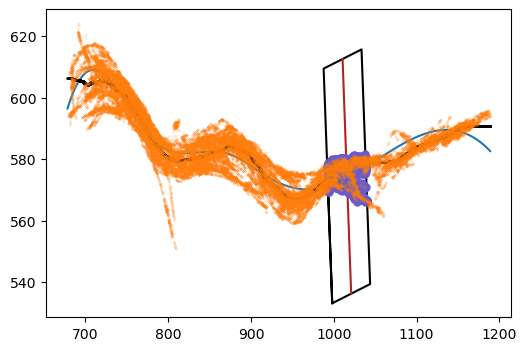

Window number 15
A and B: 
1015.8417716882368 573.9389992116664 1061.3963752514794 581.4070630275824


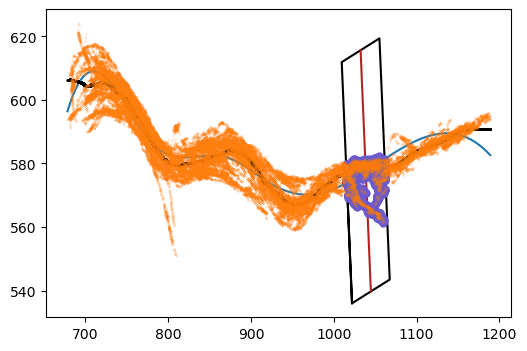

Window number 16
A and B: 
1038.7212138365917 577.518796833088 1084.1736770331006 585.0785095731004


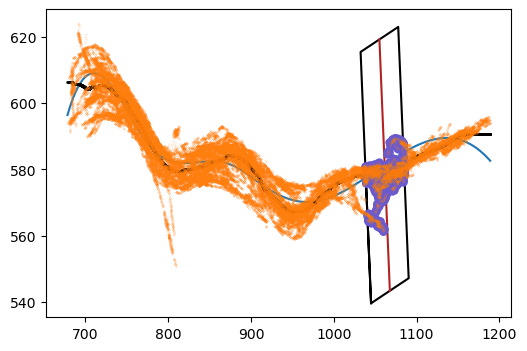

Window number 17
A and B: 
1061.3963752514794 581.4070630275824 1107.1552595481894 587.9593714066496


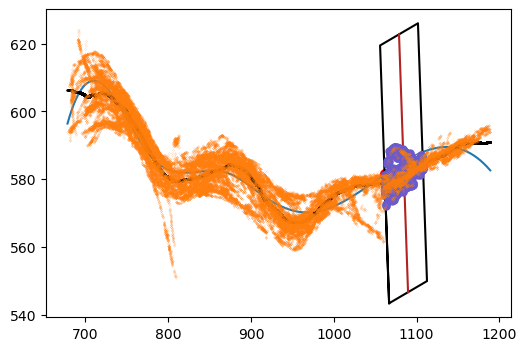

Window number 18
A and B: 
1084.1736770331006 585.0785095731004 1130.1368420632782 589.4223148153586


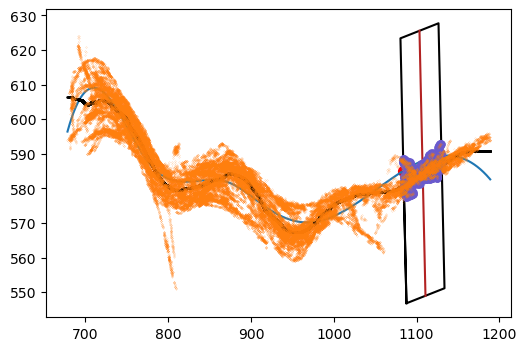

Window number 19
A and B: 
1107.1552595481894 587.9593714066496 1153.2205649451007 588.8670505507727


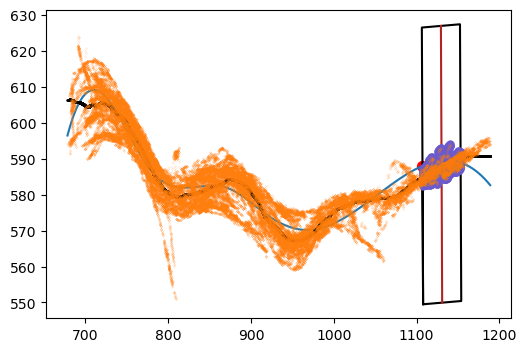

Window number 20
A and B: 
1130.1368420632782 589.4223148153586 1175.997866726722 585.7451380797584


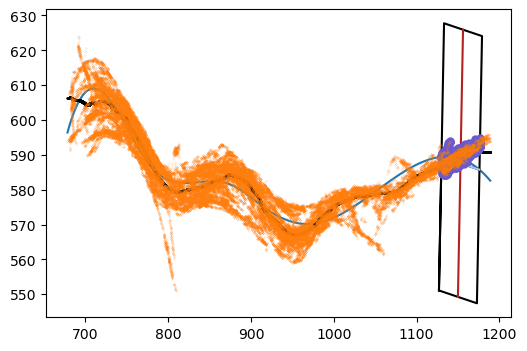

Window number 21
A and B: 
1153.2205649451007 588.8670505507727 1188.9696933019054 582.6025286806209


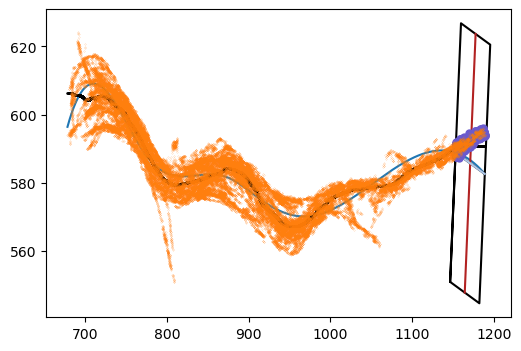

Window number 22
A and B: 
1175.997866726722 585.7451380797584 1188.9696933019054 582.6025286806209


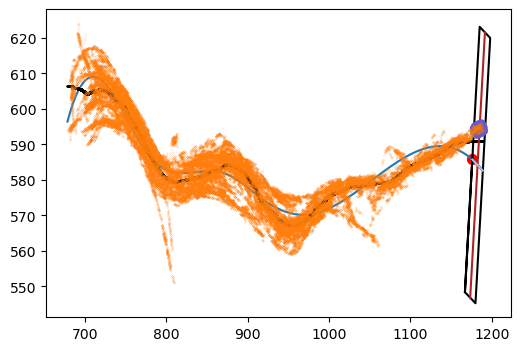

Neurite 4/8


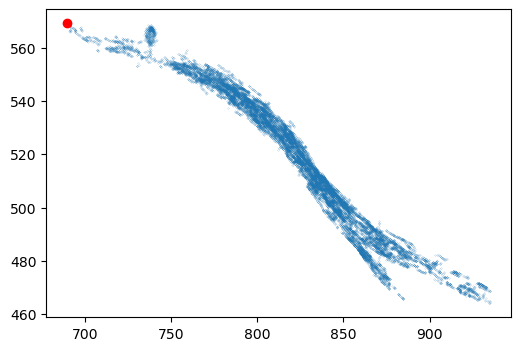

ANGLE
-13.62639863111565


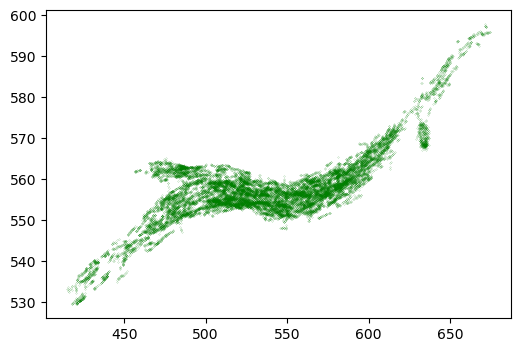

REVERSE
Window number 0
A and B: 
674.5388870815176 584.6495027512849 631.3849527846717 568.4101151869786


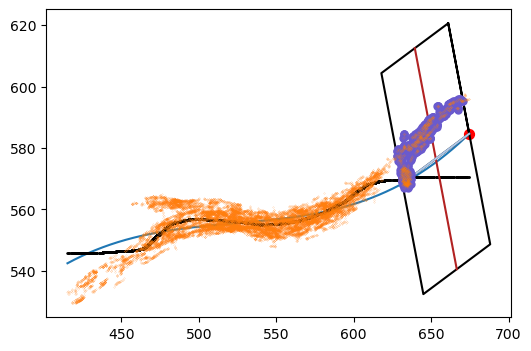

Window number 1
A and B: 
653.3768616090258 575.4990952744366 608.9262345748948 563.2869273942023


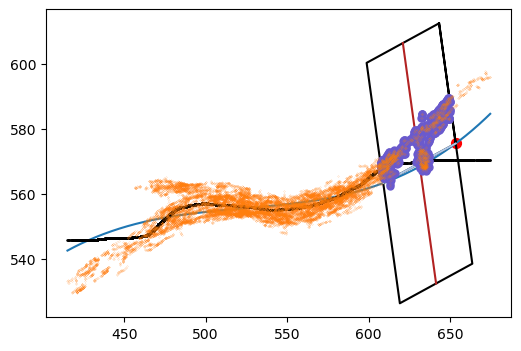

Window number 2
A and B: 
631.3849527846717 568.4101151869786 586.1044423986782 559.8155540762442


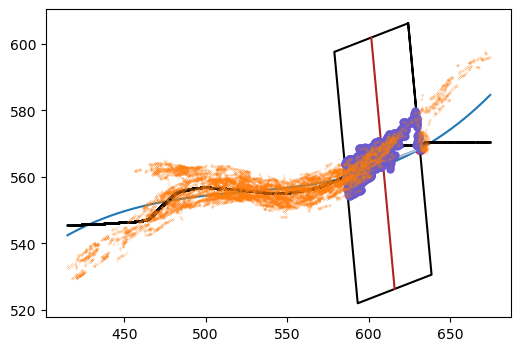

Window number 3
A and B: 
608.9262345748948 563.2869273942023 563.1270470939874 557.6158220677032


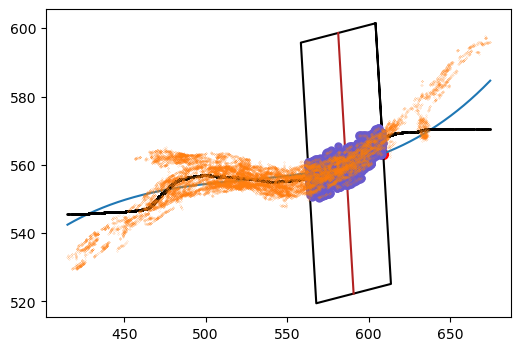

Window number 4
A and B: 
586.1044423986782 559.8155540762442 540.0977840798051 556.236911466986


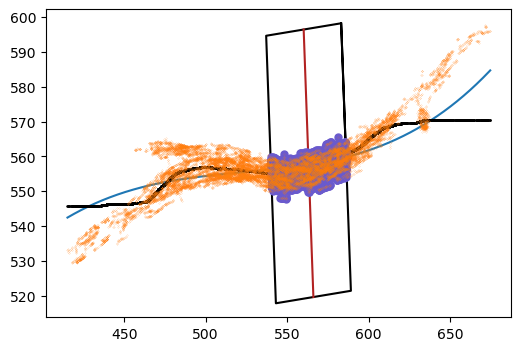

Window number 5
A and B: 
563.1270470939874 557.6158220677032 517.0685210656229 555.2044082912406


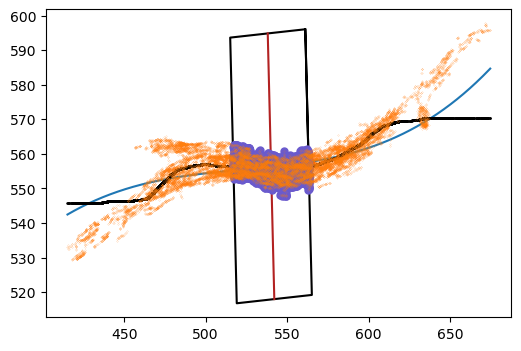

Window number 6
A and B: 
540.0977840798051 556.236911466986 493.9873903419493 554.0344996925564


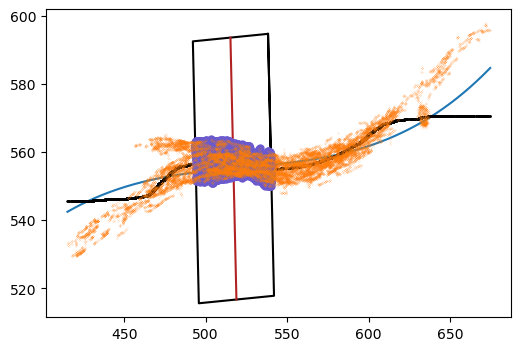

Window number 7
A and B: 
517.0685210656229 555.2044082912406 471.00999503725853 552.2559387310064


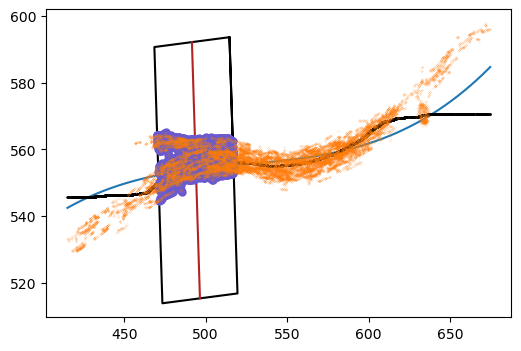

Window number 8
A and B: 
493.9873903419493 554.0344996925564 448.0844674420591 549.3947637835636


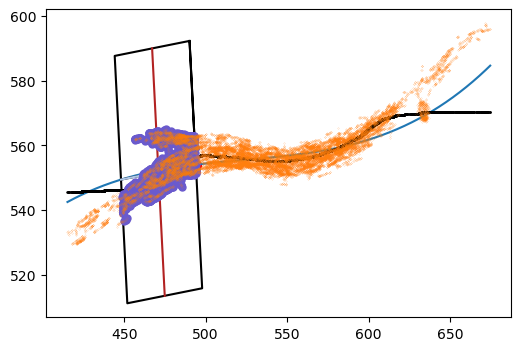

Window number 9
A and B: 
471.00999503725853 552.2559387310064 425.4182783943167 545.0341194898383


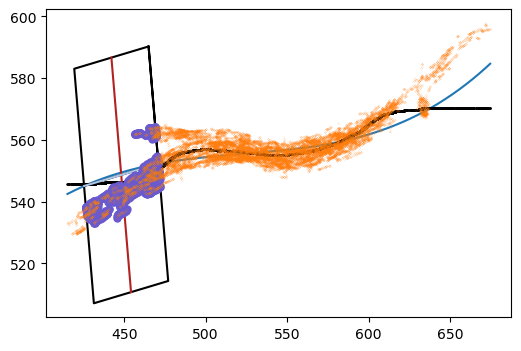

Window number 10
A and B: 
448.0844674420591 549.3947637835636 415.25220733400204 542.4614755417562


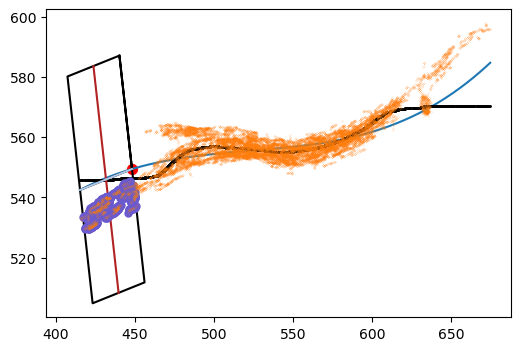

Neurite 5/8


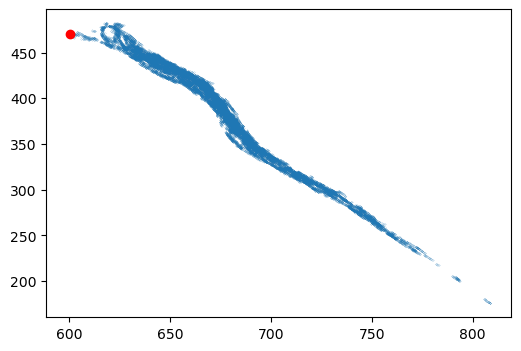

ANGLE
-8.766706703097586


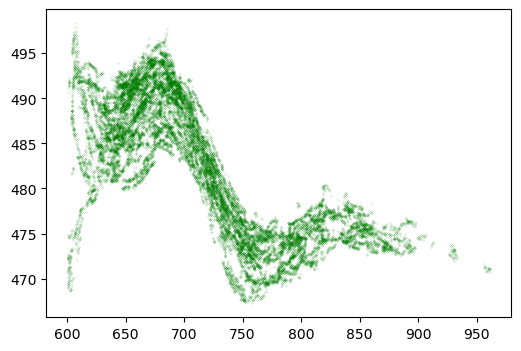

Window number 0
A and B: 
600.29 485.6753533267362 646.1142233522608 490.17567138613896


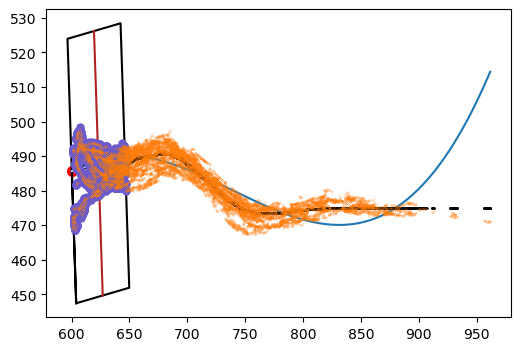

Window number 1
A and B: 
623.129833721316 489.08906929922665 669.1708909380196 489.3674134912066


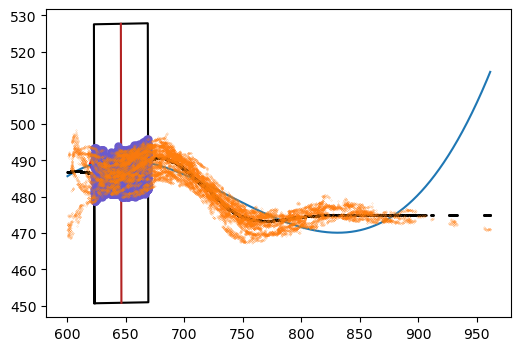

Window number 2
A and B: 
646.1142233522608 490.17567138613896 692.1552805689643 487.13785142988934


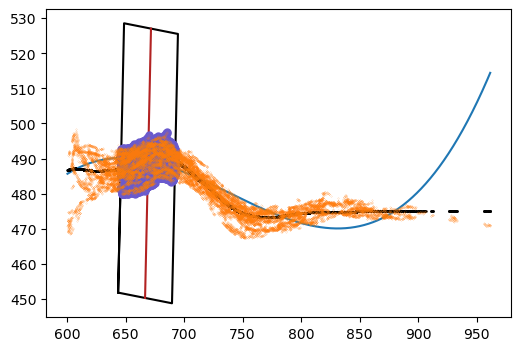

Window number 3
A and B: 
669.1708909380196 489.3674134912066 714.9951142902804 483.97647136534334


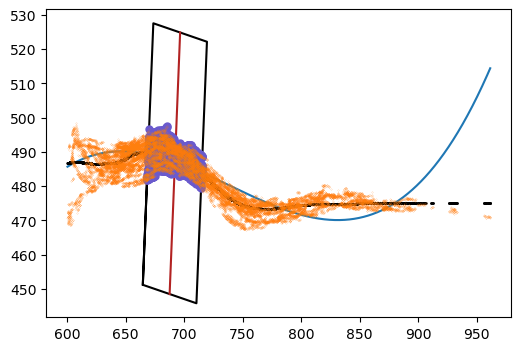

Window number 4
A and B: 
692.1552805689643 487.13785142988934 737.8349480115965 480.3317040830851


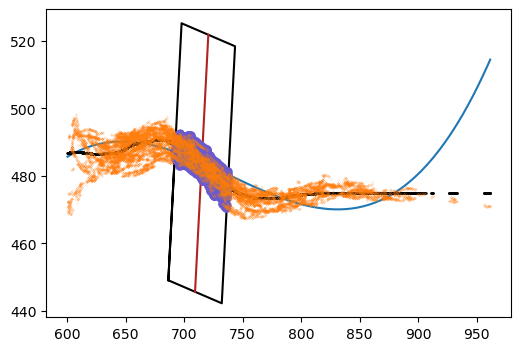

Window number 5
A and B: 
714.9951142902804 483.97647136534334 760.6025037780983 476.67322245938897


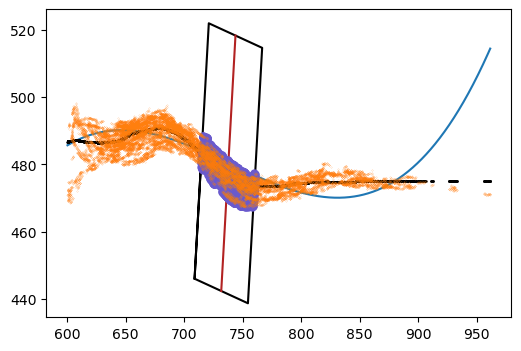

Window number 6
A and B: 
737.8349480115965 480.3317040830851 783.4423374994143 473.4350918352061


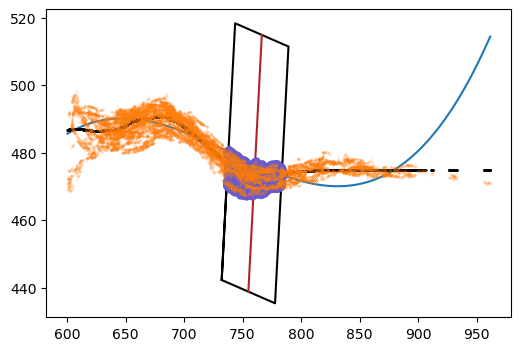

Window number 7
A and B: 
760.6025037780983 476.67322245938897 806.4267271303589 471.0765850789097


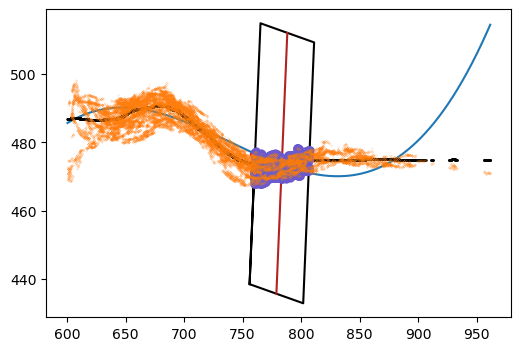

Window number 8
A and B: 
783.4423374994143 473.4350918352061 829.4833947161179 470.0868605790207


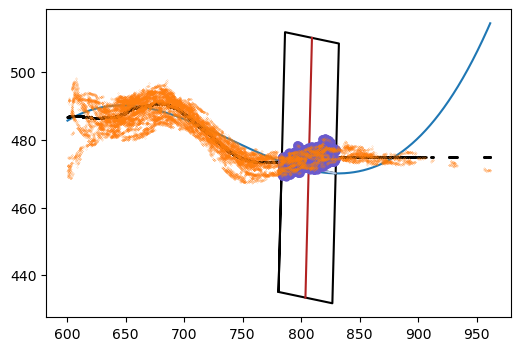

Window number 9
A and B: 
806.4267271303589 471.0765850789097 852.5400623018769 470.9466877153003


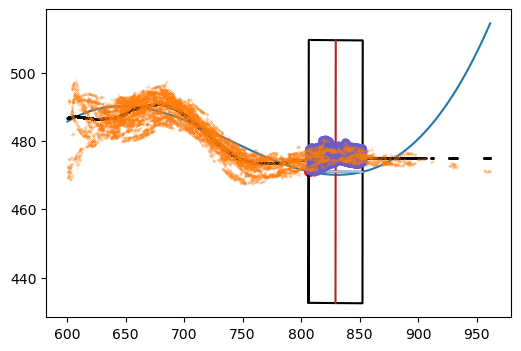

Window number 10
A and B: 
829.4833947161179 470.0868605790207 875.3798960231929 474.0855655570594


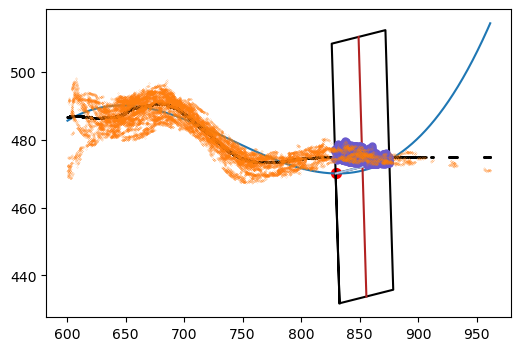

Window number 11
A and B: 
852.5400623018769 470.9466877153003 897.713784060809 479.79767250198586


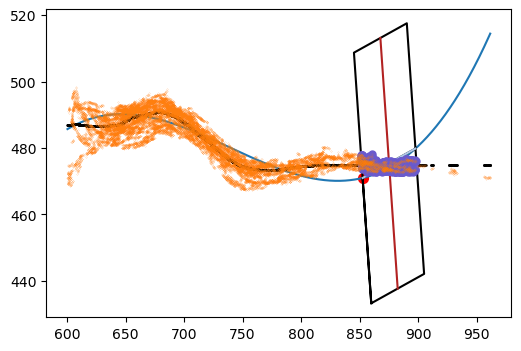

Window number 12
A and B: 
875.3798960231929 474.0855655570594 919.1803366406535 488.15273286194315


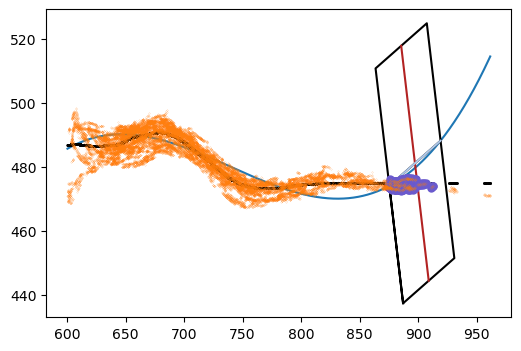

Window number 13
A and B: 
897.713784060809 479.79767250198586 939.5627198982836 499.03585613992954


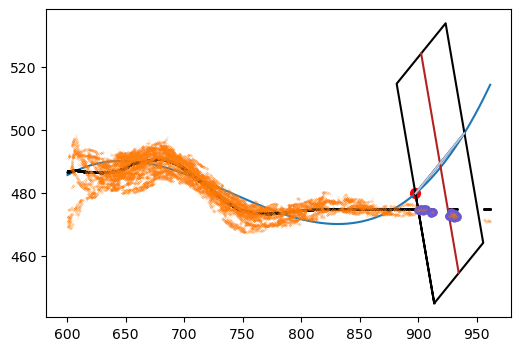

Window number 14
A and B: 
919.1803366406535 488.15273286194315 958.5718220144423 512.0677096305931


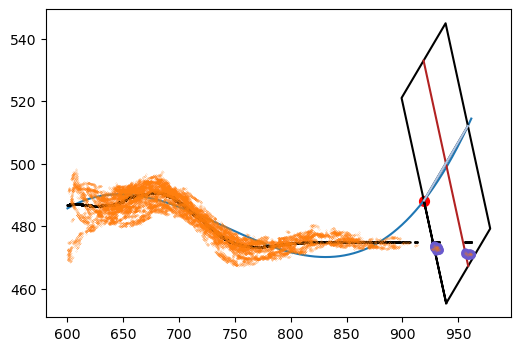

Window number 15
A and B: 
939.5627198982836 499.03585613992954 961.6074961166426 514.4246188955395


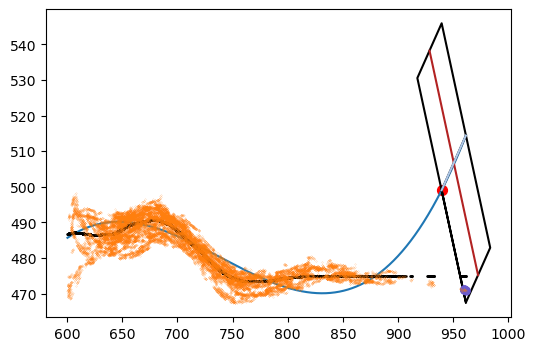

Window number 16
Neurite 6/8


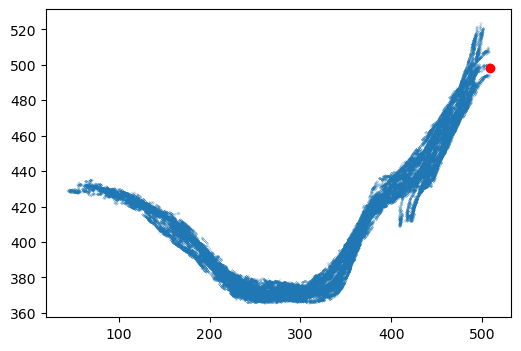

ANGLE
1.485103708841988


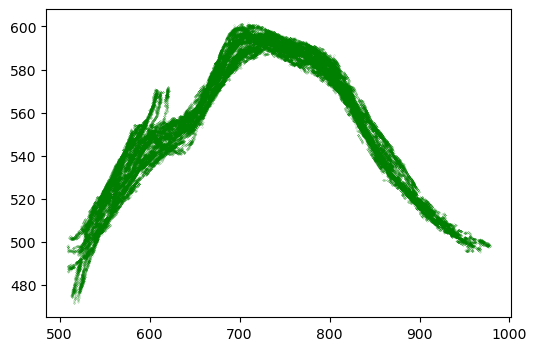

Window number 0
A and B: 
508.64 472.87103541240924 537.3128674041565 508.86674523134275


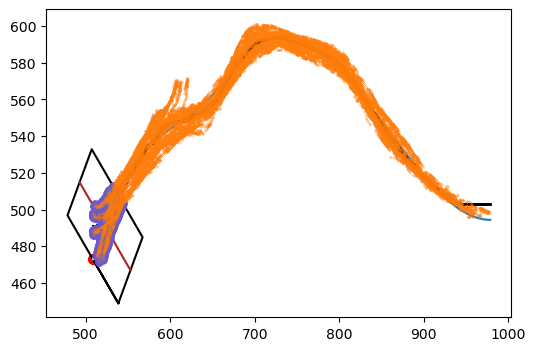

Window number 1
A and B: 
521.8953255868395 491.7028518097369 555.174653655926 523.4425311900131


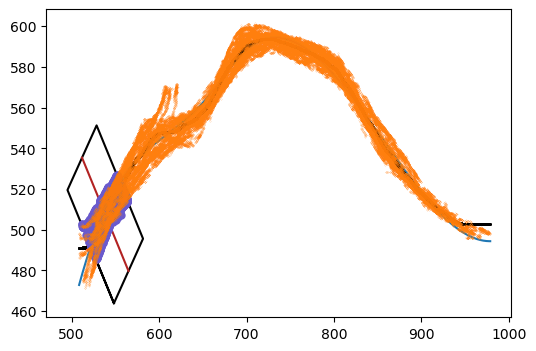

Window number 2
A and B: 
537.3128674041565 508.86674523134275 575.3866749408232 534.6605140155082


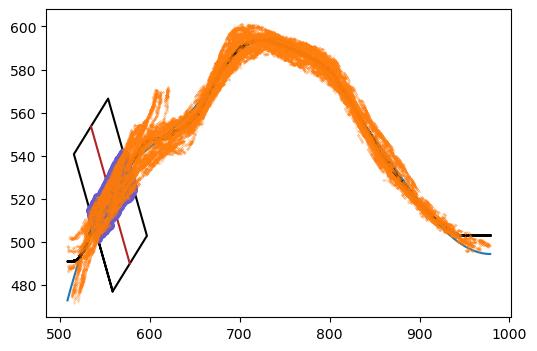

Window number 3
A and B: 
555.174653655926 523.4425311900131 596.9148278442718 542.8449332586364


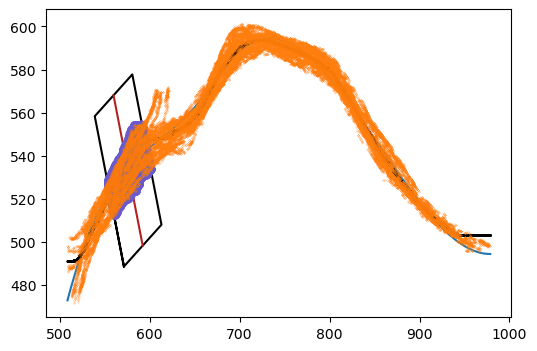

Window number 4
A and B: 
575.3866749408232 534.6605140155082 618.8190183530209 550.0783619092819


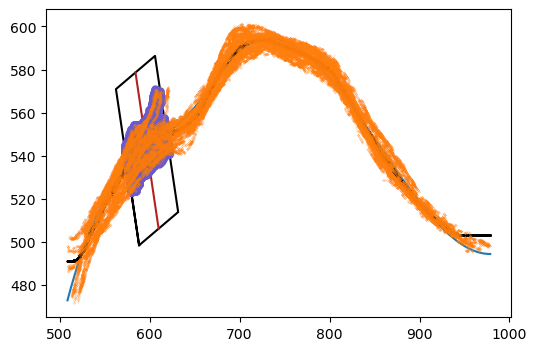

Window number 5
A and B: 
596.9148278442718 542.8449332586364 640.4411806577946 558.1361134255014


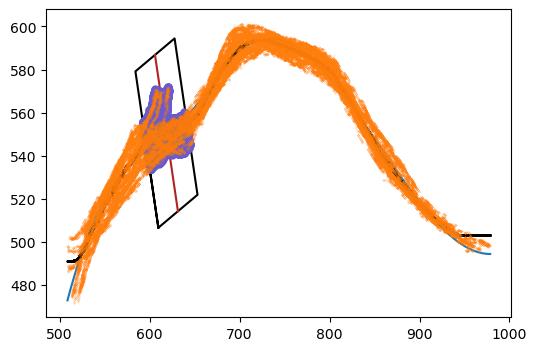

Window number 6
A and B: 
618.8190183530209 550.0783619092819 661.2172583506424 568.1412568036238


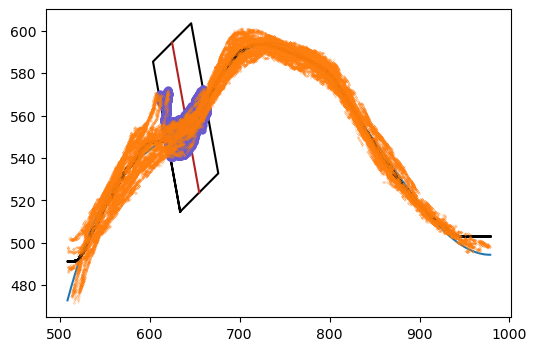

Window number 7
A and B: 
640.4411806577946 558.1361134255014 681.3352702342145 579.5094275464172


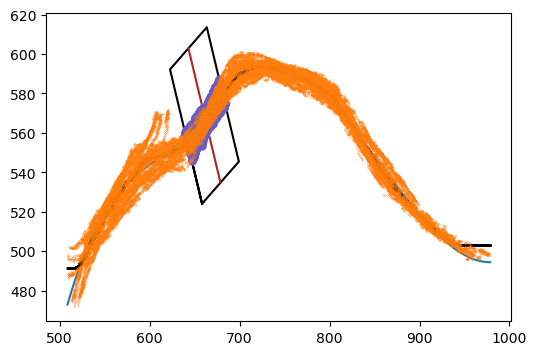

Window number 8
A and B: 
661.2172583506424 568.1412568036238 702.2053573283873 589.2014651721214


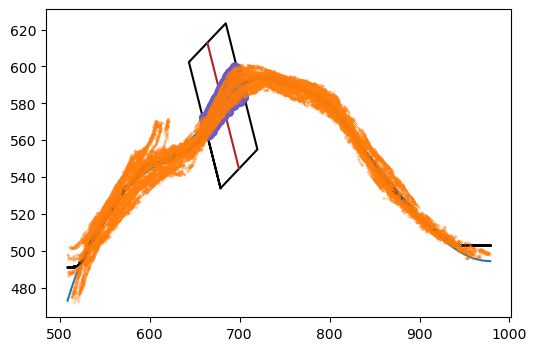

Window number 9
A and B: 
681.3352702342145 579.5094275464172 724.673604245087 594.0351812006534


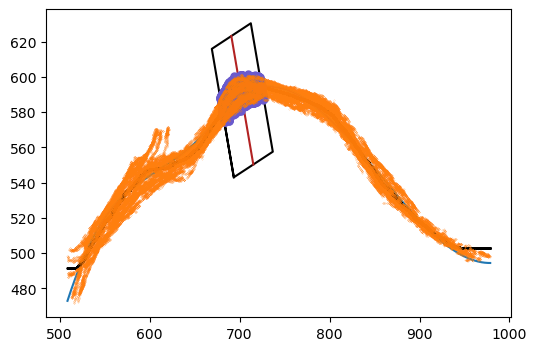

Window number 10
A and B: 
702.2053573283873 589.2014651721214 747.7059075697373 593.3974412049059


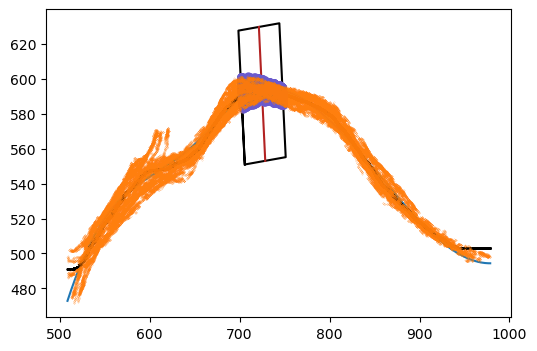

Window number 11
A and B: 
724.673604245087 594.0351812006534 770.1741544864369 588.263966888536


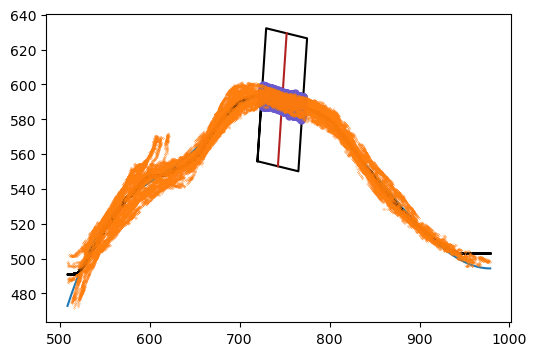

Window number 12
A and B: 
747.7059075697373 593.3974412049059 791.7023073898855 580.0285329102458


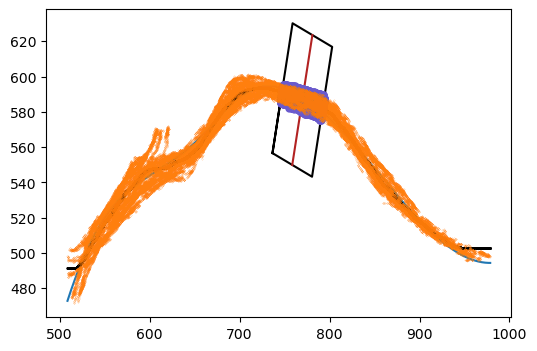

Window number 13
A and B: 
770.1741544864369 588.263966888536 812.4783850827333 569.7768460950621


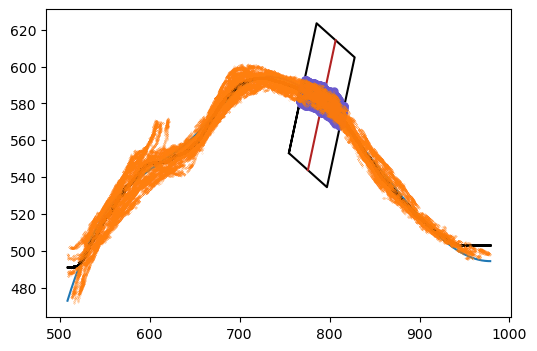

Window number 14
A and B: 
791.7023073898855 580.0285329102458 832.5023875649803 558.4468056819887


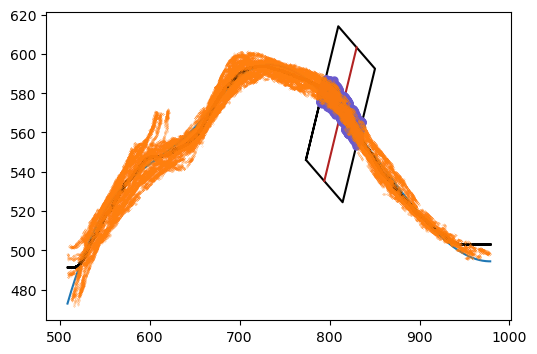

Window number 15
A and B: 
812.4783850827333 569.7768460950621 852.2443618432519 546.5295624631294


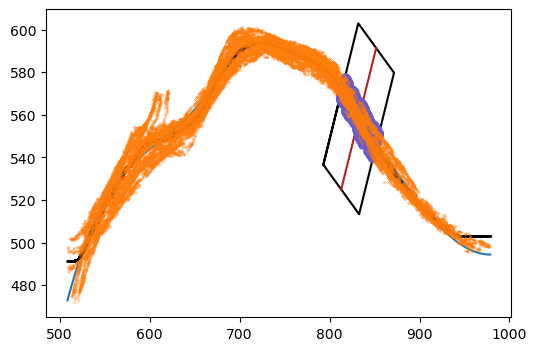

Window number 16
A and B: 
832.5023875649803 558.4468056819887 871.9863361215237 534.5013360587093


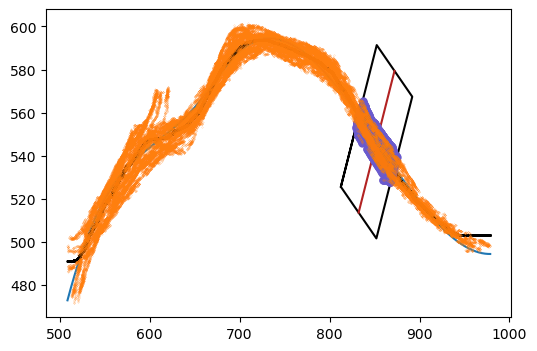

Window number 17
A and B: 
852.2443618432519 546.5295624631294 891.9163292024455 522.8845081893639


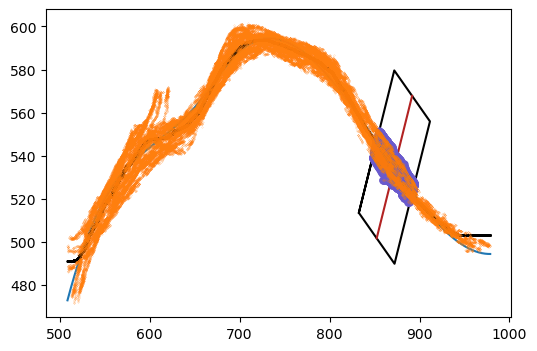

Window number 18
A and B: 
871.9863361215237 534.5013360587093 912.3163692899928 512.2127732669456


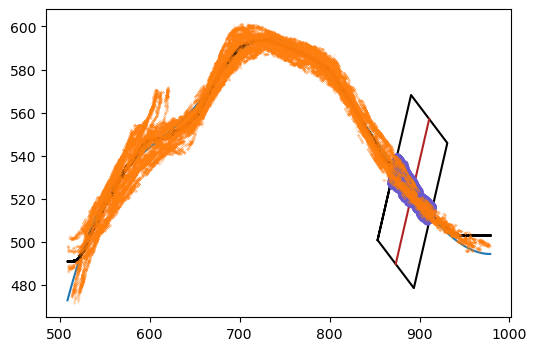

Window number 19
A and B: 
891.9163292024455 522.8845081893639 933.5624939894661 503.15007240951536


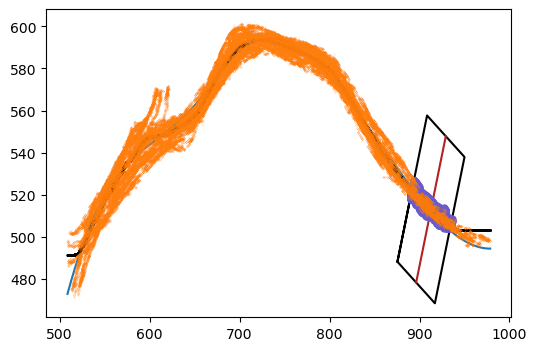

Window number 20
A and B: 
912.3163692899928 512.2127732669456 955.7487127021905 496.75673541012975


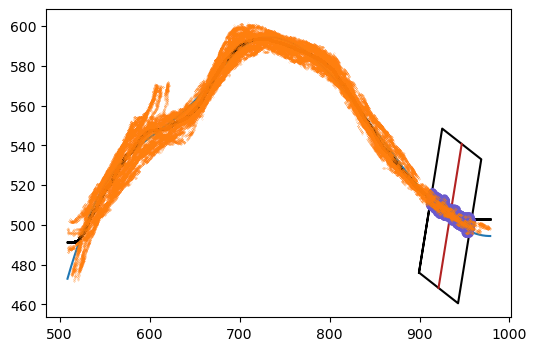

Window number 21
A and B: 
933.5624939894661 503.15007240951536 978.5929972241905 494.3782457363169


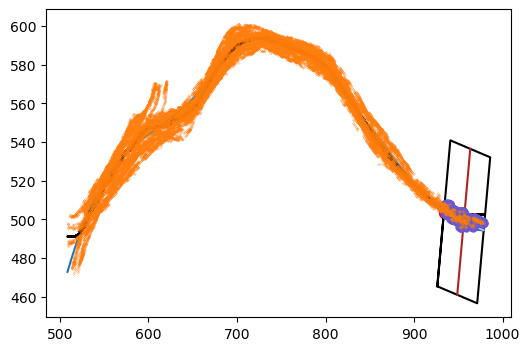

Window number 22
A and B: 
955.7487127021905 496.75673541012975 978.5929972241905 494.3782457363169


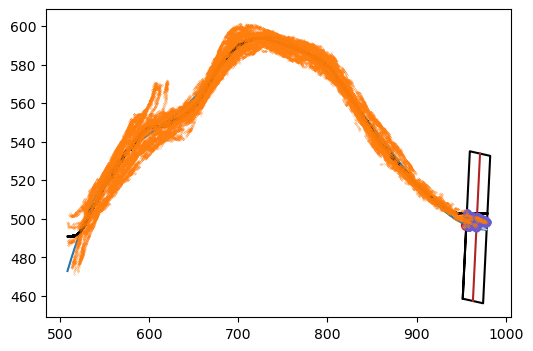

Neurite 7/8


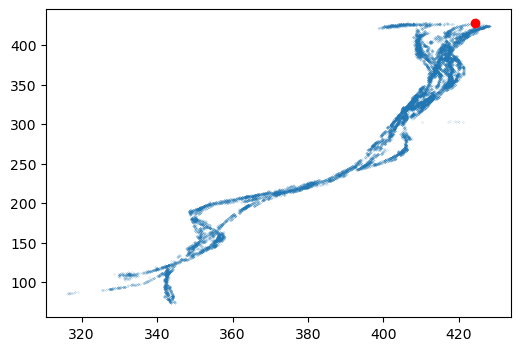

ANGLE
0.9012489960516292


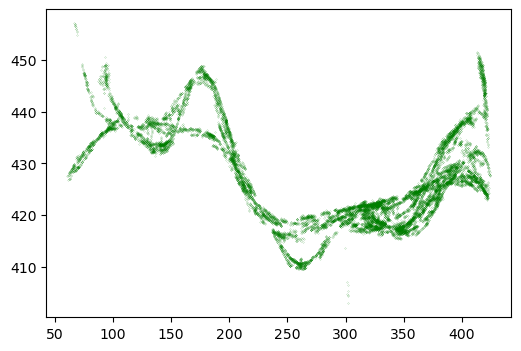

REVERSE
Window number 0
A and B: 
424.36 436.6546158214667 379.87336160325646 424.6426900361853


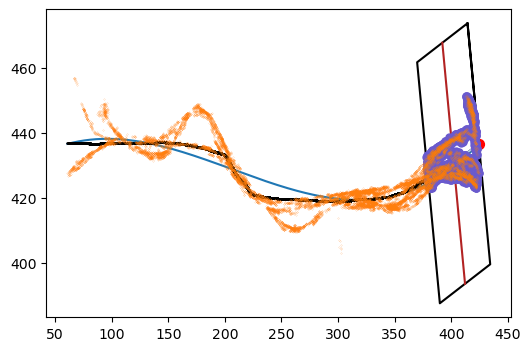

Window number 1
A and B: 
402.33475255847503 429.7044175992163 357.04851771995993 421.3541760320947


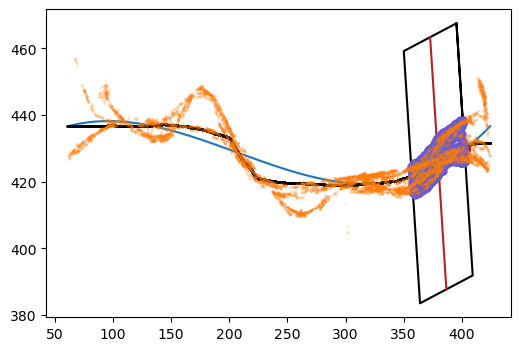

Window number 2
A and B: 
379.87336160325646 424.6426900361853 334.00560207981664 419.68122061957035


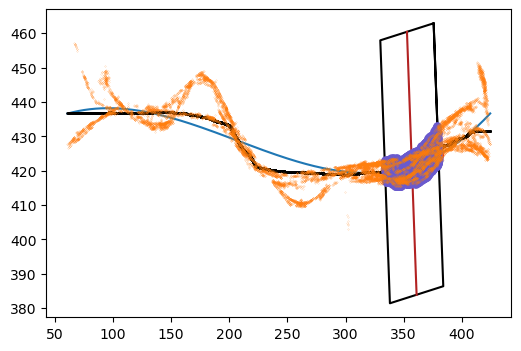

Window number 3
A and B: 
357.04851771995993 421.3541760320947 310.96268643967335 419.40983339092577


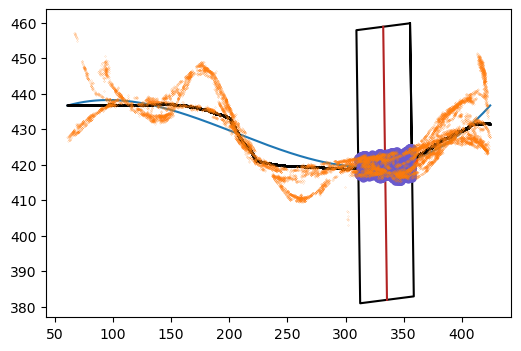

Window number 4
A and B: 
334.00560207981664 419.68122061957035 287.8470802139144 420.29028444451757


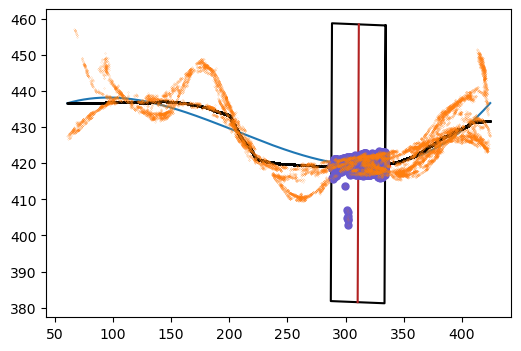

Window number 5
A and B: 
310.96268643967335 419.40983339092577 264.8768551593867 422.05559931092114


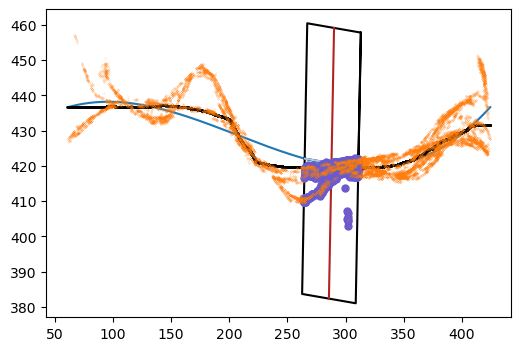

Window number 6
A and B: 
287.8470802139144 420.29028444451757 241.906630104859 424.4563312401254


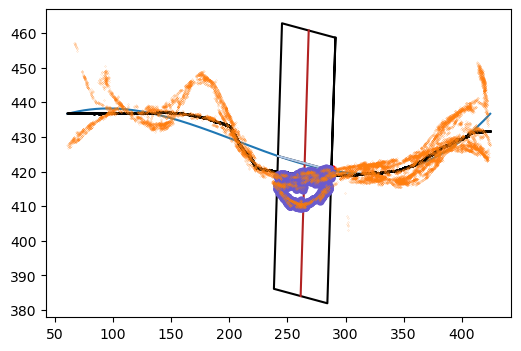

Window number 7
A and B: 
264.8768551593867 422.05559931092114 219.0090956359469 427.2316829385351


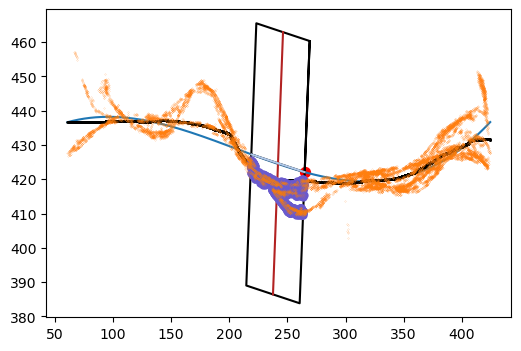

Window number 8
A and B: 
241.906630104859 424.4563312401254 196.11156116703478 430.1391191880071


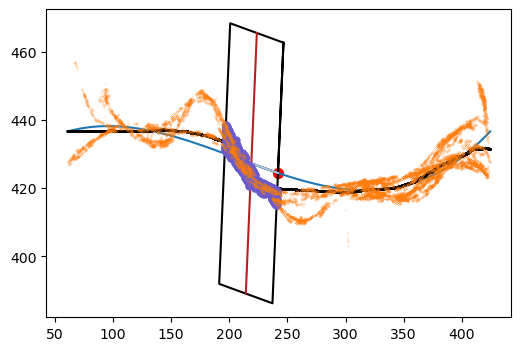

Window number 9
A and B: 
219.0090956359469 427.2316829385351 173.21402669812267 432.92937702000125


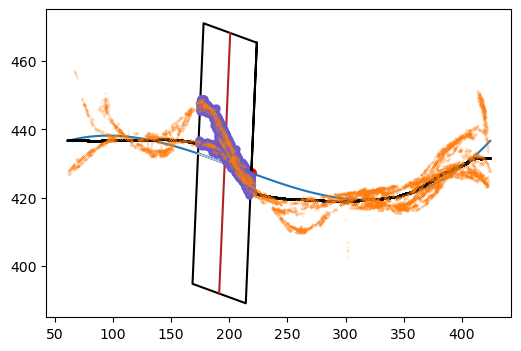

Window number 10
A and B: 
196.11156116703478 430.1391191880071 150.24380164359496 435.3600395941342


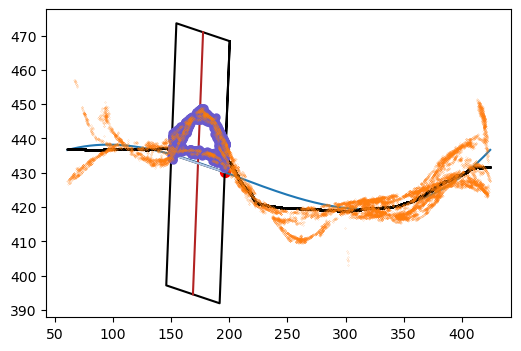

Window number 11
A and B: 
173.21402669812267 432.92937702000125 127.27357658906723 437.1702860313946


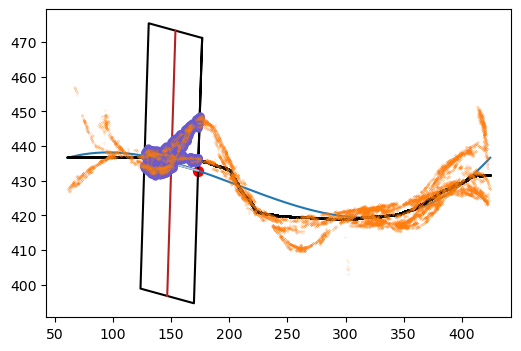

Window number 12
A and B: 
150.24380164359496 435.3600395941342 104.23066094892394 438.10978991013747


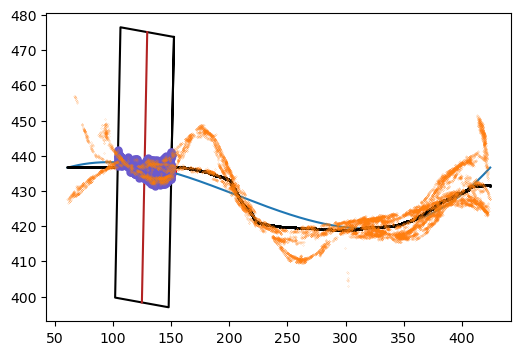

Window number 13
A and B: 
127.27357658906723 437.1702860313946 81.11505472316503 437.91499905203483


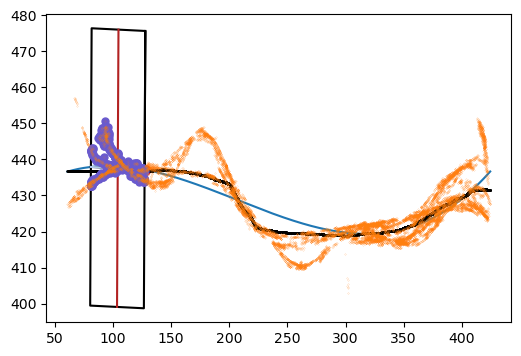

Window number 14
A and B: 
104.23066094892394 438.10978991013747 60.97976250764549 436.61730724085066


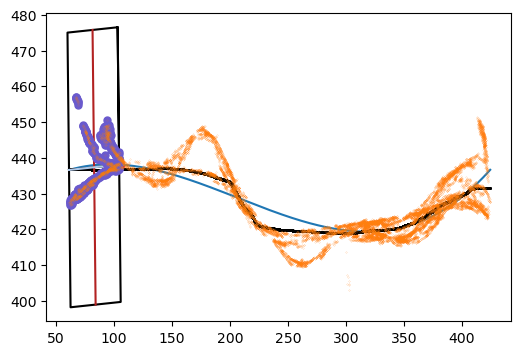

ALL DONE
Saving the data frame for DoM reconstruction
number of localisations toward soma 102757
number of localisations away from soma 127718
Ratio in over total 0.45
Results_PLUSIN_w.csv
Results_PLUSOUT_w.csv
Saving the whole data frame
S01_C03_R01
F:\PERSONAL\Malina\NanoscopeII\mP_LastRound\Analysis\2024-04-09_Motor_PAINT_Neurons_DIV1_Analysis\S01_C03_R01
[(512.1574368831266, 353.6261096820832)]
Warning. No corresponding stage found for 'F:\PERSONAL\Malina\NanoscopeII\mP_LastRound\Analysis\2024-04-09_Motor_PAINT_Neurons_DIV1_Analysis\S01_C03_R01_1_S01_C03'. Proceeding anyways.
Neurite 1/3


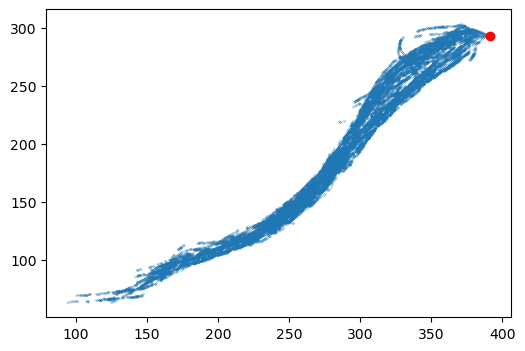

ANGLE
10.164401059136631


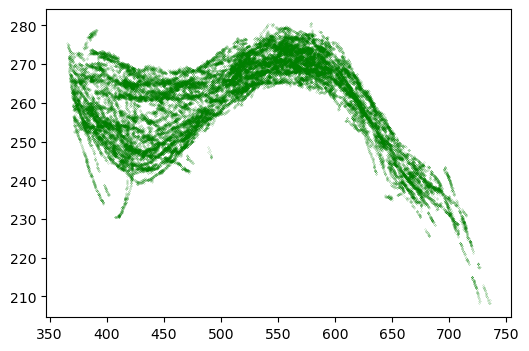

Window number 0
A and B: 
365.69497358947456 259.8581491568129 411.4091587630557 254.25078711075616


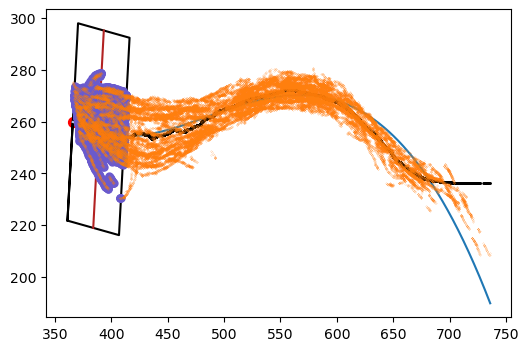

Window number 1
A and B: 
388.366838521591 255.59961306965377 434.4514790045204 255.2001936564887


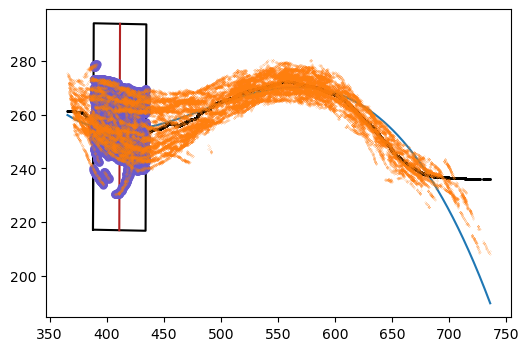

Window number 2
A and B: 
411.4091587630557 254.25078711075616 457.3456171222458 257.718930566117


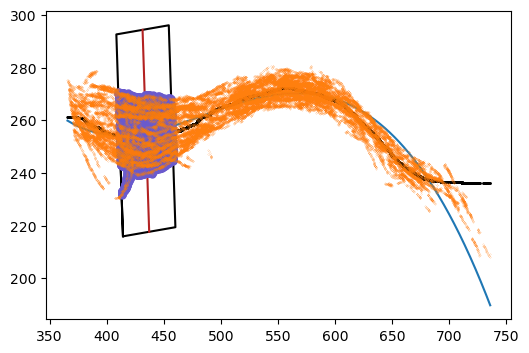

Window number 3
A and B: 
434.4514790045204 255.2001936564887 480.16566417810157 261.09946704328405


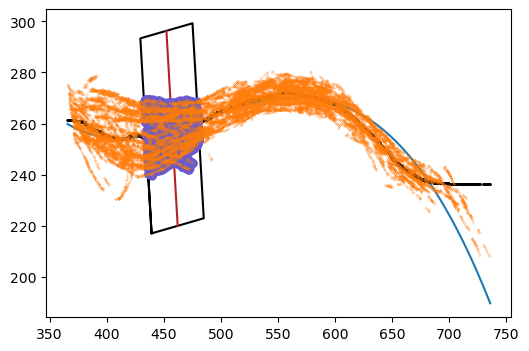

Window number 4
A and B: 
457.3456171222458 257.718930566117 502.9857112339573 264.6591150435856


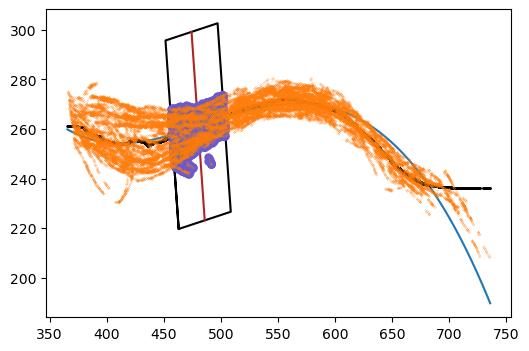

Window number 5
A and B: 
480.16566417810157 261.09946704328405 525.8798493516827 267.7267605748027


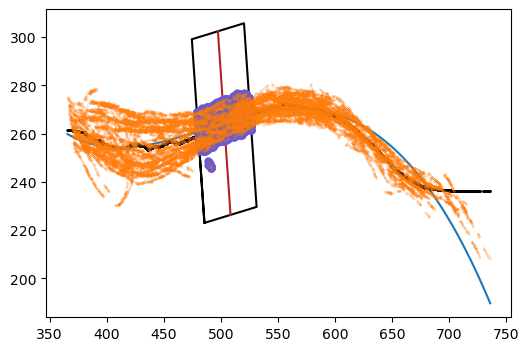

Window number 6
A and B: 
502.9857112339573 264.6591150435856 548.8480785312778 269.7442451081706


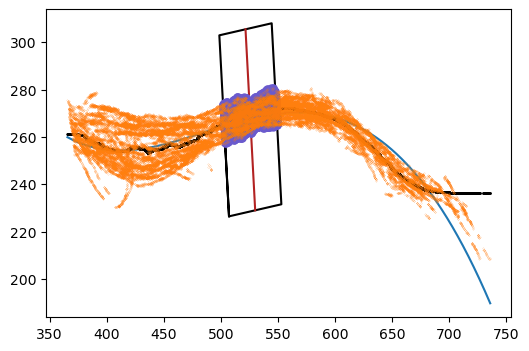

Window number 7
A and B: 
525.8798493516827 267.7267605748027 571.8903987727425 270.2465684605109


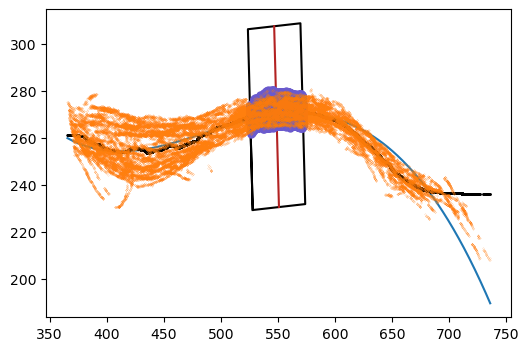

Window number 8
A and B: 
548.8480785312778 269.7442451081706 594.9327190142072 268.7709246671388


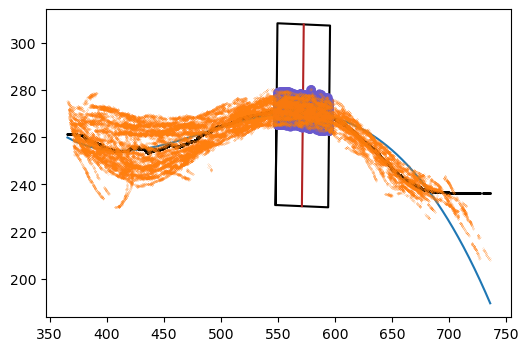

Window number 9
A and B: 
571.8903987727425 270.2465684605109 617.6786750081933 264.93059319125587


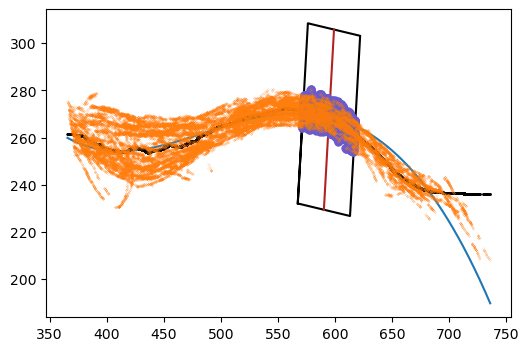

Window number 10
A and B: 
594.9327190142072 268.7709246671388 639.8319025072221 258.49559246153535


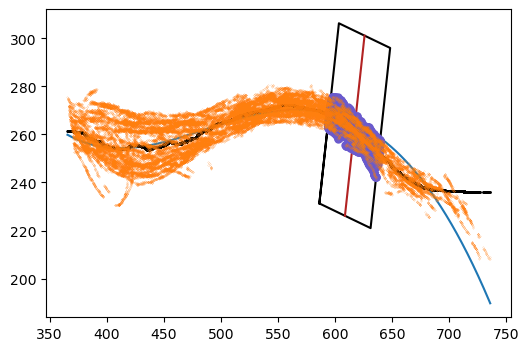

Window number 11
A and B: 
617.6786750081933 264.93059319125587 661.0219462019453 249.47642575547957


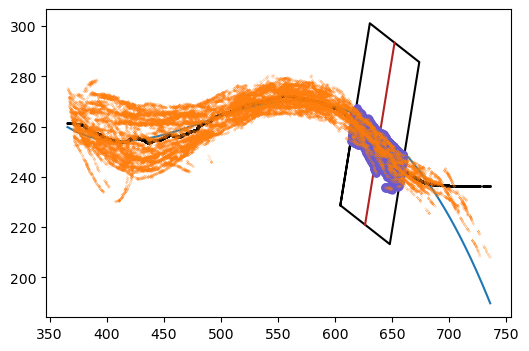

Window number 12
A and B: 
639.8319025072221 258.49559246153535 681.1006239686235 238.02117103084947


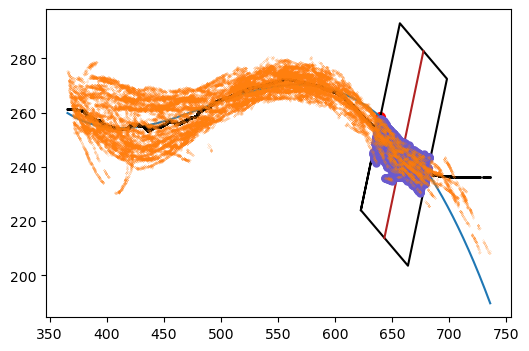

Window number 13
A and B: 
661.0219462019453 249.47642575547957 699.7715715597783 224.56061087945872


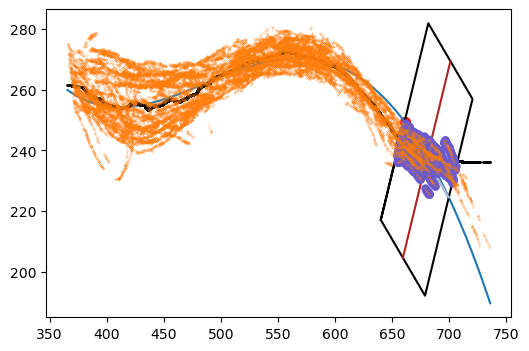

Window number 14
A and B: 
681.1006239686235 238.02117103084947 717.1829710991487 209.35101728321752


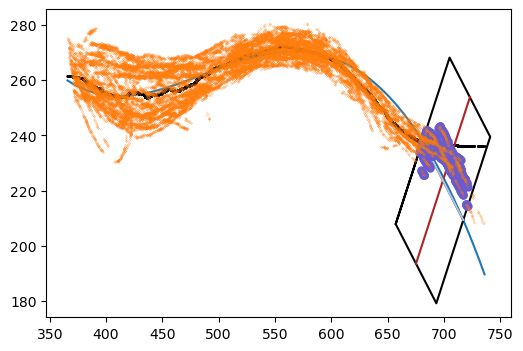

Window number 15
A and B: 
699.7715715597783 224.56061087945872 733.2607315248652 192.8553567954376


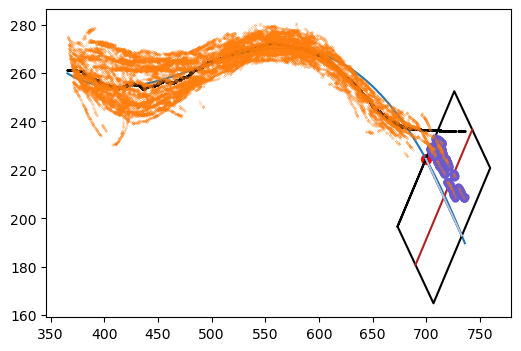

Window number 16
A and B: 
717.1829710991487 209.35101728321752 736.0761918759124 189.71261620271872


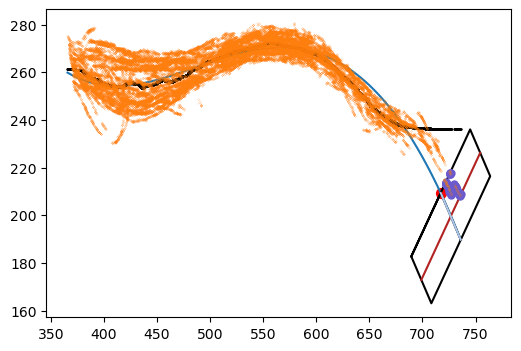

Neurite 2/3


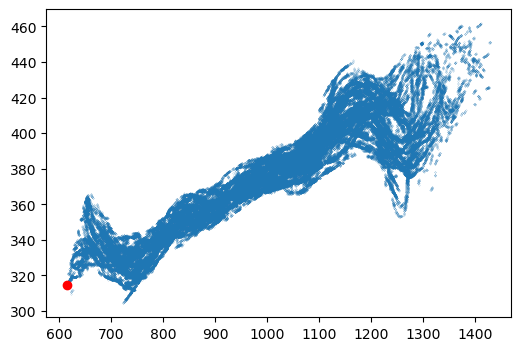

ANGLE
-3.282746930819278


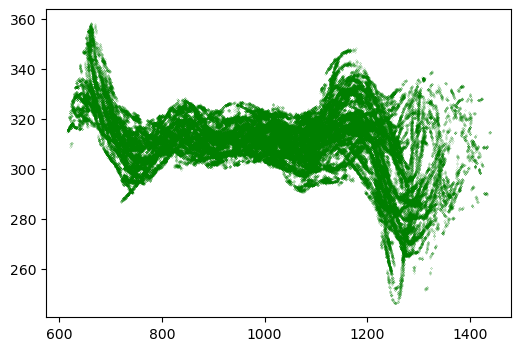

Window number 0
A and B: 
615.81 326.0125860046105 661.2995162122886 328.86128873138534


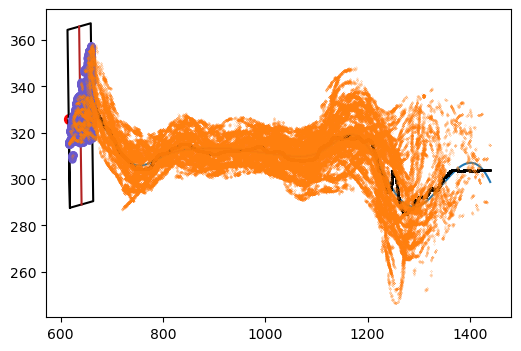

Window number 1
A and B: 
638.2251239306929 330.78922620646745 683.5498230552558 322.9488121121573


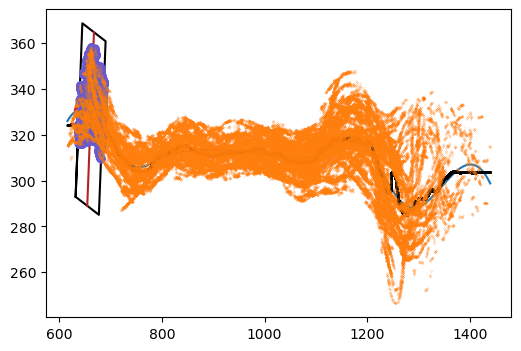

Window number 2
A and B: 
661.2995162122886 328.86128873138534 705.4704957227718 315.6371806413814


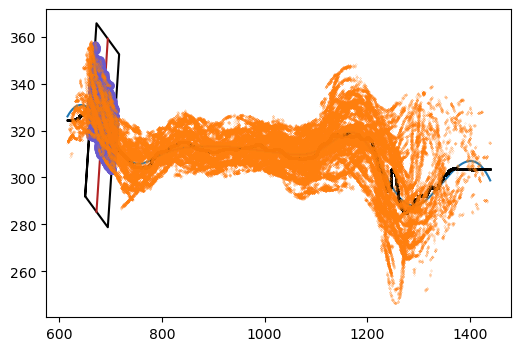

Window number 3
A and B: 
683.5498230552558 322.9488121121573 727.5559854780133 309.1567273668895


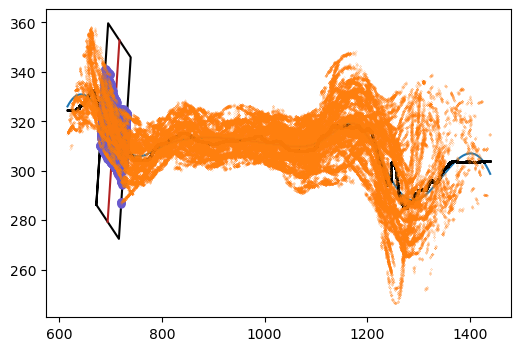

Window number 4
A and B: 
705.4704957227718 315.6371806413814 750.3007435841577 305.9076370993906


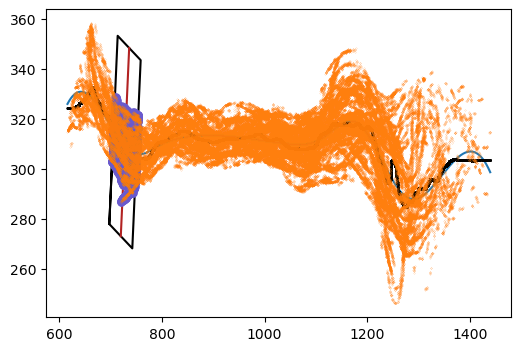

Window number 5
A and B: 
727.5559854780133 309.1567273668895 773.3751358657534 306.90764800375837


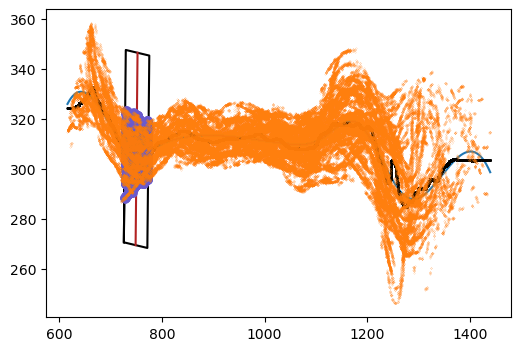

Window number 6
A and B: 
750.3007435841577 305.9076370993906 796.2847110596234 309.55939288056885


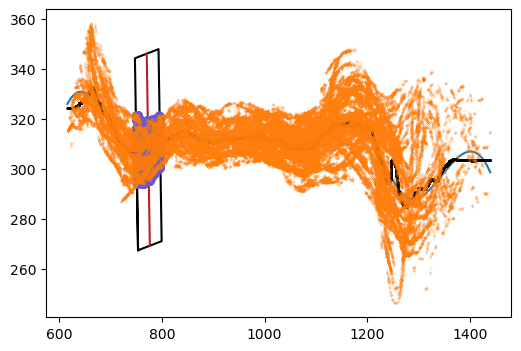

Window number 7
A and B: 
773.3751358657534 306.90764800375837 819.3591033412191 311.51723980503374


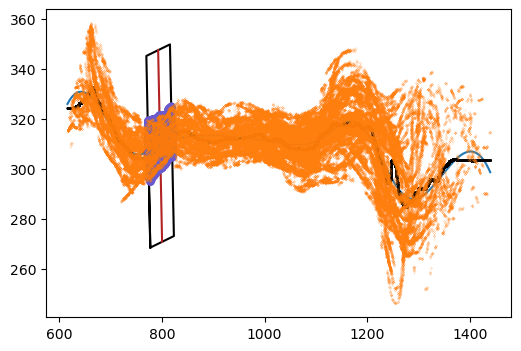

Window number 8
A and B: 
796.2847110596234 309.55939288056885 842.2686785350891 312.6071665846808


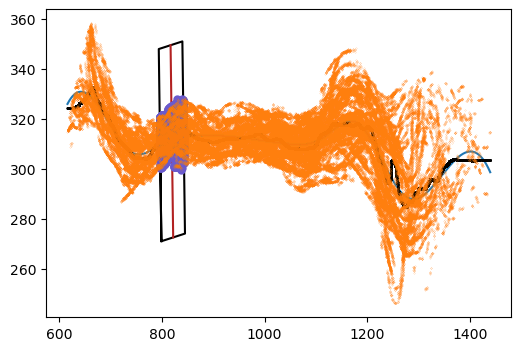

Window number 9
A and B: 
819.3591033412191 311.51723980503374 865.3430708166848 313.17808073735375


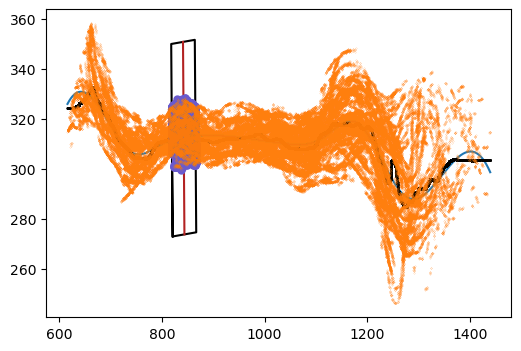

Window number 10
A and B: 
842.2686785350891 312.6071665846808 888.4174630982805 313.3861936262537


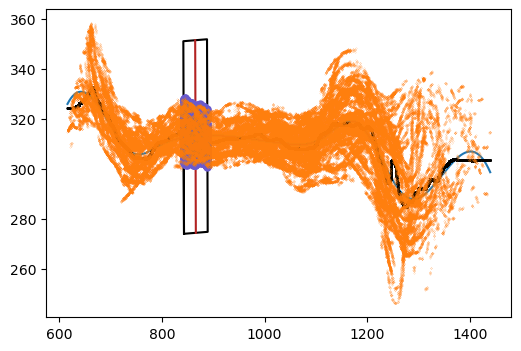

Window number 11
A and B: 
865.3430708166848 313.17808073735375 911.4918553798761 313.294647407663


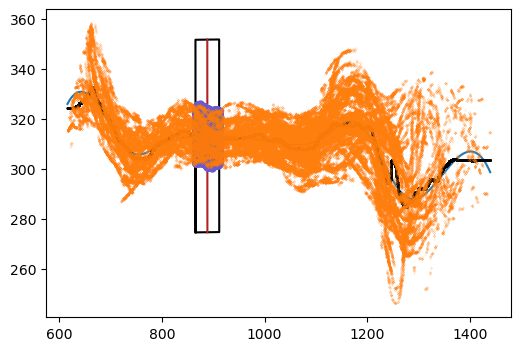

Window number 12
A and B: 
888.4174630982805 313.3861936262537 934.5662476614718 312.9650767677343


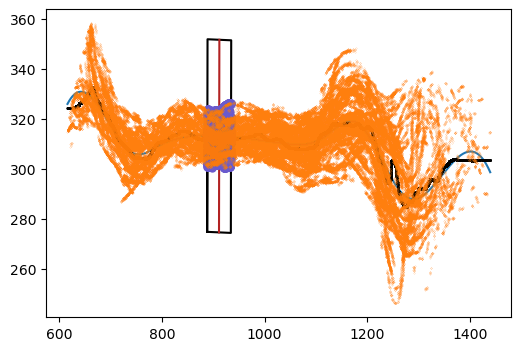

Window number 13
A and B: 
911.4918553798761 313.294647407663 957.6406399430675 312.4591163926202


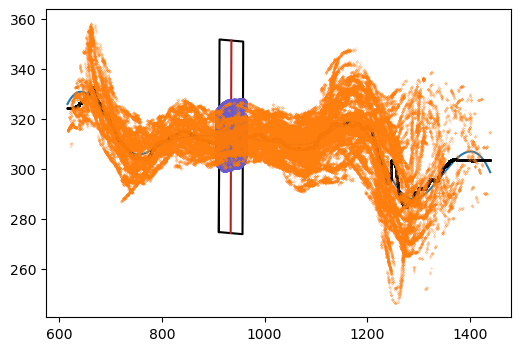

Window number 14
A and B: 
934.5662476614718 312.9650767677343 980.7150322246632 311.8384009684736


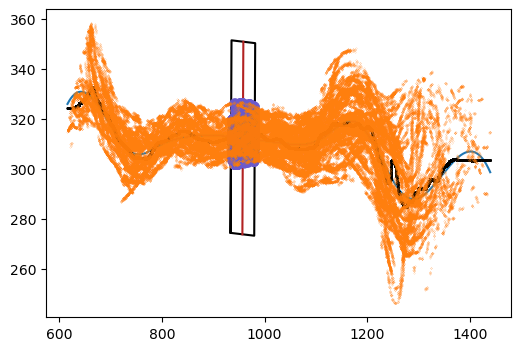

Window number 15
A and B: 
957.6406399430675 312.4591163926202 1003.7894245062589 311.1645651814471


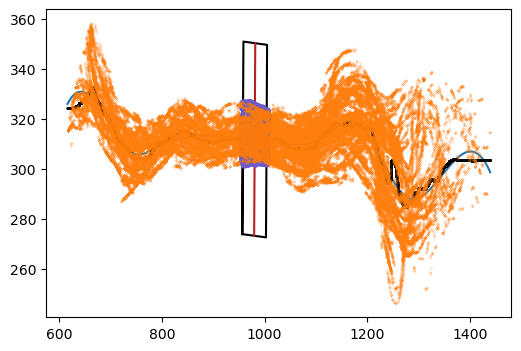

Window number 16
A and B: 
980.7150322246632 311.8384009684736 1026.8638167878546 310.4992437176932


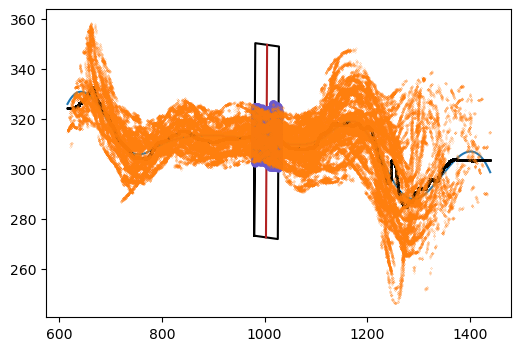

Window number 17
A and B: 
1003.7894245062589 311.1645651814471 1049.9382090694503 309.9169498303778


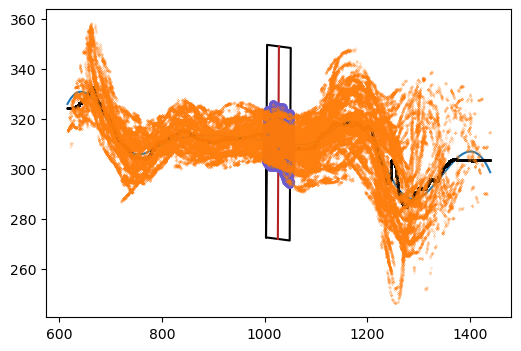

Window number 18
A and B: 
1026.8638167878546 310.4992437176932 1073.012601351046 309.77316550068525


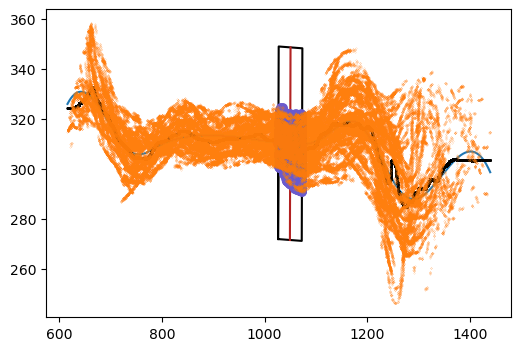

Window number 19
A and B: 
1049.9382090694503 309.9169498303778 1096.0869936326417 310.69612773161066


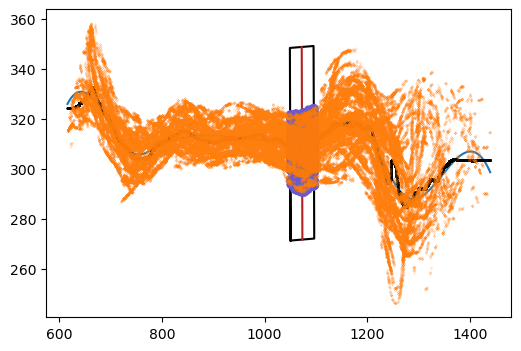

Window number 20
A and B: 
1073.012601351046 309.77316550068525 1118.9965688265117 313.2770297834852


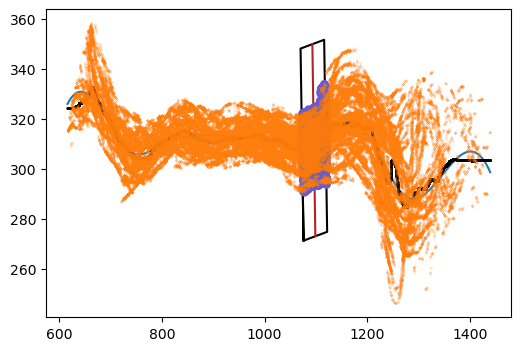

Window number 21
A and B: 
1096.0869936326417 310.69612773161066 1141.9061440203818 316.9010625296354


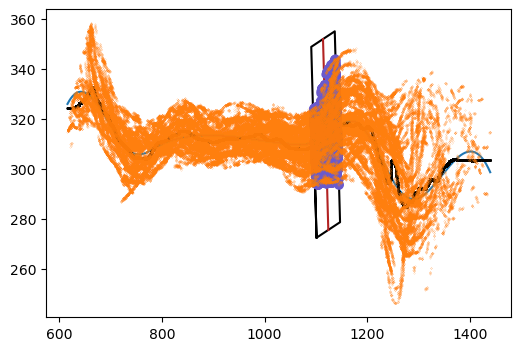

Window number 22
A and B: 
1118.9965688265117 313.2770297834852 1164.8157192142517 319.1122711491412


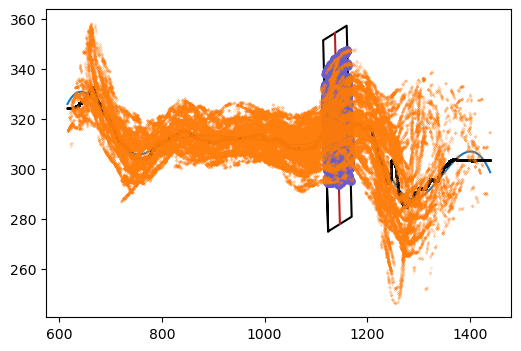

Window number 23
A and B: 
1141.9061440203818 316.9010625296354 1187.7252944081217 317.31461132932947


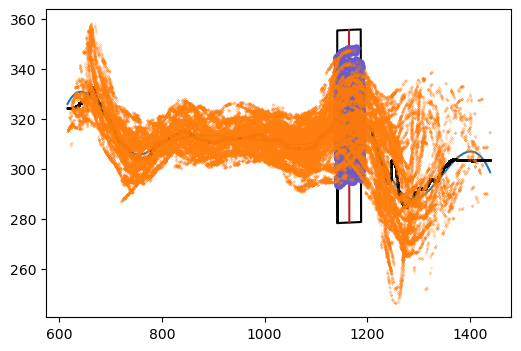

Window number 24
A and B: 
1164.8157192142517 319.1122711491412 1209.8107841633632 310.9237041375359


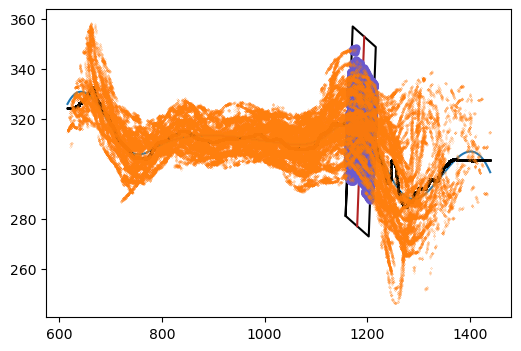

Window number 25
A and B: 
1187.7252944081217 317.31461132932947 1231.4018226554278 302.49128118573856


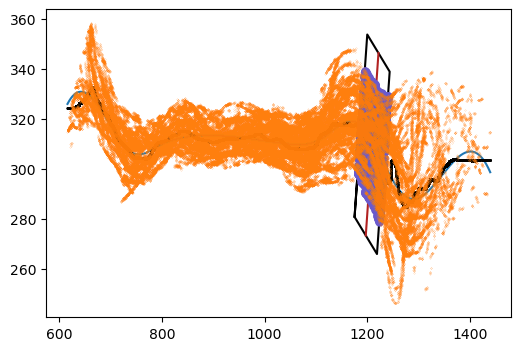

Window number 26
A and B: 
1209.8107841633632 310.9237041375359 1252.9928611474925 294.4369012687725


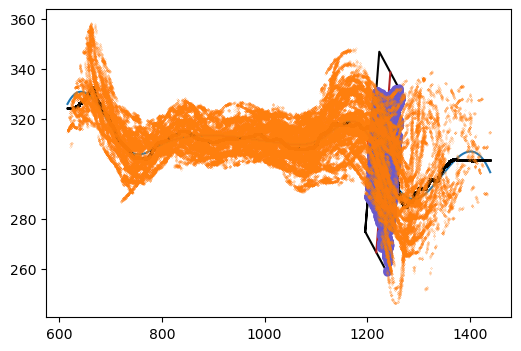

Window number 27
A and B: 
1231.4018226554278 302.49128118573856 1275.4079850781854 289.0609220736484


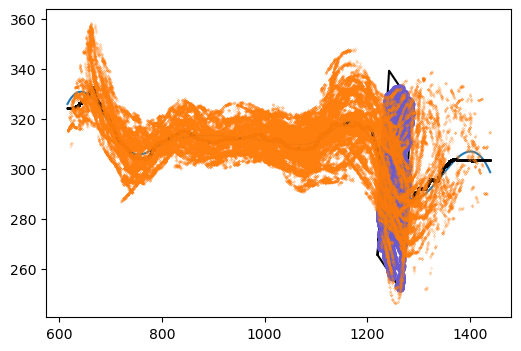

Window number 28
A and B: 
1252.9928611474925 294.4369012687725 1298.482377359781 288.34136533163354


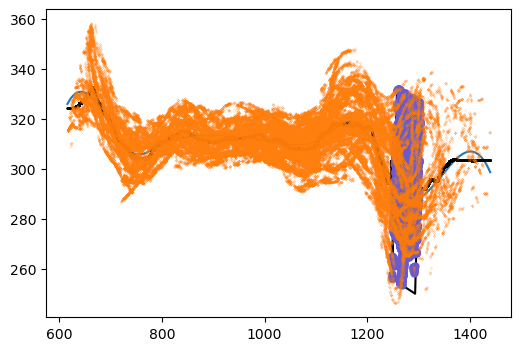

Window number 29
A and B: 
1275.4079850781854 289.0609220736484 1321.2271354659254 291.66671403080613


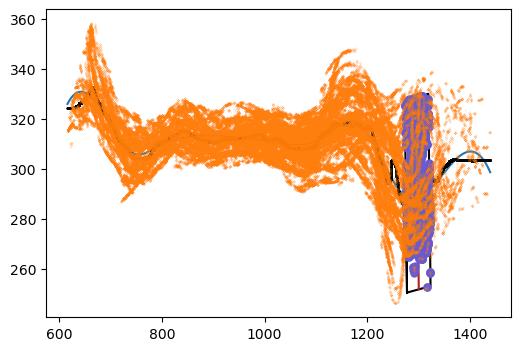

Window number 30
A and B: 
1298.482377359781 288.34136533163354 1343.6422593966183 296.99456485605583


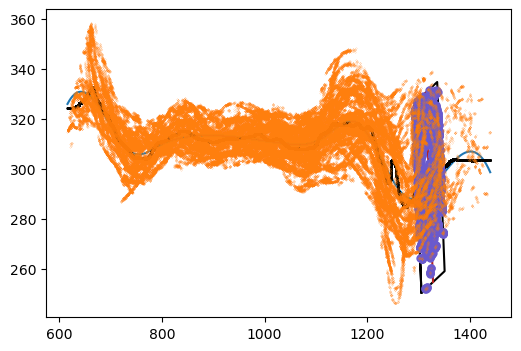

Window number 31
A and B: 
1321.2271354659254 291.66671403080613 1366.0573833273113 302.49377918056655


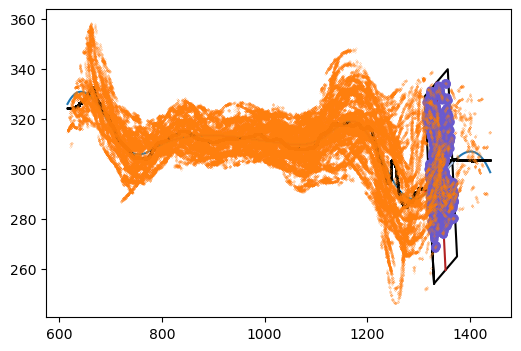

Window number 32
A and B: 
1343.6422593966183 296.99456485605583 1388.8021414334557 306.34333564294167


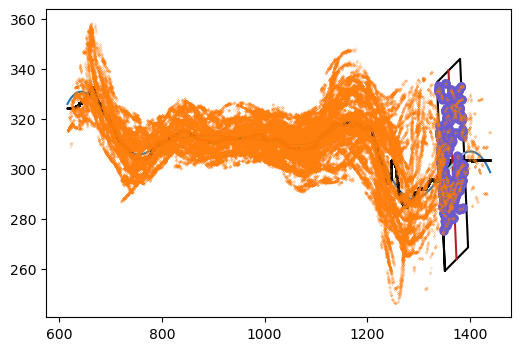

Window number 33
A and B: 
1366.0573833273113 302.49377918056655 1411.8765337150512 306.48677478975173


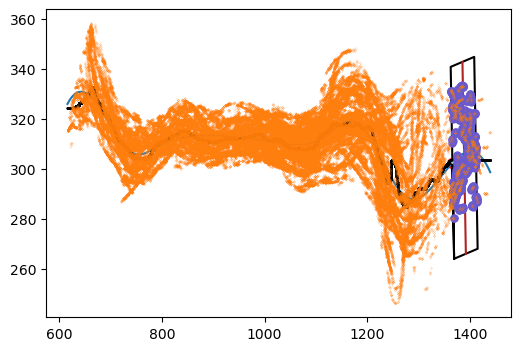

Window number 34
A and B: 
1388.8021414334557 306.34333564294167 1434.2916576457442 301.0877445864028


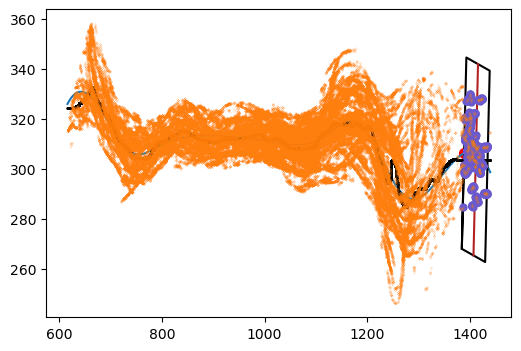

Window number 35
A and B: 
1411.8765337150512 306.48677478975173 1439.7306215406918 298.7429740389174


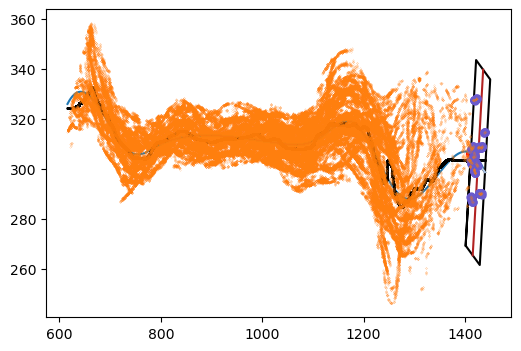

Window number 36
ALL DONE
Saving the data frame for DoM reconstruction
number of localisations toward soma 28618
number of localisations away from soma 27666
Ratio in over total 0.51
Results_PLUSIN_w.csv
Results_PLUSOUT_w.csv
Saving the whole data frame
S01_C04_R01
F:\PERSONAL\Malina\NanoscopeII\mP_LastRound\Analysis\2024-04-09_Motor_PAINT_Neurons_DIV1_Analysis\S01_C04_R01
[(633.1671602032568, 313.8775317454566)]
Warning. No corresponding stage found for 'F:\PERSONAL\Malina\NanoscopeII\mP_LastRound\Analysis\2024-04-09_Motor_PAINT_Neurons_DIV1_Analysis\S01_C04_R01_1_S01_C04'. Proceeding anyways.
Neurite 1/5


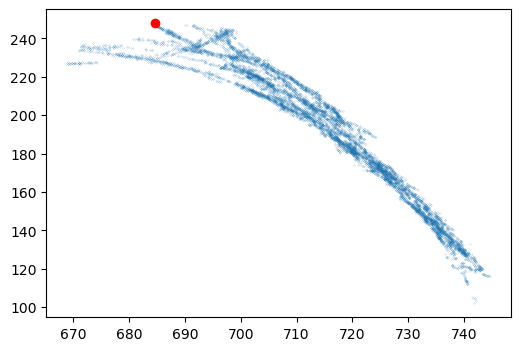

ANGLE
2.2980000470931388


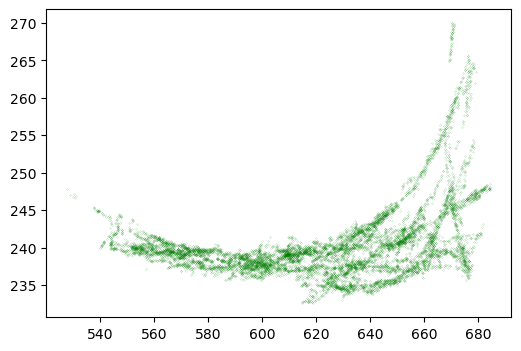

REVERSE
Window number 0
A and B: 
684.56 246.4857842210615 639.0062142568008 239.37453540927476


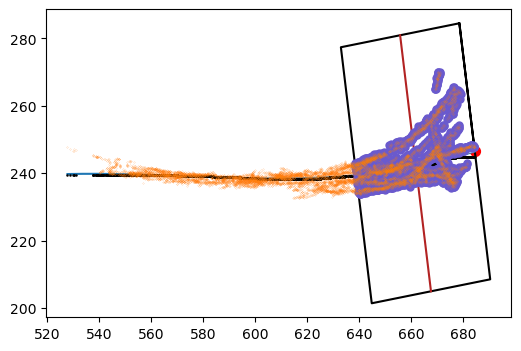

Window number 1
A and B: 
661.9397570105984 241.89527442049143 615.9786815736843 238.44967885824775


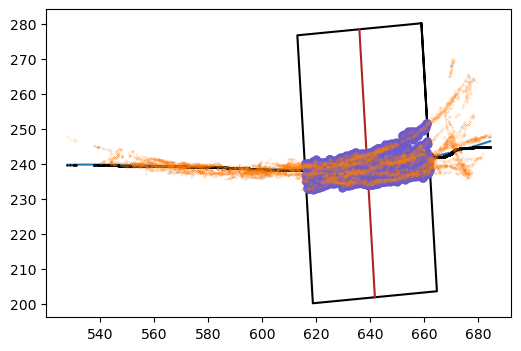

Window number 2
A and B: 
639.0062142568008 239.37453540927476 592.8884889376886 238.57611192929318


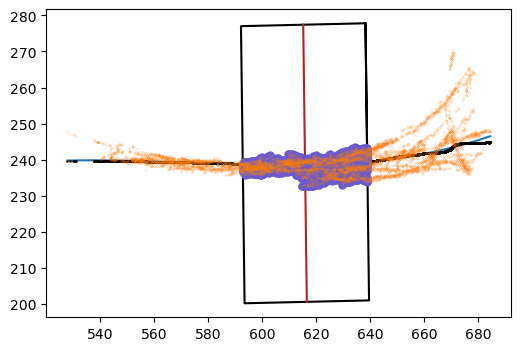

Window number 3
A and B: 
615.9786815736843 238.44967885824775 569.8296262781325 239.19255931118946


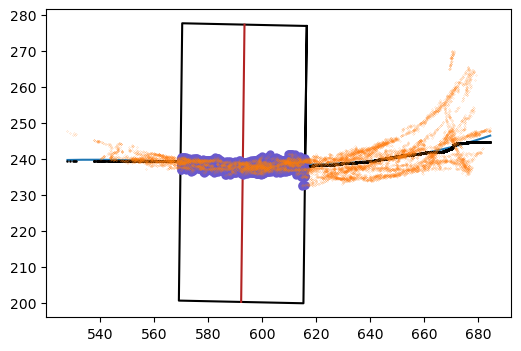

Window number 4
A and B: 
592.8884889376886 238.57611192929318 546.7394336421368 239.73651529751336


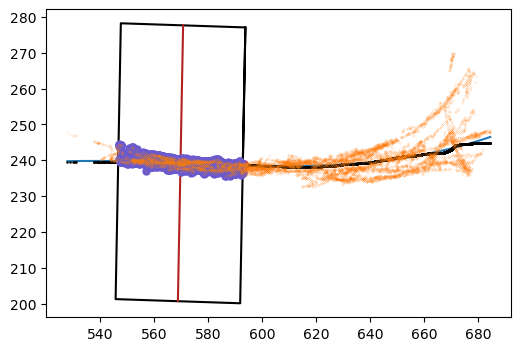

Window number 5
A and B: 
569.8296262781325 239.19255931118946 527.9414477783682 239.7341149413532


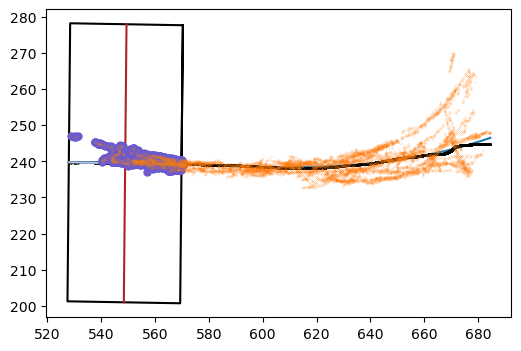

Window number 6
A and B: 
546.7394336421368 239.73651529751336 527.9414477783682 239.7341149413532


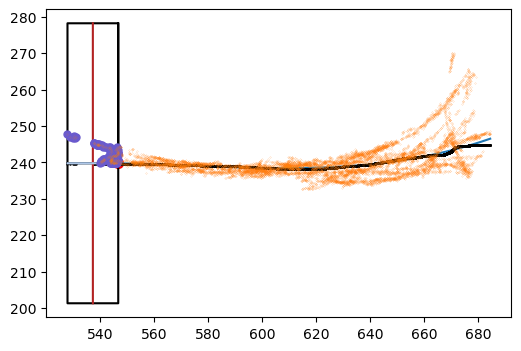

Neurite 2/5


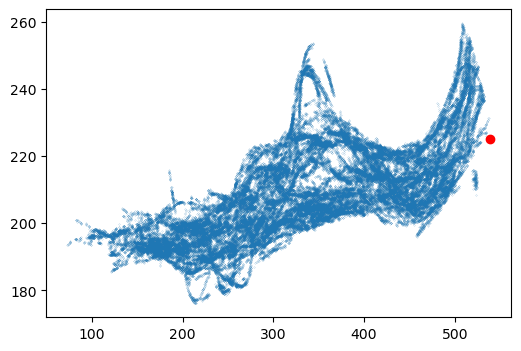

ANGLE
2.3424260111888753


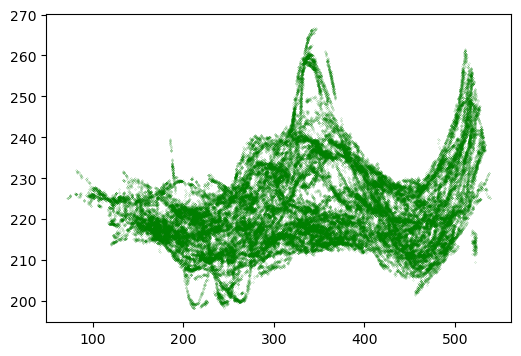

REVERSE
Window number 0
A and B: 
539.07 242.28096280891083 496.6408054289919 224.5468388811785


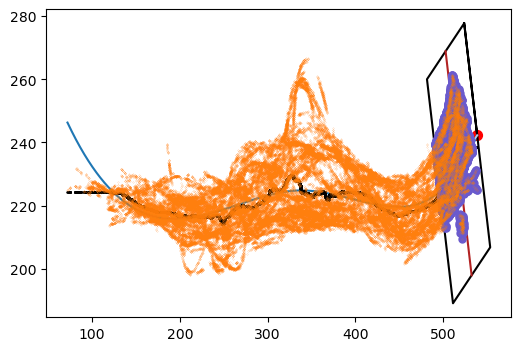

Window number 1
A and B: 
518.6030537201525 231.7241270978181 473.93090613217475 220.72066257464365


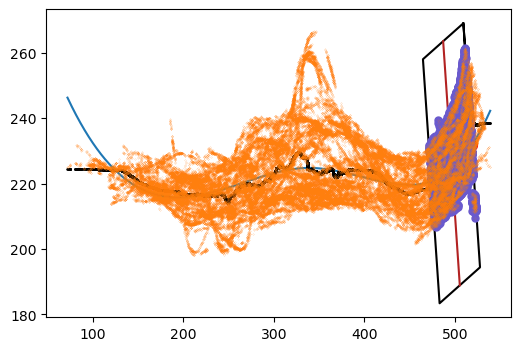

Window number 2
A and B: 
496.6408054289919 224.5468388811785 450.8471813325293 219.57687170113903


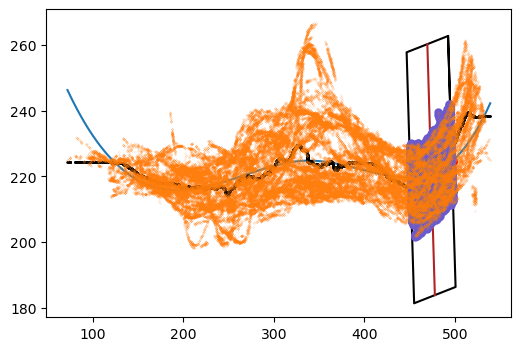

Window number 3
A and B: 
473.93090613217475 220.72066257464365 427.85691290859097 220.1704251248712


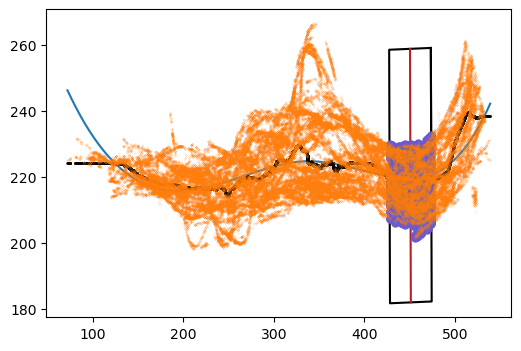

Window number 4
A and B: 
450.8471813325293 219.57687170113903 404.7731881089456 221.5580844538849


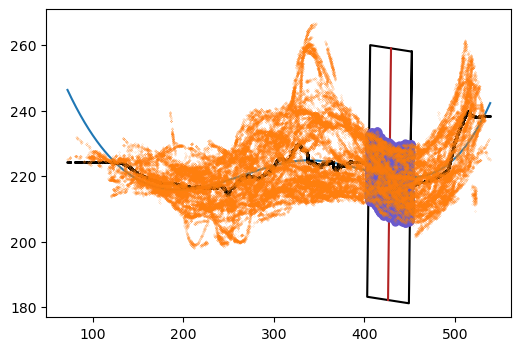

Window number 5
A and B: 
427.85691290859097 220.1704251248712 381.78291968500724 223.12781335305405


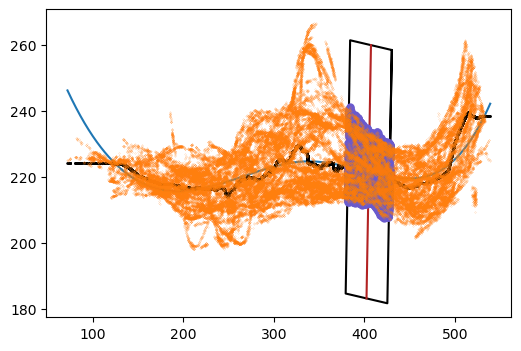

Window number 6
A and B: 
404.7731881089456 221.5580844538849 358.69919488536186 224.38088072235828


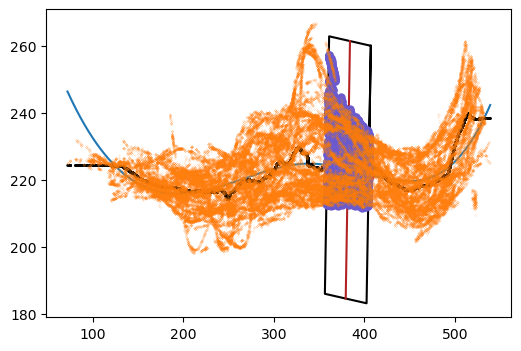

Window number 7
A and B: 
381.78291968500724 223.12781335305405 335.6154700857164 224.79772210440788


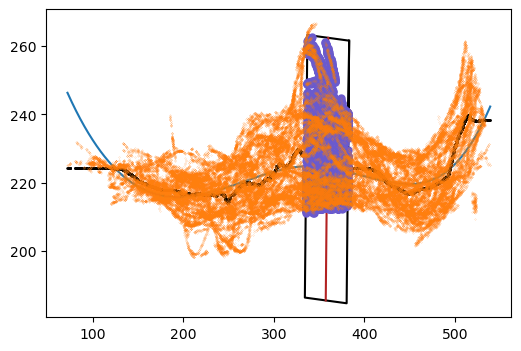

Window number 8
A and B: 
358.69919488536186 224.38088072235828 312.6252016617781 224.03884677450543


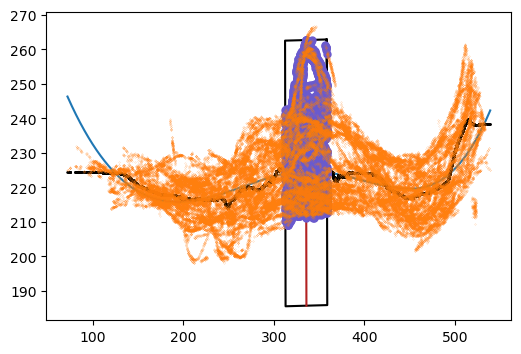

Window number 9
A and B: 
335.6154700857164 224.79772210440788 289.54147686213264 222.3898481170846


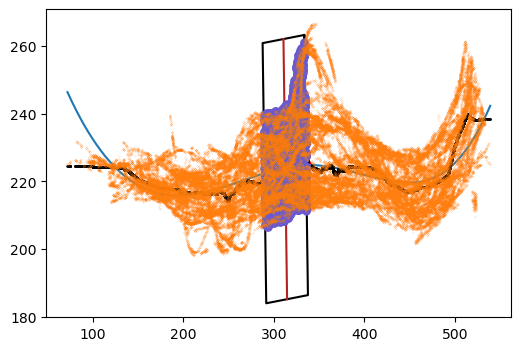

Window number 10
A and B: 
312.6252016617781 224.03884677450543 266.55120843819435 220.3043553885069


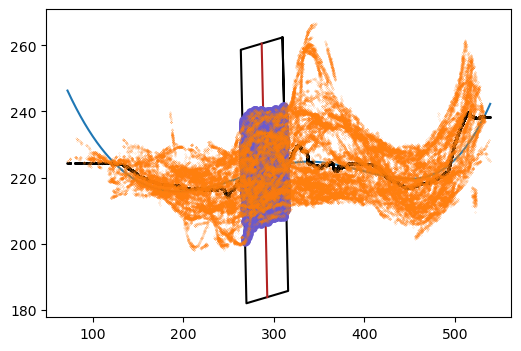

Window number 11
A and B: 
289.54147686213264 222.3898481170846 243.65439638996307 218.22387963884367


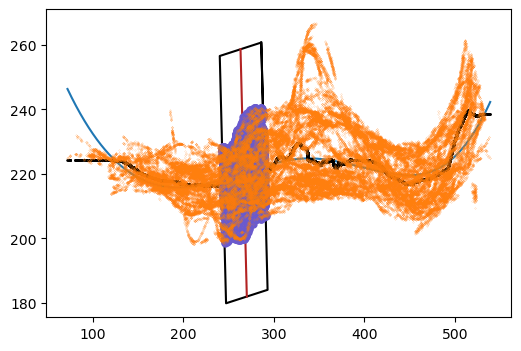

Window number 12
A and B: 
266.55120843819435 220.3043553885069 220.57067159031766 216.56349753897717


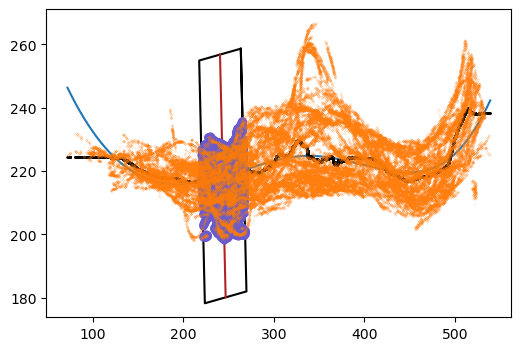

Window number 13
A and B: 
243.65439638996307 218.22387963884367 197.48694679067225 215.7849327724656


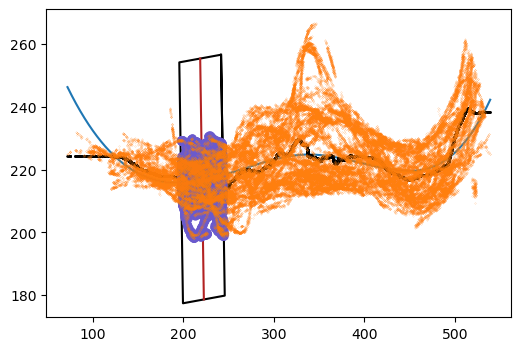

Window number 14
A and B: 
220.57067159031766 216.56349753897717 174.49667836673393 216.32686229892266


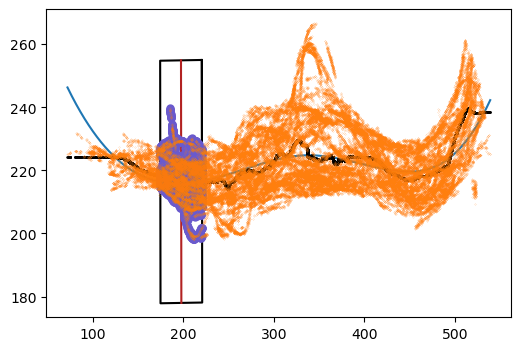

Window number 15
A and B: 
197.48694679067225 215.7849327724656 151.50640994279559 218.62284592417825


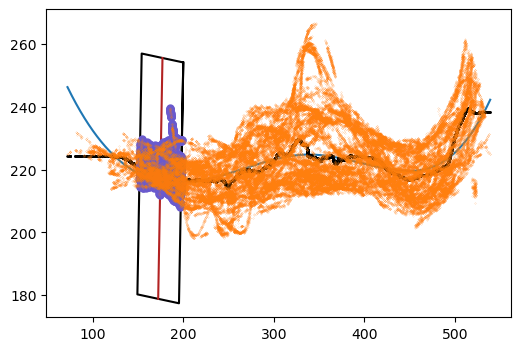

Window number 16
A and B: 
174.49667836673393 216.32686229892266 128.8899670216855 223.01882532665712


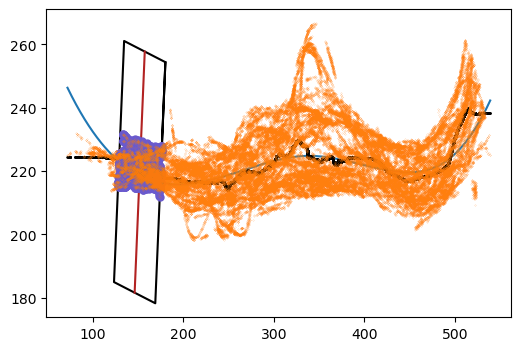

Window number 17
A and B: 
151.50640994279559 218.62284592417825 106.83426235481781 229.74865470734287


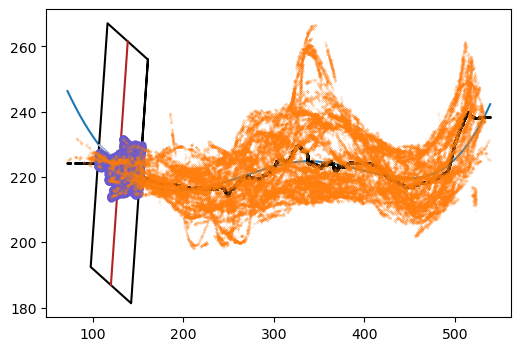

Window number 18
A and B: 
128.8899670216855 223.01882532665712 85.61966506931374 238.86178036738897


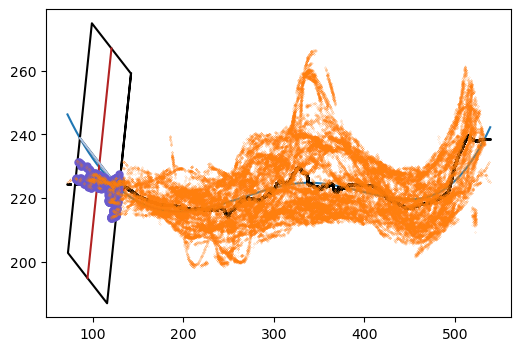

Window number 19
A and B: 
106.83426235481781 229.74865470734287 71.88157784037497 246.30892455931456


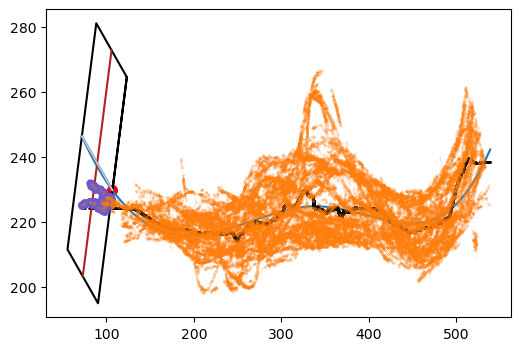

Window number 20
A and B: 
85.61966506931374 238.86178036738897 71.88157784037497 246.30892455931456


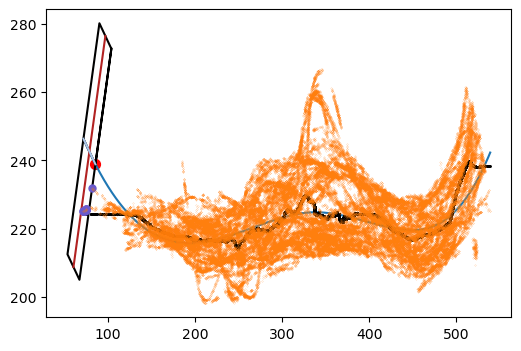

Neurite 3/5


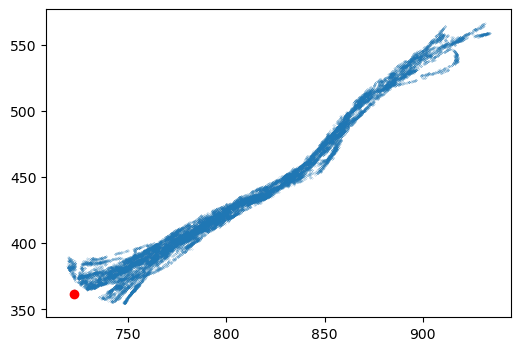

ANGLE
0.7898869915871545


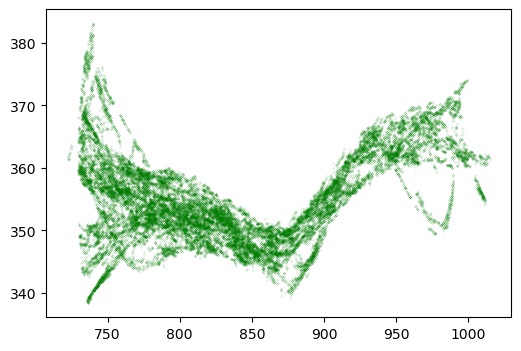

Window number 0
A and B: 
722.16 363.65640811019756 767.5337091694414 355.1891242063137


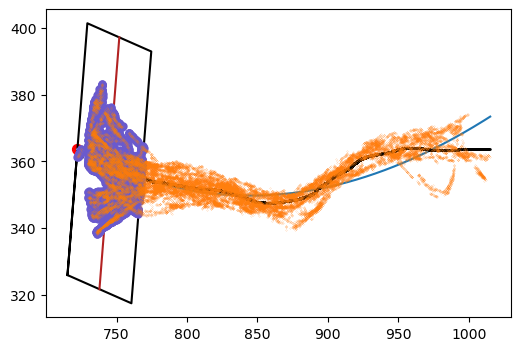

Window number 1
A and B: 
744.7296098581846 358.94085398906236 790.3964308439663 352.42586237757814


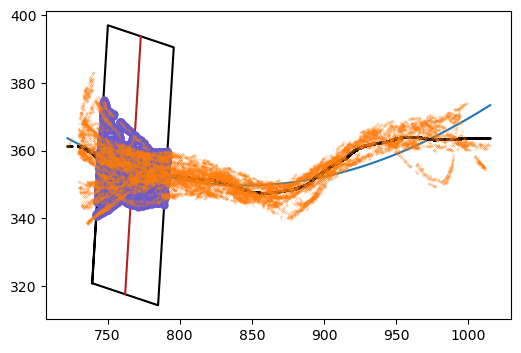

Window number 2
A and B: 
767.5337091694414 355.1891242063137 813.4350196082951 350.6279584393225


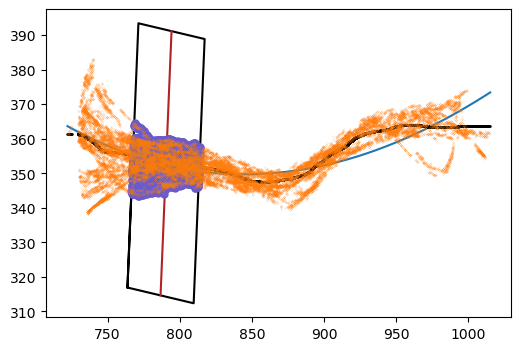

Window number 3
A and B: 
790.3964308439663 352.42586237757814 836.4736083726239 349.79593066523313


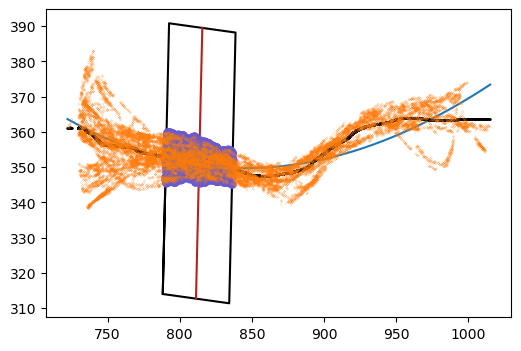

Window number 4
A and B: 
813.4350196082951 350.6279584393225 859.5708195002208 349.90665652693696


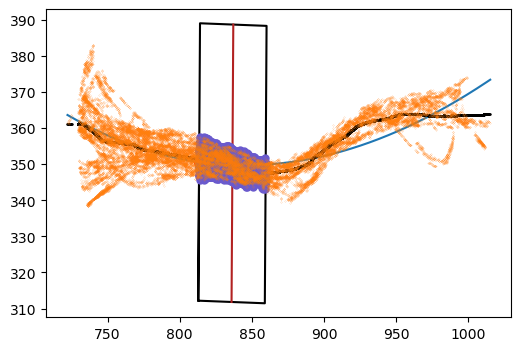

Window number 5
A and B: 
836.4736083726239 349.79593066523313 882.6094082645495 350.9349415556617


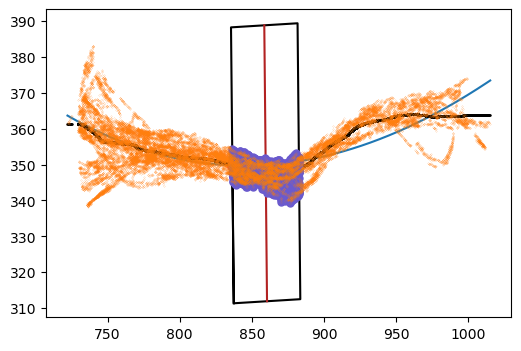

Window number 6
A and B: 
859.5708195002208 349.90665652693696 905.5893746656103 352.84930171754945


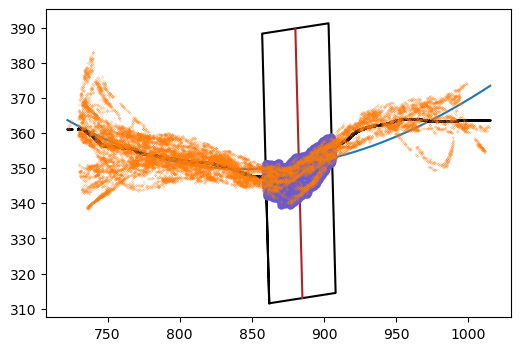

Window number 7
A and B: 
882.6094082645495 350.9349415556617 928.5107187034032 355.6186446241571


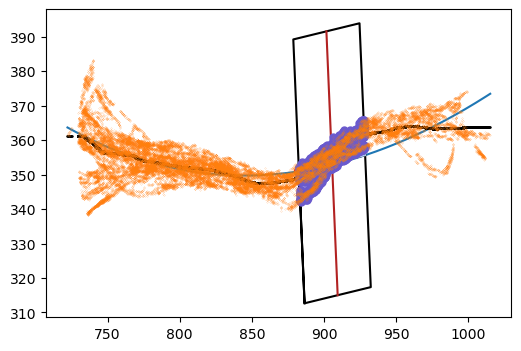

Window number 8
A and B: 
905.5893746656103 352.84930171754945 951.3148180146599 359.20201145826377


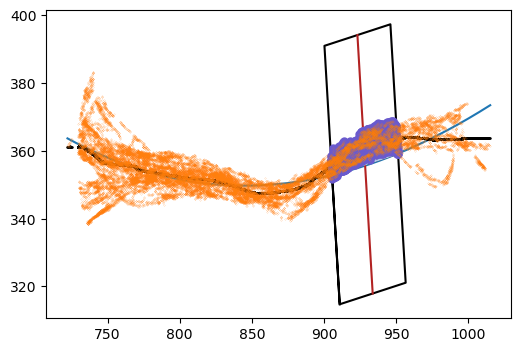

Window number 9
A and B: 
928.5107187034032 355.6186446241571 974.0016725993806 363.56300703353133


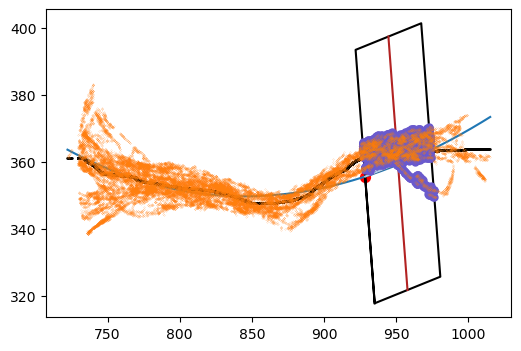

Window number 10
A and B: 
951.3148180146599 359.20201145826377 996.5126600942974 368.65180892779114


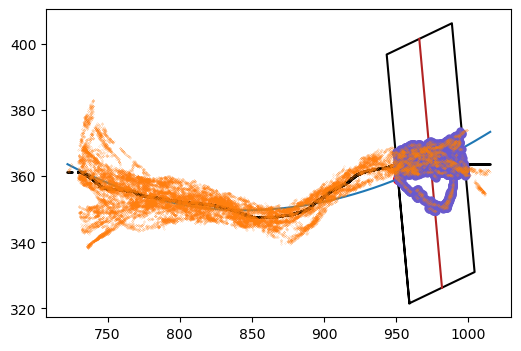

Window number 11
A and B: 
974.0016725993806 363.56300703353133 1015.2131939767933 373.4396190569787


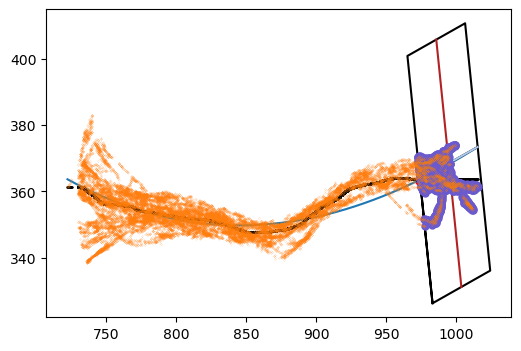

Window number 12
A and B: 
996.5126600942974 368.65180892779114 1015.2131939767933 373.4396190569787


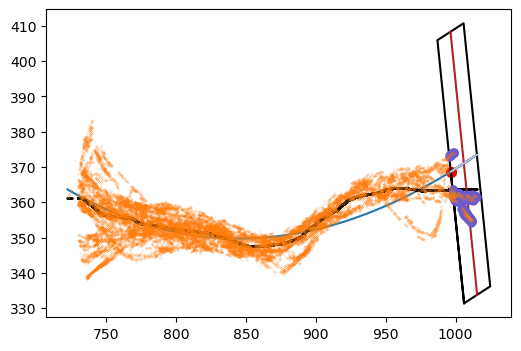

Neurite 4/5


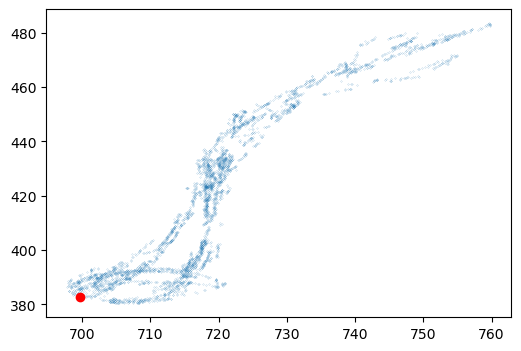

ANGLE
-175.93094687861682


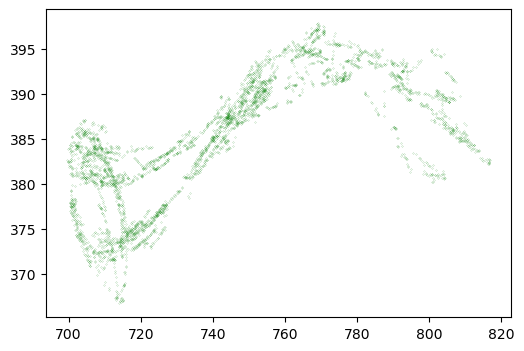

Window number 0
A and B: 
699.67 380.22194783273346 745.4176957059195 386.2838128052418


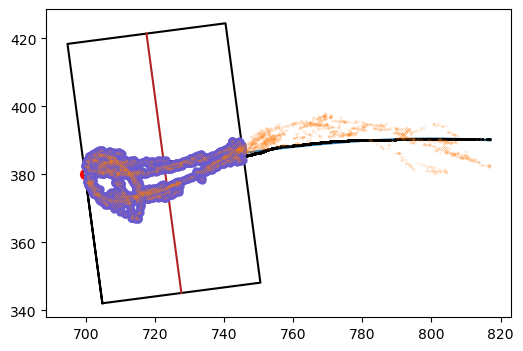

Window number 1
A and B: 
722.5555840499084 383.19420554678965 768.3502245436226 388.88903163704634


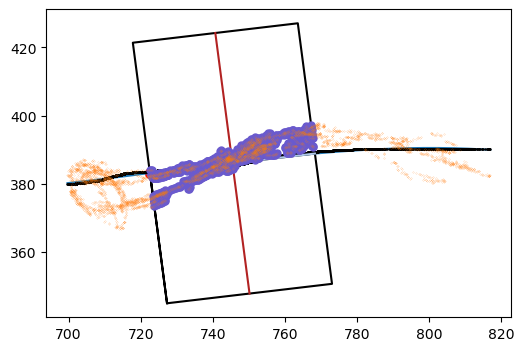

Window number 2
A and B: 
745.4176957059195 386.2838128052418 791.3766429569151 390.3864107383818


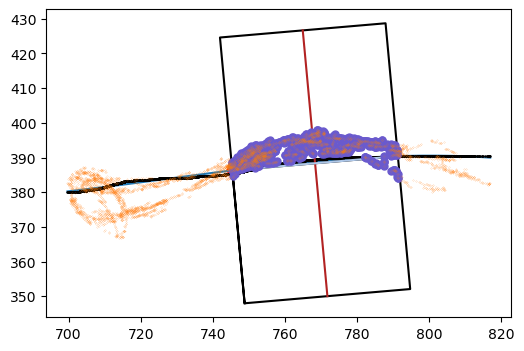

Window number 3
A and B: 
768.3502245436226 388.88903163704634 814.4500061580023 390.13673485531734


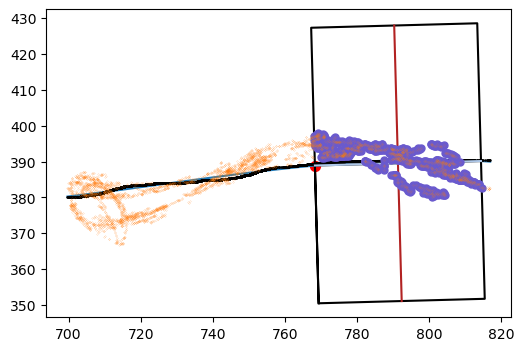

Window number 4
A and B: 
791.3766429569151 390.3864107383818 817.0084970928126 389.9739510724983


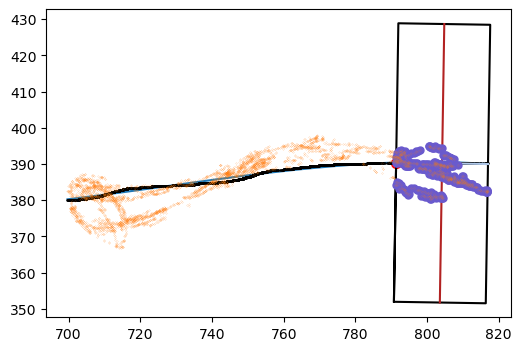

ALL DONE
Saving the data frame for DoM reconstruction
number of localisations toward soma 20502
number of localisations away from soma 25684
Ratio in over total 0.44
Results_PLUSIN_w.csv
Results_PLUSOUT_w.csv
Saving the whole data frame
S02_C03_R01
F:\PERSONAL\Malina\NanoscopeII\mP_LastRound\Analysis\2024-04-09_Motor_PAINT_Neurons_DIV1_Analysis\S02_C03_R01
[(364.9614629573207, 501.57131924438477)]
Warning. No corresponding stage found for 'F:\PERSONAL\Malina\NanoscopeII\mP_LastRound\Analysis\2024-04-09_Motor_PAINT_Neurons_DIV1_Analysis\S02_C03_R01_1_S02_C03'. Proceeding anyways.
Neurite 1/2


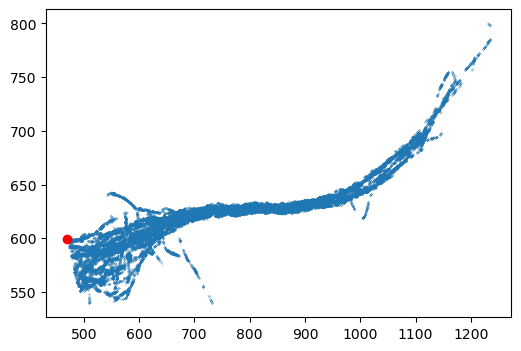

ANGLE
-5.048453694228947


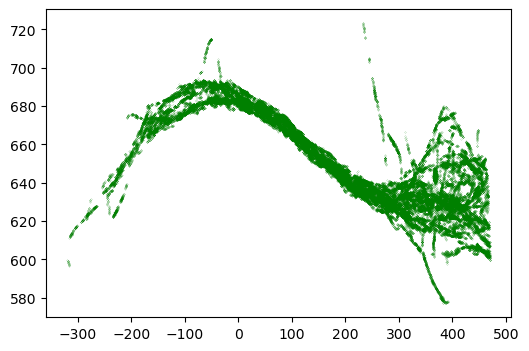

REVERSE
Window number 0
A and B: 
470.51 632.7400553219289 424.37922753331077 630.2546030892679


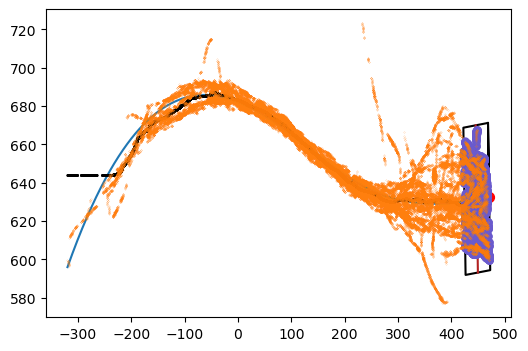

Window number 1
A and B: 
447.4446137666554 631.3618069025073 401.31384129996616 629.4702856517081


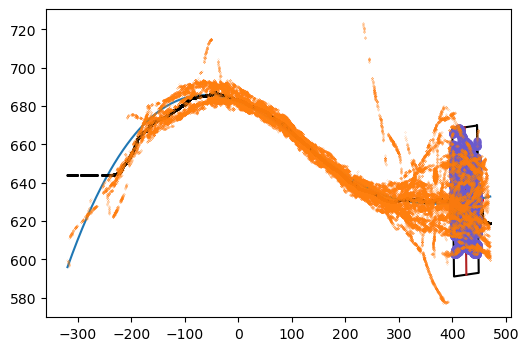

Window number 2
A and B: 
424.37922753331077 630.2546030892679 378.24845506662155 629.0606963593243


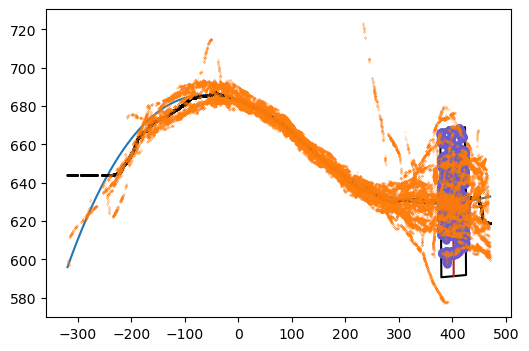

Window number 3
A and B: 
401.31384129996616 629.4702856517081 355.18306883327693 629.0776769816134


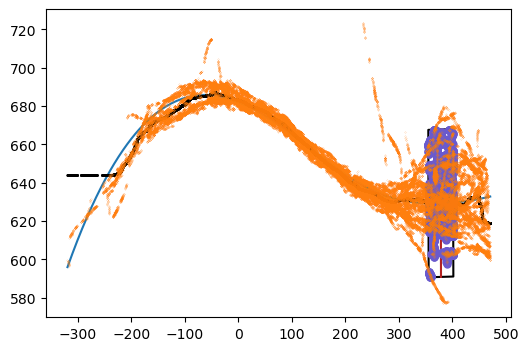

Window number 4
A and B: 
378.24845506662155 629.0606963593243 332.1176825999323 629.5730692880722


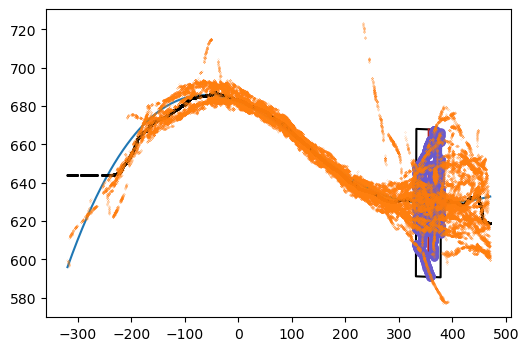

Window number 5
A and B: 
355.18306883327693 629.0776769816134 309.0522963665877 630.5987150481978


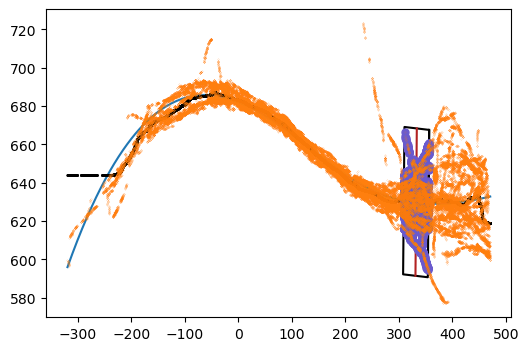

Window number 6
A and B: 
332.1176825999323 629.5730692880722 286.14489223073167 632.1933471371516


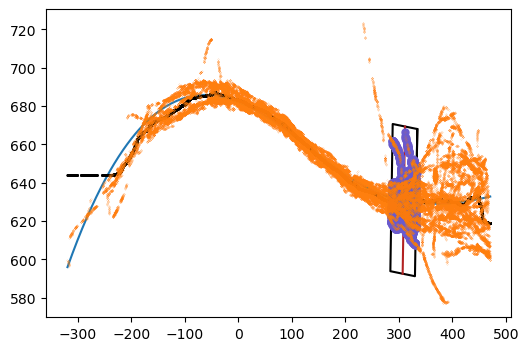

Window number 7
A and B: 
309.0522963665877 630.5987150481978 263.07950599738706 634.4305067546277


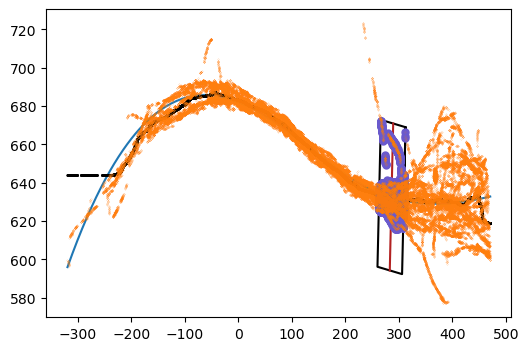

Window number 8
A and B: 
286.14489223073167 632.1933471371516 240.17210186153113 637.3306239491733


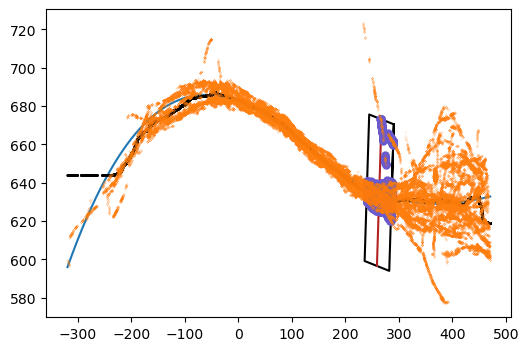

Window number 9
A and B: 
263.07950599738706 634.4305067546277 217.42267982316378 640.9103292404911


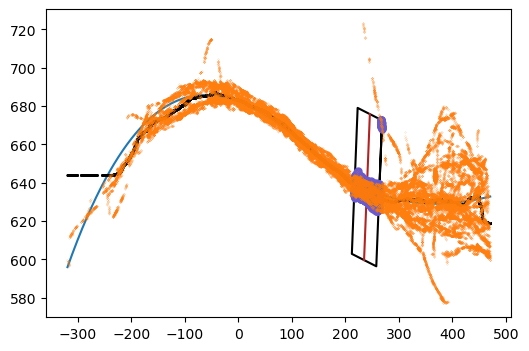

Window number 10
A and B: 
240.17210186153113 637.3306239491733 194.67325778479653 645.0837595697466


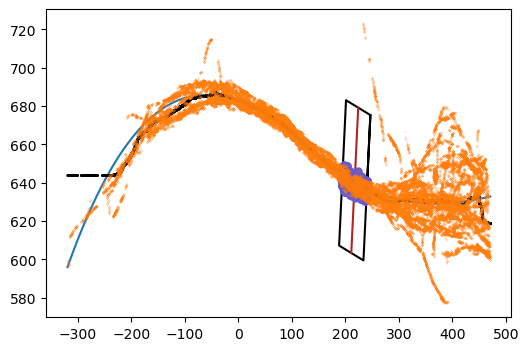

Window number 11
A and B: 
217.42267982316378 640.9103292404911 172.08181784391786 649.6586706700188


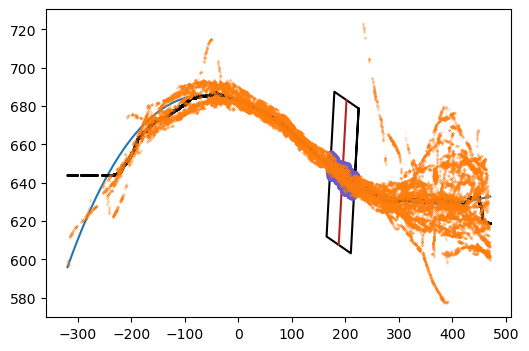

Window number 12
A and B: 
194.67325778479653 645.0837595697466 149.49037790303925 654.5061834736647


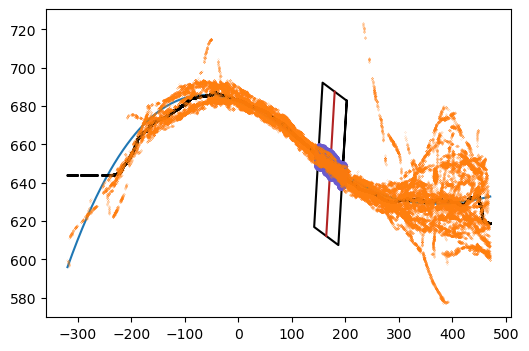

Window number 13
A and B: 
172.08181784391786 649.6586706700188 127.05692005964926 659.4355411269415


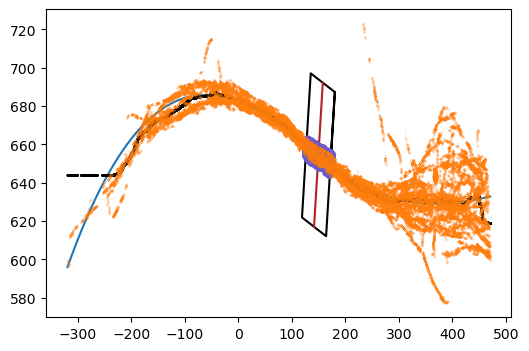

Window number 14
A and B: 
149.49037790303925 654.5061834736647 104.46548011877059 664.3610812877868


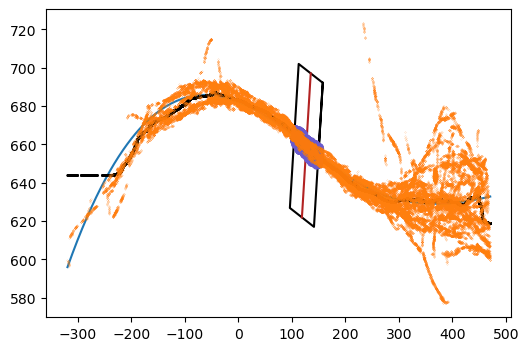

Window number 15
A and B: 
127.05692005964926 659.4355411269415 81.87404017789197 669.0923208826579


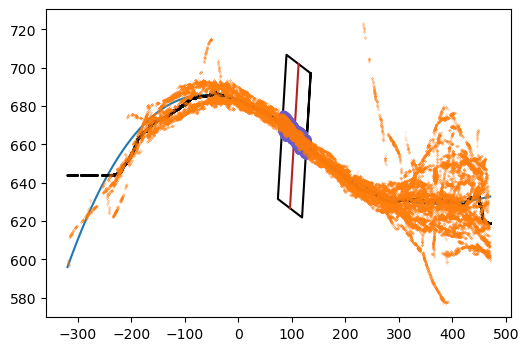

Window number 16
A and B: 
104.46548011877059 664.3610812877868 59.12461813952467 673.502297305317


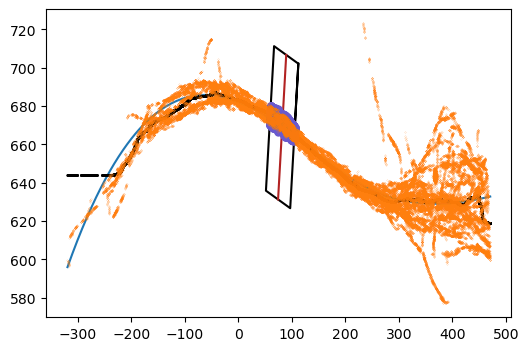

Window number 17
A and B: 
81.87404017789197 669.0923208826579 36.533178198646 677.3755272706879


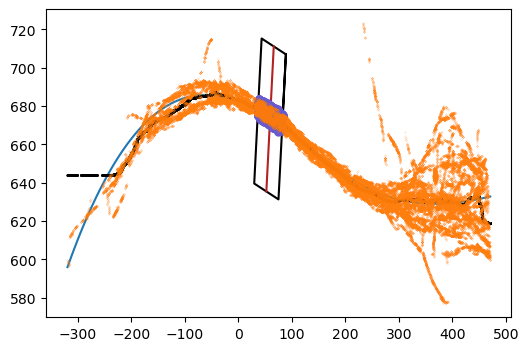

Window number 18
A and B: 
59.12461813952467 673.502297305317 13.625774062790072 680.6664470717947


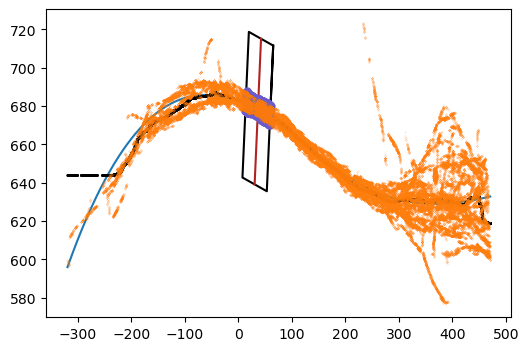

Window number 19
A and B: 
36.533178198646 677.3755272706879 -9.281630073065912 683.2194944219412


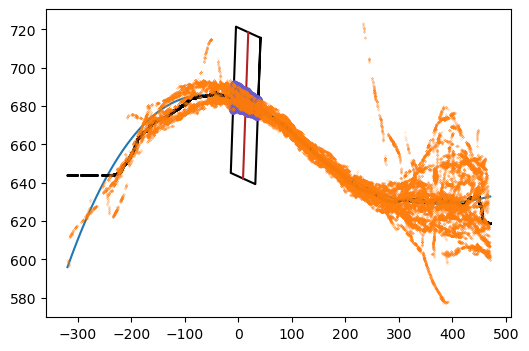

Window number 20
A and B: 
13.625774062790072 680.6664470717947 -32.347016306410524 684.9465069997983


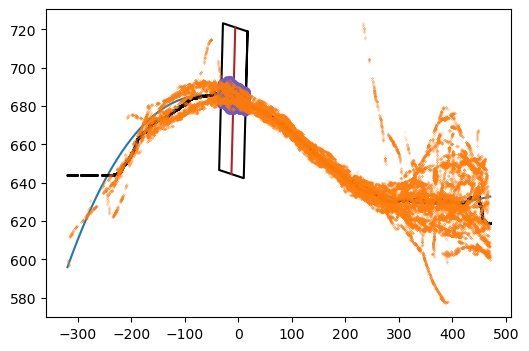

Window number 21
A and B: 
-9.281630073065912 683.2194944219412 -55.412402539755135 685.7282966405655


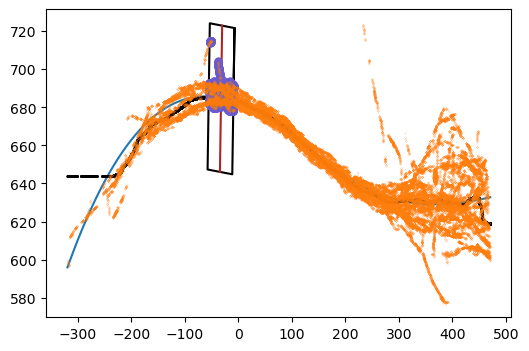

Window number 22
A and B: 
-32.347016306410524 684.9465069997983 -78.4777887730998 685.4659556993932


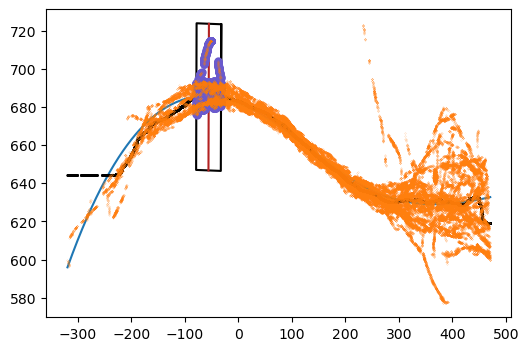

Window number 23
A and B: 
-55.412402539755135 685.7282966405655 -101.54317500644441 684.060576531431


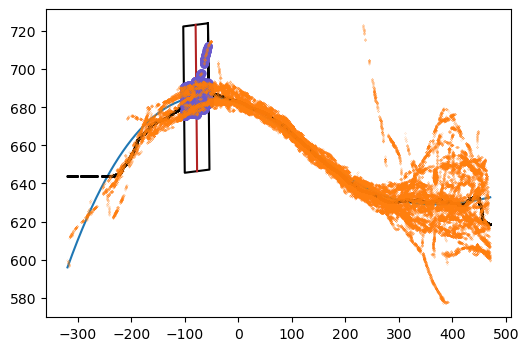

Window number 24
A and B: 
-78.4777887730998 685.4659556993932 -124.45057914230037 681.4358314644288


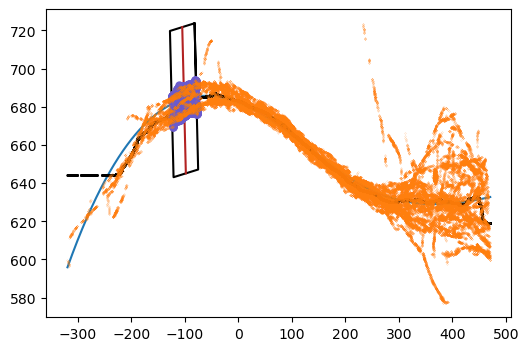

Window number 25
A and B: 
-101.54317500644441 684.060576531431 -147.20000118066767 677.5211713485302


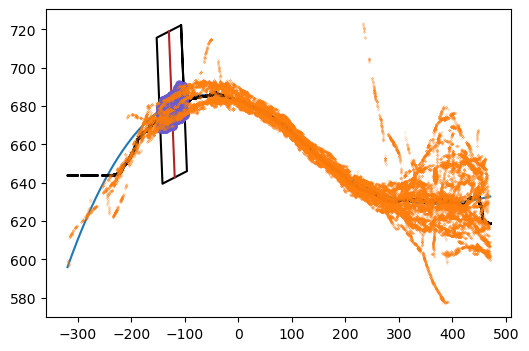

Window number 26
A and B: 
-124.45057914230037 681.4358314644288 -169.63345902405766 672.2917057564958


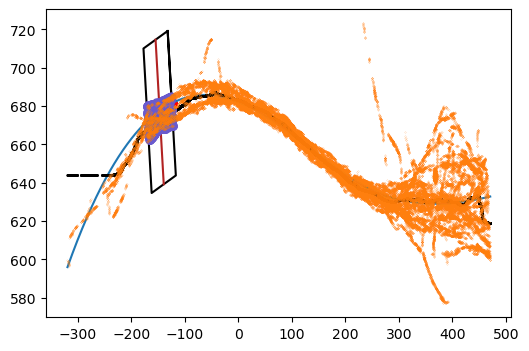

Window number 27
A and B: 
-147.20000118066767 677.5211713485302 -191.7509526724703 665.7157971704833


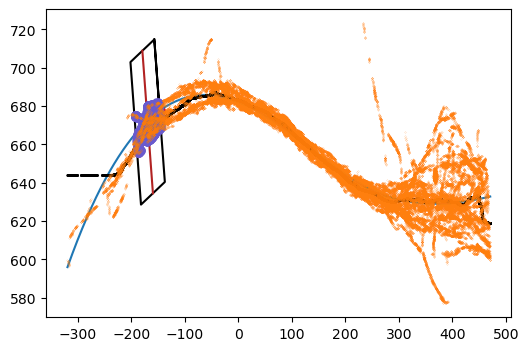

Window number 28
A and B: 
-169.63345902405766 672.2917057564958 -213.39450002841699 657.8315498970393


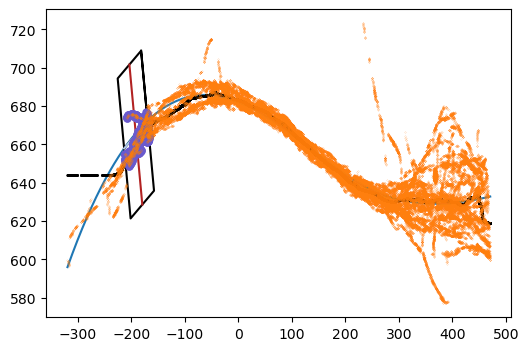

Window number 29
A and B: 
-191.7509526724703 665.7157971704833 -234.56410109189767 648.6540828888917


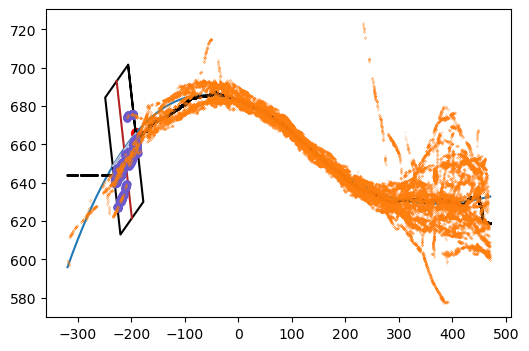

Window number 30
A and B: 
-213.39450002841699 657.8315498970393 -255.25975586291236 638.2068398155074


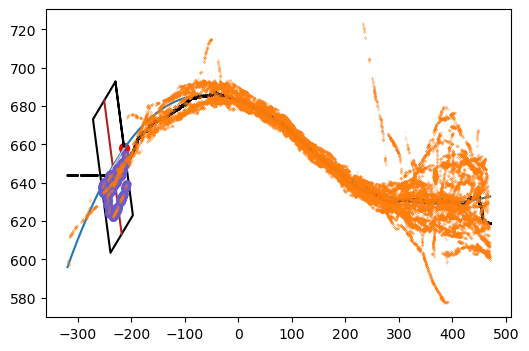

Window number 31
A and B: 
-234.56410109189767 648.6540828888917 -275.16550014648374 626.7151817367467


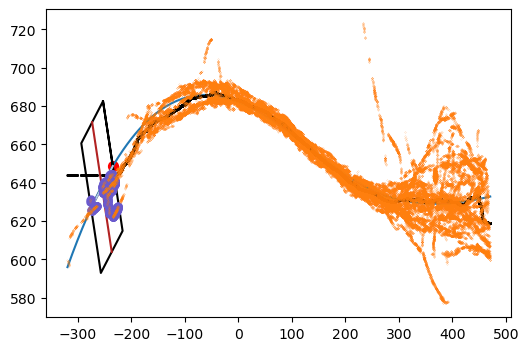

Window number 32
A and B: 
-255.25975586291236 638.2068398155074 -294.5972981375892 614.0705382461146


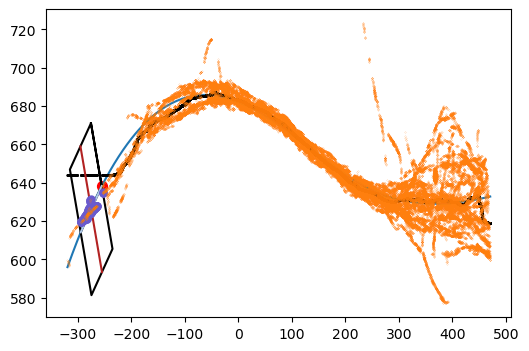

Window number 33
A and B: 
-275.16550014648374 626.7151817367467 -313.23918564125125 600.5599891077568


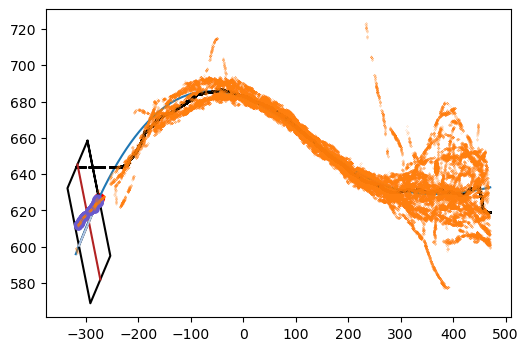

Window number 34
A and B: 
-294.5972981375892 614.0705382461146 -319.2425053458204 595.9127255344395


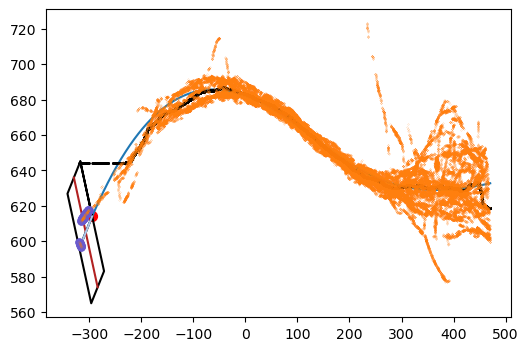

ALL DONE
Saving the data frame for DoM reconstruction
number of localisations toward soma 39323
number of localisations away from soma 34677
Ratio in over total 0.53
Results_PLUSIN_w.csv
Results_PLUSOUT_w.csv
Saving the whole data frame
S02_C04_R01
F:\PERSONAL\Malina\NanoscopeII\mP_LastRound\Analysis\2024-04-09_Motor_PAINT_Neurons_DIV1_Analysis\S02_C04_R01
[(641.2954175380585, 217.44114433987943)]
Warning. No corresponding stage found for 'F:\PERSONAL\Malina\NanoscopeII\mP_LastRound\Analysis\2024-04-09_Motor_PAINT_Neurons_DIV1_Analysis\S02_C04_R01_1_S02_C04'. Proceeding anyways.
Neurite 1/3


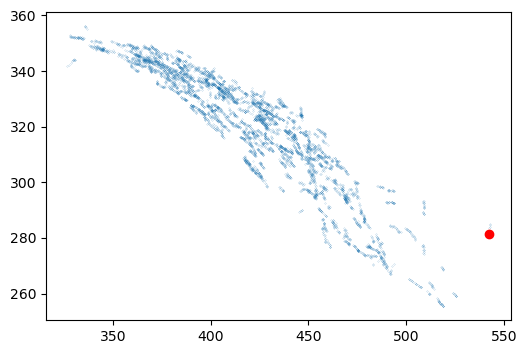

ANGLE
-10.178061609586633


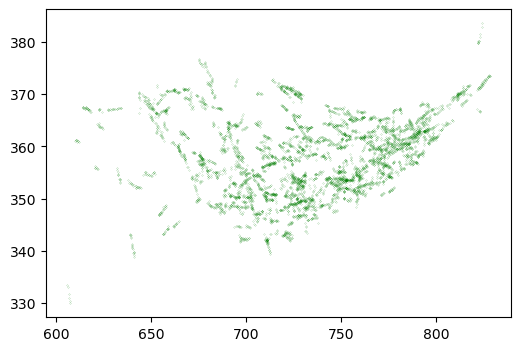

Window number 0
A and B: 
605.8242105036957 359.942159939323 651.8343306511864 356.2396148276064


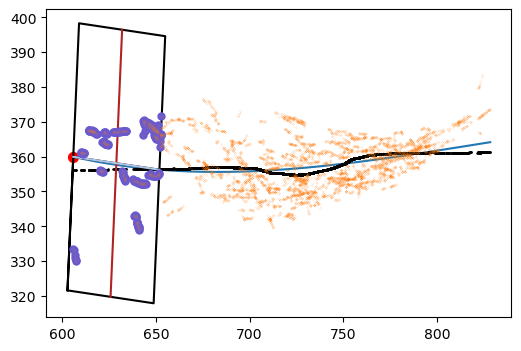

Window number 1
A and B: 
628.7624601416024 357.641504706421 674.9062011607704 355.643232744322


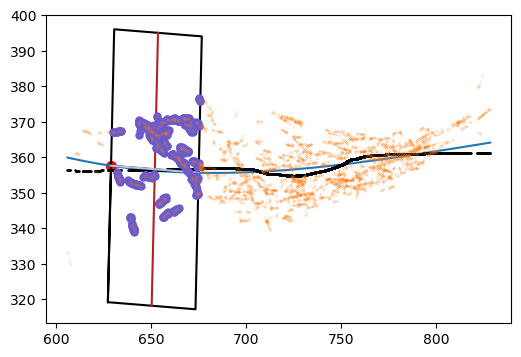

Window number 2
A and B: 
651.8343306511864 356.2396148276064 697.9780716703542 355.7428385124226


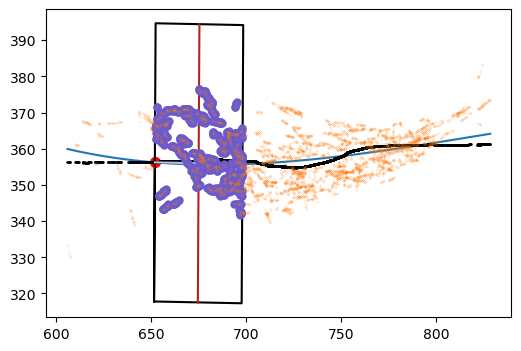

Window number 3
A and B: 
674.9062011607704 355.643232744322 721.0499421799382 356.4289121877625


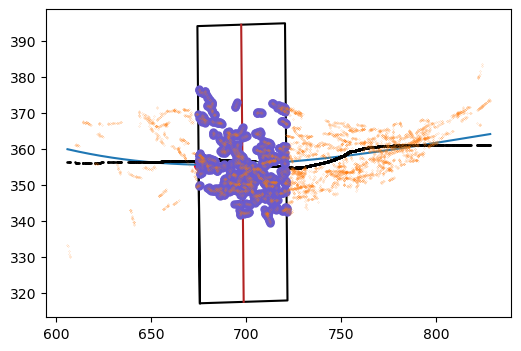

Window number 4
A and B: 
697.9780716703542 355.7428385124226 744.077272398963 357.58929939715404


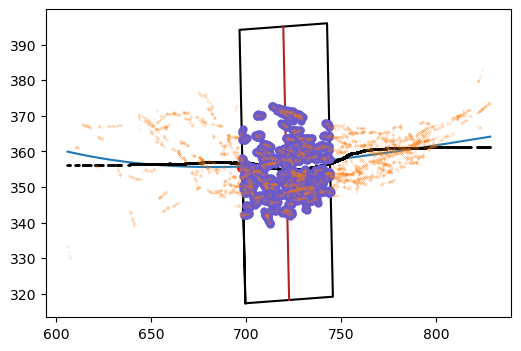

Window number 5
A and B: 
721.0499421799382 356.4289121877625 767.1046026179879 359.11590796676376


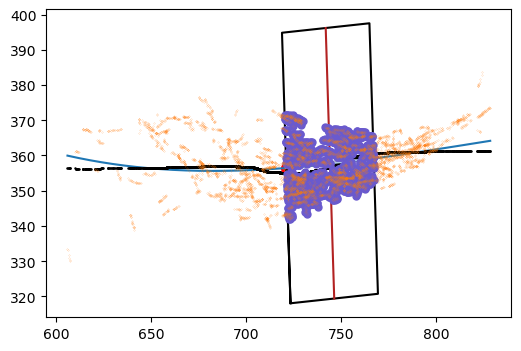

Window number 6
A and B: 
744.077272398963 357.58929939715404 790.0873925464538 360.89622205664125


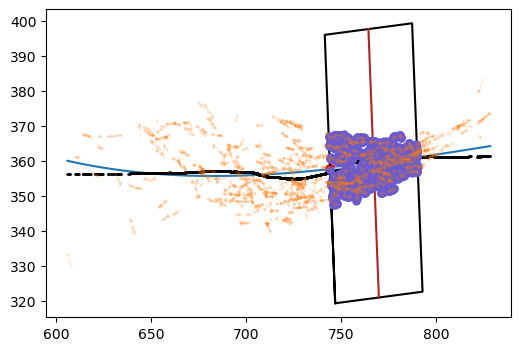

Window number 7
A and B: 
767.1046026179879 359.11590796676376 813.1147227654786 362.82843066941473


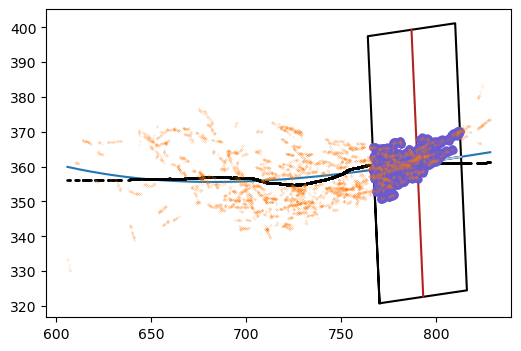

Window number 8
A and B: 
790.0873925464538 360.89622205664125 828.4811230083483 364.14665812959186


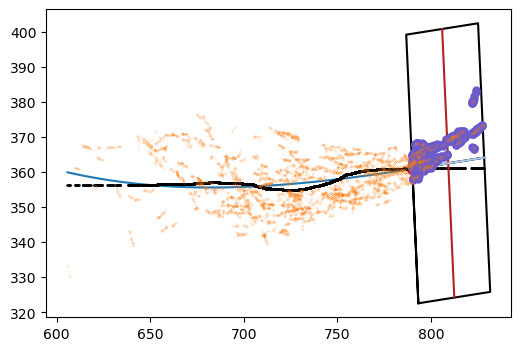

Neurite 2/3


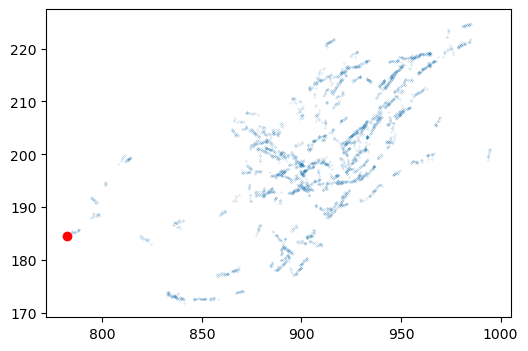

ANGLE
6.352296085450792


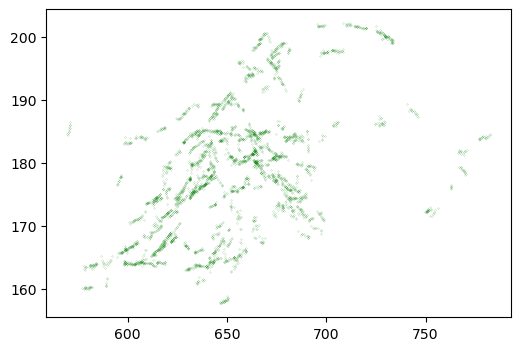

REVERSE
Window number 0
A and B: 
782.56 178.4292860157004 736.7053253260369 183.17591228715727


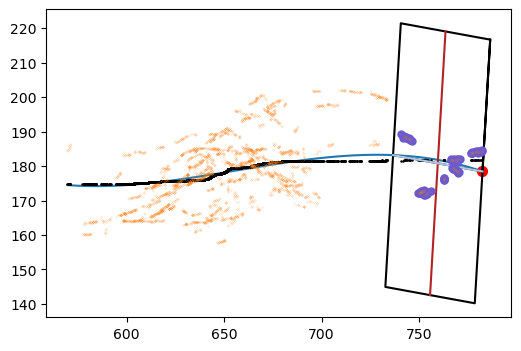

Window number 1
A and B: 
759.7391034120294 181.78478848555568 713.6289709404398 183.00612590530045


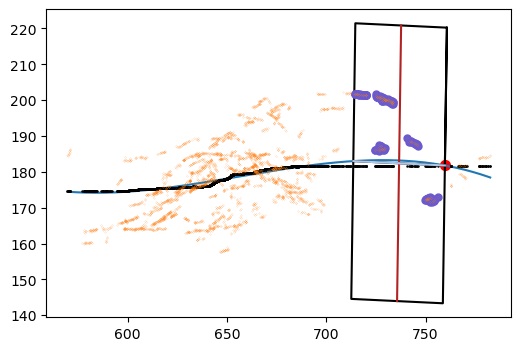

Window number 2
A and B: 
736.7053253260369 183.17591228715727 690.5951928544473 181.72363493963928


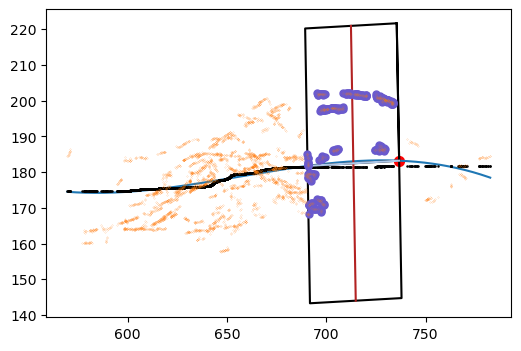

Window number 3
A and B: 
713.6289709404398 183.00612590530045 667.603991068059 179.78025784580097


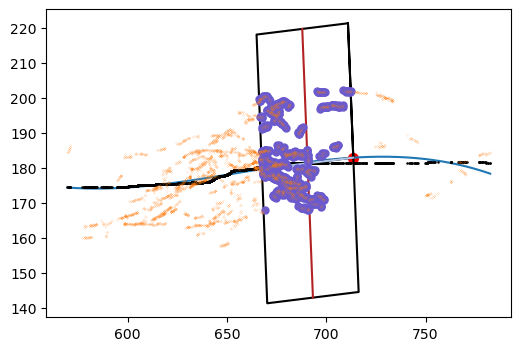

Window number 4
A and B: 
690.5951928544473 181.72363493963928 644.6127892816709 177.6189288187794


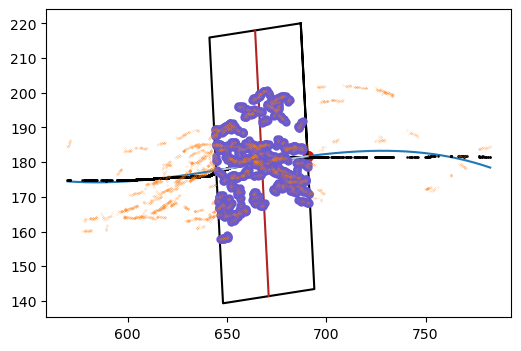

Window number 5
A and B: 
667.603991068059 179.78025784580097 621.6215874952827 175.68406475694744


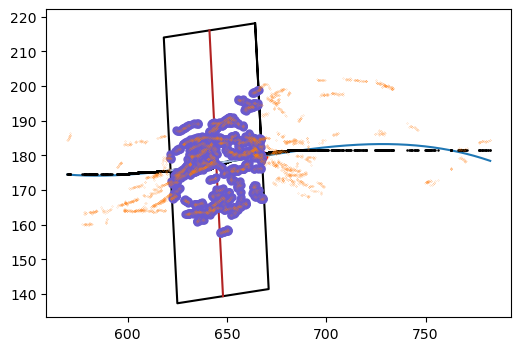

Window number 6
A and B: 
644.6127892816709 177.6189288187794 598.5878094092901 174.41863928208105


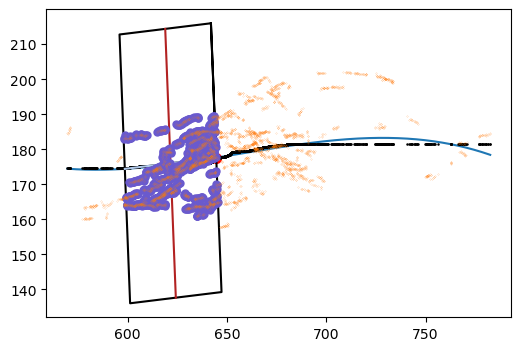

Window number 7
A and B: 
621.6215874952827 175.68406475694744 575.5114550236931 174.2745182320126


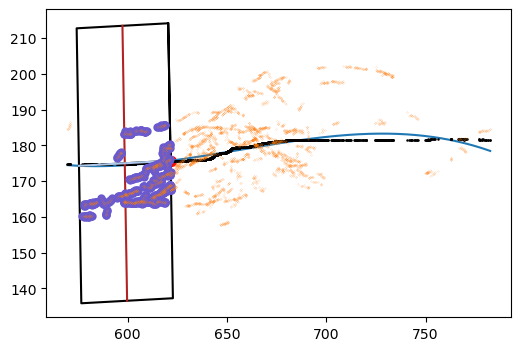

Window number 8
A and B: 
598.5878094092901 174.41863928208105 569.7210782774916 174.46773760853443


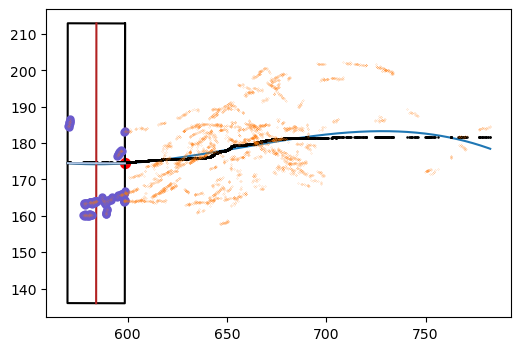

ALL DONE
Saving the data frame for DoM reconstruction
number of localisations toward soma 519
number of localisations away from soma 5415
Ratio in over total 0.09
Results_PLUSIN_w.csv
Results_PLUSOUT_w.csv
Saving the whole data frame


In [5]:
for DIVs in os.listdir(folder): #DIVs here used to iterate over folders and set median filter window sizes 
    div = re.search('DIV(\d)', DIVs).group(1)
    if DIVs == '2024-04-09_Motor_PAINT_Neurons_DIV1_Analysis':
        for ROIs in os.listdir(folder+'\\'+DIVs): 
            print(ROIs)
            if os.path.isdir(folder+'\\'+DIVs+'\\'+ROIs): 
                ROI = re.search('R\w{1,2}(\d)', ROIs).group(1)
                if ROI =='2': #these are movies acquired at a higher plane (focused on soma not neurites)
                    print('ROI 2: do nothing')
                else:   
                    datadir = folder + '\\' + DIVs + '\\' + ROIs 
                    print(datadir)
                    
                    #Load dataframe with neurite labels
                    #datadir should be on level of ROI - i.e. a subfolder with a name such as S02_C01_ROI1
                    neuron_mdf = pd.read_csv(datadir + '\\' + [a for a in os.listdir(datadir) if re.match(r'Data_frame_neurites_labelled_*',a)][0])
                    soma_coords = get_soma_coords(datadir = datadir)

                    Sample_ID = datadir+'_'+div +'_'+ROIs.split('_R', 1)[0]
                    #print(Sample_ID)
                    #get stage information
                    stage = find_stage(Sample_ID, stages_dict)
                    if stage == None:
                        print(f"Warning. No corresponding stage found for '{Sample_ID}'. Proceeding anyways.")
                        stage = -1
                    
                    neuron_mdf['DIV']  = div
                    neuron_mdf['Stage'] = stage
                    neuron_mdf['Cell'] = ROIs

                    if div == '0':
                        mfw = 2000
                    elif div == '1':
                        mfw = 4000
                    else: 
                        mfw = 6000

                    neuron_mdf_n = scan_neurites(neuron_mdf=neuron_mdf, soma_coords=soma_coords,\
                                                                 median_filt_window=mfw, window_size=3000,\
                                                                 pixelsize=65, angle_filtering_applied=True)
                    print('Saving the data frame for DoM reconstruction')
                    save_splitted_df_to_csv(neuron_mdf_n=neuron_mdf_n, og_cols=None) 
                    print('Saving the whole data frame')
                    neuron_mdf_n.to_csv(path_or_buf=datadir+'\\'+fr'DF_statitics_per_neurite.csv', index=False)

                    del neuron_mdf_n
                    del neuron_mdf
                    del soma_coords